### 1. Identifying multi-class recordings

In [1]:
import librosa
import librosa.display
import os
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import random
import keras
import datetime as dt
import time
import cv2
from keras import layers
from keras import models
from tensorflow.keras import optimizers

from keras.layers import *
from keras.models import *
from keras import initializers, regularizers, constraints
from keras.layers.normalization import BatchNormalization 
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, precision_recall_fscore_support
from tensorflow.keras import backend as K

from ABNmodules_multiclass import *
from sklearn.metrics import f1_score

import pandas as pd
import matplotlib as mpl
import seaborn as sns


tf.set_random_seed(1004)
random.seed(1004)

os.environ["CUDA_VISIBLE_DEVICES"]="1"
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
session = tf.Session(config=config)


/usr/local/lib/python3.6/dist-packages/numba/errors.py:137: UserWarning: Insufficiently recent colorama version found. Numba requires colorama >= 0.3.9
  warnings.warn(msg)
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)typ

In [2]:

def score_f1(y_true, y_pred): #taken from old keras source code
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

def dot_product(x, kernel):
    if K.backend() == 'tensorflow':
        return K.squeeze(K.dot(x, K.expand_dims(kernel)), axis=-1)
    else:
        return K.dot(x, kernel)
    
def get_unique_classes(input_directory,files):

    unique_classes=set()
    for f in files:
        g = f.replace('.mat','.hea')
        input_file = os.path.join(input_directory,g)
        with open(input_file,'r') as f:
            for lines in f:
                if lines.startswith('#Dx'):
                    tmp = lines.split(': ')[1].split(',')
                    for c in tmp:
                        unique_classes.add(c.strip())
    return sorted(unique_classes)

def one_hot_encoding(one_hot_vector,y, class2index):
    ind=class2index[y]
    one_hot_vector[ind]=1
    return one_hot_vector

# Search for multi-label subjects
def searching_overlap(input_directory,class2index, input_file_names):
    multiclasses=[]
    multisubjects=[]
    number = []
    for file in input_file_names:
        f=file
        g = f.replace('.mat','.hea')
        input_file = os.path.join(input_directory,g)
        with open(input_file,'r') as f:
            for lines in f:
                if lines.startswith('#Dx'):
                    tmp = lines.split(': ')[1].split(',')
                    if len(tmp)>1:
                        one_hot_vector = [0]*(len(class2index))
                        for c in tmp:
                            one_hot_vector = one_hot_encoding(one_hot_vector, c.strip(), class2index)
                        multiclasses.append(one_hot_vector)
                        multisubjects.append(g)
                        number.append(len(tmp))
    return multisubjects, multiclasses, number

def block_feature(sequence_en, minimum_len): 
    new_en = []
    if len(sequence_en) > minimum_len:  # 길이가 minimum보다 긴 경우
        start = random.randint(0,len(sequence_en)-minimum_len)
        #print(start)
        new_en = sequence_en[start:start+minimum_len]
    elif len(sequence_en) == minimum_len: # 길이가 minimum
        new_en = sequence_en
    else: 
        assert len(sequence_en) <= minimum_len
    return new_en

def exploratory_look(input_directory,file, class2index):
    classes = []
    f = file
    g = f.replace('.mat','.hea')
    input_file = os.path.join(input_directory,g)
    with open(input_file,'r') as f:
        for lines in f:
            if lines.startswith('#Dx'):
                tmp = lines.split(': ')[1].split(',')
                print(tmp, len(tmp))
    return tmp     

# Get classes of sorted file names
def get_labels(input_directory,file, class2index):
    f = file
    g = f.replace('.mat','.hea')
    input_file = os.path.join(input_directory,g)
    with open(input_file,'r') as f:
        for lines in f:
            if lines.startswith('#Dx'):
                tmp = lines.split(': ')[1].split(',')
                one_hot_vector = [0]*(len(class2index))
                for c in tmp:
                    one_hot_vector = one_hot_encoding(one_hot_vector, c.strip(), class2index)
                
    return one_hot_vector

def randextract_mels(curr_step, batch_size, data, mel_directory, class2index, minimum_len, x_mean_final, x_std_final):
    mel_files = []
    classes = []
    start = batch_size*curr_step
    end = batch_size*(curr_step+1)
    curr_file_indices = data[start:end]
    for file in curr_file_indices:
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        clip_file = block_feature(tmp_file, minimum_len)
        clip_file -= x_mean_final
        clip_file /= x_std_final
        mel_files.append(clip_file)
        label = get_labels(input_directory, file, class2index)
        classes.append(label)
    
    concat = list(zip(mel_files, classes))
    random.shuffle(concat)
    mel_files, classes = zip(*concat)
    return mel_files, classes

def zeropadding_mels(curr_step, batch_size, data, mel_directory, class2index, minimum_len, x_mean_final, x_std_final):
    mel_files = []
    classes = []
    start = batch_size*curr_step
    end = batch_size*(curr_step+1)
    curr_file_indices = data[start:end]    
    for file in curr_file_indices:
        
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        tmp_file -= x_mean_final
        tmp_file /= x_std_final        
#         print(tmp_file.shape)
        zero_padding = np.zeros((minimum_len-len(tmp_file), 12))
#         print(zero_padding.shape)
        clip_file = np.concatenate((zero_padding, tmp_file), axis=0)
#         print(clip_file)
#         clip_file = zero_padding + tmp_file
#         print(clip_file.shape)
#         clip_file = block_feature(tmp_file, minimum_len)
        #print(clip_file.shape)
        #clip_file = tmp_file[:minimum_len]

        mel_files.append(clip_file)
        label = get_labels(input_directory, file, class2index)
        classes.append(label)
    concat = list(zip(mel_files, classes))
    random.shuffle(concat)
    mel_files, classes = zip(*concat)
    return mel_files, classes  

def train(data_train, mel_directory, batch_size, class2index, minimum_len, x_mean_final, x_std_final, model): 
    loss=[]
#     acc = []
    f1 = []

    total_steps = int(np.ceil(len(data_train)/batch_size))
    for curr_step in range(total_steps): # loops over batches
#         batch_mels, batch_labels = randextract_mels(curr_step, batch_size, data_train, mel_directory, class2index, minimum_len, x_mean_final, x_std_final)
        batch_mels, batch_labels = zeropadding_mels(curr_step, batch_size, data_train, mel_directory, class2index, minimum_len, x_mean_final, x_std_final)
        batch_mels = np.asarray(batch_mels)
        batch_labels = np.asarray(np.squeeze(batch_labels))
        
        batch_labels = [batch_labels, batch_labels]


# return of train
# 0 = total loss (attention branch + perception branch)
# 1 = loss of attention pred
# 2 = loss of perception pred
# 3 = f1 of attention pred
# 4 = f1 of perception pred     


        train_tmp = model.train_on_batch(batch_mels, batch_labels)
        loss_ = train_tmp[0]/2
        f1_ = np.mean((train_tmp[3], train_tmp[4]))
        loss.append(loss_)
        f1.append(f1_)

    loss = np.mean(np.array(loss))
    f1 = np.mean(np.array(f1))
    return loss, f1

def train_edit(data_train, mel_directory, batch_size, class2index, minimum_len, x_mean_final, x_std_final, model): 
    loss=[]
#     acc = []
    f1 = []

    total_steps = int(np.ceil(len(data_train)/batch_size))
    for curr_step in range(total_steps): # loops over batches
        batch_mels, batch_labels = randextract_mels(curr_step, batch_size, data_train, mel_directory, class2index, minimum_len, x_mean_final, x_std_final)

        batch_mels = np.asarray(batch_mels)
        batch_labels = np.asarray(np.squeeze(batch_labels))


        heatmap = CAM_conv1D(minimum_len, n_channels, batch_mels, batch_labels, out_len, get_conv_out)        
        heatmap = np.asarray(heatmap)
        
        batch_labels = [batch_labels, batch_labels]


# return of train
# 0 = total loss (attention branch + perception branch)
# 1 = loss of attention pred
# 2 = loss of perception pred
# 3 = f1 of attention pred
# 4 = f1 of perception pred     

        train_tmp = model.train_on_batch([batch_mels, heatmap], batch_labels)
        loss_ = train_tmp[0]/2
        f1_ = np.mean((train_tmp[3], train_tmp[4]))
        loss.append(loss_)
        f1.append(f1_)

    loss = np.mean(np.array(loss))
    f1 = np.mean(np.array(f1))
    return loss, f1

def test(data, mel_directory, input_directory, class2index, minimum_len, model, x_mean_final, x_std_final):
    scores = []
    predicted_labels=[]
    accuracy=np.zeros(len(data))
    total_acc = 0
    total_f1 = 0
    
    y_true = []
    y_pred=[]
    
    mel_files = []
    classes = []
    
    multi_files, _, _ = searching_overlap(input_directory,class2index, data)
    multi_acc = 0
    multi_y_true=[]
    multi_y_pred=[]    
    single_acc = 0
    single_y_true=[]
    single_y_pred=[]     
    
    for file in data:
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        steps = int(np.floor(tmp_file.shape[0]/minimum_len))
        mel_files = []
        heatmap_files=[]
        label = get_labels(input_directory, file, class2index)
        label = [label]
        for block in range(steps): # 128개씩 쪼갠 블럭 단위로 predict
            start = block*minimum_len
            end = (block+1)*minimum_len
            clip_file = tmp_file[start:end]
            clip_file -= x_mean_final
            clip_file /= x_std_final
            clip_file = clip_file.reshape(1,minimum_len,n_channels)
            mel_files.append(clip_file)    
        mel_files = np.asarray(mel_files)
        mel_files = mel_files.reshape(steps,minimum_len,n_channels)
        logit = model.predict(mel_files)
        logit = np.mean(logit, axis=0)
        logit = np.mean(logit, axis=0)
        pred = np.zeros(len(logit))
        for ii, label in enumerate(logit):
            if label >= 0.5:
                pred[ii] = 1
            else:
                pred[ii] = 0
        pred = pred.tolist()
        y_pred.append(pred)
        label = get_labels(input_directory,file,class2index)
        y_true.append(label)
        if pred == label:
            acc = 1
        else:
            acc = 0
        total_acc += acc
        if file.replace('.mat', '.hea') in multi_files:
            multi_y_true.append(label)            
            multi_y_pred.append(pred)
            multi_acc += acc
        else: # for calculating single_label accuracy
            single_y_true.append(label)            
            single_y_pred.append(pred)
            single_acc += acc            
        
    final_acc = total_acc / len(data)
    f1_classes = f1_score(y_true, y_pred, average=None)
    f1_micro = f1_score(y_true, y_pred, average='micro')
    
    multi_final_acc = multi_acc / len(multi_files)
    multi_f1_classes = f1_score(multi_y_true, multi_y_pred, average=None)
    multi_f1_micro = f1_score(multi_y_true, multi_y_pred, average='micro')

    single_final_acc = single_acc / (len (data) - len(multi_files))
    single_f1_classes = f1_score(single_y_true, single_y_pred, average=None)
    single_f1_micro = f1_score(single_y_true, single_y_pred, average='micro')    
    
    return final_acc, f1_classes, f1_micro, multi_final_acc, multi_f1_classes, multi_f1_micro, single_final_acc, single_f1_classes, single_f1_micro

def test_zero(data, mel_directory, input_directory, class2index, minimum_len, model, x_mean_final, x_std_final):
    scores = []
    predicted_labels=[]
    accuracy=np.zeros(len(data))
    #total_loss=[]
    total_acc = 0
    total_f1 = 0
    y_true = []
    y_pred=[]    
    mel_files = []
    classes = []
    
    
    multi_files, _, _ = searching_overlap(input_directory,class2index, data)
    multi_acc = 0
    multi_y_true=[]
    multi_y_pred=[]    
    single_acc = 0
    single_y_true=[]
    single_y_pred=[]  
    for file in data:
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        tmp_file -= x_mean_final
        tmp_file /= x_std_final
        steps = int(np.floor(tmp_file.shape[0]/minimum_len))
        mel_files = []
#         for block in range(steps): # 128개씩 쪼갠 블럭 단위로 predict
            
        zero_padding = np.zeros((minimum_len-len(tmp_file), 12))
        clip_file = np.concatenate((zero_padding, tmp_file), axis=0)
#         print(clip_file.shape)
        

        mel_files.append(clip_file)
        mel_files = np.asarray(mel_files)
        logit = model.predict(mel_files)
        logit = np.mean(logit, axis=0)
        logit = np.mean(logit, axis=0)        
        
        
        pred = np.zeros(len(logit))
        for ii, label in enumerate(logit):
            if label >= 0.5:
                pred[ii] = 1
            else:
                pred[ii] = 0
        pred = pred.tolist()
        y_pred.append(pred)        
        label = get_labels(input_directory,file,class2index)
        y_true.append(label)
        
        if pred == label:
            acc = 1
        else:
            acc = 0
        total_acc += acc
        if file.replace('.mat', '.hea') in multi_files:
            multi_y_true.append(label)            
            multi_y_pred.append(pred)
            multi_acc += acc         
        else: # for calculating single_label accuracy
            single_y_true.append(label)            
            single_y_pred.append(pred)
            single_acc += acc         
        #total_f1 += f1
    final_acc = total_acc / len(data)
    f1_classes = f1_score(y_true, y_pred, average=None)
    f1_micro = f1_score(y_true, y_pred, average='micro')
    
    multi_final_acc = multi_acc / len(multi_files)
    multi_f1_classes = f1_score(multi_y_true, multi_y_pred, average=None)
    multi_f1_micro = f1_score(multi_y_true, multi_y_pred, average='micro')
    
    single_final_acc = single_acc / (len (data) - len(multi_files))
    single_f1_classes = f1_score(single_y_true, single_y_pred, average=None)
    single_f1_micro = f1_score(single_y_true, single_y_pred, average='micro')    
    
    return final_acc, f1_classes, f1_micro, multi_final_acc, multi_f1_classes, multi_f1_micro, single_final_acc, single_f1_classes, single_f1_micro


def test_edit(data, mel_directory, input_directory, class2index, minimum_len, model, x_mean_final, x_std_final):
    scores = []
    predicted_labels=[]
    accuracy=np.zeros(len(data))
    #total_loss=[]
    total_acc = 0
    total_f1 = 0
    
    y_true = []
    y_pred = []
    
    mel_files = []
    classes = []
    
    multi_files, _, _ = searching_overlap(input_directory,class2index, data)
    multi_acc = 0
    multi_y_true=[]
    multi_y_pred=[]    
    
    for file in data:
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        steps = int(np.floor(tmp_file.shape[0]/minimum_len))
        mel_files = []
        heatmap_files=[]
        label = get_labels(input_directory, file, class2index)
        label = [label]
        for block in range(steps): # 128개씩 쪼갠 블럭 단위로 predict
            start = block*minimum_len
            end = (block+1)*minimum_len
            clip_file = tmp_file[start:end]
            clip_file -= x_mean_final
            clip_file /= x_std_final
            clip_file = clip_file.reshape(1,minimum_len,n_channels)
            heatmap = CAM_conv1D(minimum_len, n_channels, clip_file, label, out_len, get_conv_out)
            mel_files.append(clip_file)    
            heatmap_files.append(heatmap)
        mel_files = np.asarray(mel_files)
        heatmap_files = np.asarray(heatmap_files)
        heatmap_files = heatmap_files.reshape(steps, out_len,1)
        mel_files = mel_files.reshape(steps,minimum_len,n_channels)
        logit = model.predict([mel_files, heatmap_files])
        logit = np.mean(logit, axis=0)
        logit = np.mean(logit, axis=0)
        pred = np.zeros(len(logit))
        for ii, label in enumerate(logit):
            if label >= 0.5:
                pred[ii] = 1
            else:
                pred[ii] = 0
        pred = pred.tolist()
        y_pred.append(pred)
        label = get_labels(input_directory,file,class2index)
        y_true.append(label)
        if pred == label:
            acc = 1
        else:
            acc = 0
        total_acc += acc
        if file.replace('.mat', '.hea') in multi_files:
            multi_y_true.append(label)
            multi_y_pred.append(pred)
            multi_acc += acc               
    final_acc = total_acc / len(data)
    f1_classes = f1_score(y_true, y_pred, average=None)
    f1_micro = f1_score(y_true, y_pred, average='micro')
    
    multi_final_acc = multi_acc / len(multi_files)
    multi_f1_classes = f1_score(multi_y_true, multi_y_pred, average=None)
    multi_f1_micro = f1_score(multi_y_true, multi_y_pred, average='micro')
    
    return final_acc, f1_classes, f1_micro, multi_final_acc, multi_f1_classes, multi_f1_micro

def test_edit_final(data, mel_directory, input_directory, class2index, minimum_len, model, x_mean_final, x_std_final, p_model):
    scores = []
    predicted_labels=[]
    accuracy=np.zeros(len(data))
    #total_loss=[]
    total_acc = 0
    total_f1 = 0
    
    y_true = []
    y_pred=[]
    
    
    mel_files = []
    classes = []
    
    multi_files, _, _ = searching_overlap(input_directory,class2index, data)
    multi_acc = 0
    multi_y_true=[]
    multi_y_pred=[]
    
    for file in data:
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        steps = int(np.floor(tmp_file.shape[0]/minimum_len))
        mel_files = []
        mel_files_logit = []
        heatmap_files=[]

        for block in range(steps): # 128개씩 쪼갠 블럭 단위로 predict
            start = block*minimum_len
            end = (block+1)*minimum_len
            clip_file = tmp_file[start:end]
            clip_file -= x_mean_final
            clip_file /= x_std_final
            clip_file = clip_file.reshape(1,minimum_len,n_channels)
            
            # 여기서 logit으로 y구함#####################
            logit_ = p_model.predict(clip_file)
            logit_ = np.mean(logit_, axis=0)
            logit_ = np.mean(logit_, axis=0)
            pred_ = np.zeros(len(logit_))
            for ii, label in enumerate(logit_):
                if label >= 0.5: 
                    pred_[ii] = 1
                else:
                    pred_[ii] = 0
            pred_ = pred_.tolist()
            ##########################################
            
            heatmap = CAM_conv1D(minimum_len, n_channels, clip_file, [pred_], out_len, get_conv_out)
            mel_files.append(clip_file)    
            heatmap_files.append(heatmap)
        mel_files = np.asarray(mel_files)
        heatmap_files = np.asarray(heatmap_files)
        heatmap_files = heatmap_files.reshape(steps, out_len,1)
        mel_files = mel_files.reshape(steps,minimum_len,n_channels)
        logit = model.predict([mel_files, heatmap_files])
        logit = np.mean(logit, axis=0)
        logit = np.mean(logit, axis=0)
        pred = np.zeros(len(logit))
        for ii, label in enumerate(logit):
            if label >= 0.5:
                pred[ii] = 1
            else:
                pred[ii] = 0
        pred = pred.tolist()
        y_pred.append(pred)
        label = get_labels(input_directory,file,class2index)
        y_true.append(label)
        if pred == label:
            acc = 1
        else:
            acc = 0
        total_acc += acc
        if file.replace('.mat', '.hea') in multi_files:
            multi_y_true.append(label)          
            multi_y_pred.append(pred)
            multi_acc += acc       

    final_acc = total_acc / len(data)
    f1_classes = f1_score(y_true, y_pred, average=None)
    f1_micro = f1_score(y_true, y_pred, average='micro')
    
    multi_final_acc = multi_acc / len(multi_files)
    multi_f1_classes = f1_score(multi_y_true, multi_y_pred, average=None)
    multi_f1_micro = f1_score(multi_y_true, multi_y_pred, average='micro')
    
    return final_acc, f1_classes, f1_micro, multi_final_acc, multi_f1_classes, multi_f1_micro

def test_edit_final2(data, mel_directory, input_directory, class2index, minimum_len, model, x_mean_final, x_std_final, p_model):
    scores = []
    predicted_labels=[]
    accuracy=np.zeros(len(data))
    #total_loss=[]
    total_acc = 0
    total_f1 = 0
    
    mel_files = []
    classes = []
    
    y_true = []
    y_pred=[]    

    multi_files, _, _ = searching_overlap(input_directory,class2index, data)
    multi_acc = 0
    multi_y_true=[]
    multi_y_pred=[]    
    
    for file in data:
        tmp_file = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
        steps = int(np.floor(tmp_file.shape[0]/minimum_len))
        mel_files = []
        mel_files_logit = []
        heatmap_files=[]

        for block in range(steps):
            # 여기서 logit으로 y구함
            start = block*minimum_len
            end = (block+1)*minimum_len
            clip_file = tmp_file[start:end]
            clip_file -= x_mean_final
            clip_file /= x_std_final
            clip_file = clip_file.reshape(1,minimum_len,n_channels)
            mel_files_logit.append(clip_file)
            
        mel_files_logit = np.asarray(mel_files_logit)
        mel_files_logit = mel_files_logit.reshape(steps,minimum_len,n_channels)
        
        
        
        logit_ = p_model.predict(mel_files_logit)
        
        logit_ = np.mean(logit_, axis=0)
        logit_ = np.mean(logit_, axis=0)
#         print(logit_)
        pred_ = np.zeros(len(logit_))
        for ii, label in enumerate(logit_):
            if label >= 0.5: 
                pred_[ii] = 1
            else:
                pred_[ii] = 0
        
        pred_ = pred_.tolist()

#         print(pred_)
            #######
        
        
        for block in range(steps): # 128개씩 쪼갠 블럭 단위로 predict
            start = block*minimum_len
            end = (block+1)*minimum_len
            clip_file = tmp_file[start:end]
            clip_file -= x_mean_final
            clip_file /= x_std_final
            clip_file = clip_file.reshape(1,minimum_len,n_channels)

            heatmap = CAM_conv1D(minimum_len, n_channels, clip_file, [pred_], out_len, get_conv_out)
#             print(heatmap)
            mel_files.append(clip_file)    
            heatmap_files.append(heatmap)
        mel_files = np.asarray(mel_files)
        heatmap_files = np.asarray(heatmap_files)
        heatmap_files = heatmap_files.reshape(steps, out_len,1)
        mel_files = mel_files.reshape(steps,minimum_len,n_channels)
        logit = model.predict([mel_files, heatmap_files])
        logit = np.mean(logit, axis=0)
        logit = np.mean(logit, axis=0)
        pred = np.zeros(len(logit))
       

        for ii, label in enumerate(logit):
            if label >= 0.5:
                pred[ii] = 1
            else:
                pred[ii] = 0
        pred = pred.tolist()
        y_pred.append(pred)
#         print(pred)
        label = get_labels(input_directory,file,class2index)
        y_true.append(label)
#         print(label)
        if pred == label:
            acc = 1
        else:
            acc = 0
        total_acc += acc
        if file.replace('.mat', '.hea') in multi_files:
            multi_y_true.append(label)
            multi_y_pred.append(pred)
            multi_acc += acc       

    final_acc = total_acc / len(data)
    f1_classes = f1_score(y_true, y_pred, average=None)
    f1_micro = f1_score(y_true, y_pred, average='micro')
    
    multi_final_acc = multi_acc / len(multi_files)
    multi_f1_classes = f1_score(multi_y_true, multi_y_pred, average=None)
    multi_f1_micro = f1_score(multi_y_true, multi_y_pred, average='micro')
    
    return final_acc, f1_classes, f1_micro, multi_final_acc, multi_f1_classes, multi_f1_micro

batch_size = 32
minimum_len = 72000 #2880
epochs = 1000#300#1000
n_channels=12
loss_function = 'binary_crossentropy' 
rootdir = '../'
date = dt.datetime.today().strftime("%Y%m%d")
input_directory = os.path.join(rootdir, 'Training_WFDB')
mel_name = 'Raw_data_20200424' 
mel_directory = os.path.join(rootdir, mel_name)
# results_directory = os.path.join(rootdir, 'results_'+date+'_0_IEEE_n=1')
# results_directory = os.path.join(rootdir, 'results_'+date+'_editting_CAM_multiclass')

if not os.path.isdir(input_directory):
    os.mkdir(input_directory)
if not os.path.isdir(mel_directory):
    os.mkdir(mel_directory)

        
input_files = []
for f in os.listdir(input_directory):
    if os.path.isfile(os.path.join(input_directory, f)) and not f.lower().startswith('.') and f.lower().endswith('mat'):
        input_files.append(f)
input_file_names = sorted(input_files)

unique_classes = get_unique_classes(input_directory, input_files)
class2index = {}
for a, b in enumerate(unique_classes):
    class2index[b] = a

np.shape(input_file_names)

x_mean_all = []
x_std_all = []
for file in input_file_names:
    x = np.load(mel_directory + '/' + file.replace('.mat', '.npy'))
    x_mean = [np.mean(x[:,0]), np.mean(x[:,1]), np.mean(x[:,2]), np.mean(x[:,3]), np.mean(x[:,4]), np.mean(x[:,5]),
             np.mean(x[:,6]), np.mean(x[:,7]), np.mean(x[:,8]), np.mean(x[:,9]), np.mean(x[:,10]), np.mean(x[:,11])]
    
    x_std = [np.std(x[:,0]), np.std(x[:,1]), np.std(x[:,2]), np.std(x[:,3]), np.std(x[:,4]), np.std(x[:,5]),
             np.std(x[:,6]), np.std(x[:,7]), np.std(x[:,8]), np.std(x[:,9]), np.std(x[:,10]), np.std(x[:,11])]
    x_mean_all.append(x_mean)
    x_std_all.append(x_std) # yjs corrected on 2020-05-25
x_mean_final = np.mean(x_mean_all, axis=0)
x_std_final = np.mean(x_std_all, axis=0)


data, data_test = train_test_split(input_file_names, test_size = 0.2, train_size = 0.8, shuffle=True, random_state=1004)
data_train, data_val = train_test_split(data, test_size = 0.05, train_size = 0.95, shuffle=True, random_state=1004)
print(np.shape(data_train), np.shape(data_val), np.shape(data_test))

main_input = Input(shape=(minimum_len,12), dtype='float32', name='main_input')

(5225,) (276,) (1376,)


In [3]:
multi_train, _, _ = searching_overlap(input_directory, class2index, data_train)
multi_val, _, _ = searching_overlap(input_directory, class2index, data_val)
multi_test, _, _ = searching_overlap(input_directory, class2index, data_test)

In [4]:
len(multi_test)

91

In [5]:
multi_test

['A1654.hea',
 'A4223.hea',
 'A6232.hea',
 'A5215.hea',
 'A1870.hea',
 'A0661.hea',
 'A4308.hea',
 'A6174.hea',
 'A4501.hea',
 'A5095.hea',
 'A3620.hea',
 'A2330.hea',
 'A4898.hea',
 'A4964.hea',
 'A5129.hea',
 'A2374.hea',
 'A5801.hea',
 'A3262.hea',
 'A2069.hea',
 'A0308.hea',
 'A5643.hea',
 'A5781.hea',
 'A0910.hea',
 'A1340.hea',
 'A0563.hea',
 'A1047.hea',
 'A2027.hea',
 'A1505.hea',
 'A1408.hea',
 'A4475.hea',
 'A1118.hea',
 'A4673.hea',
 'A1164.hea',
 'A4815.hea',
 'A6038.hea',
 'A5590.hea',
 'A1562.hea',
 'A5060.hea',
 'A2602.hea',
 'A3089.hea',
 'A0218.hea',
 'A5969.hea',
 'A2898.hea',
 'A2278.hea',
 'A0152.hea',
 'A2795.hea',
 'A6296.hea',
 'A6790.hea',
 'A6302.hea',
 'A0109.hea',
 'A2107.hea',
 'A4993.hea',
 'A5724.hea',
 'A2436.hea',
 'A5576.hea',
 'A4359.hea',
 'A5971.hea',
 'A6817.hea',
 'A2935.hea',
 'A4075.hea',
 'A6834.hea',
 'A5799.hea',
 'A5760.hea',
 'A4652.hea',
 'A3761.hea',
 'A3299.hea',
 'A4178.hea',
 'A3205.hea',
 'A5489.hea',
 'A4344.hea',
 'A5190.hea',
 'A571

In [6]:
gamma = 0.001
results_directory = os.path.join(rootdir, 'results_2020072X_e2e_ABN_zero_gamma' + str(gamma))
test_model,_ = endtoend_edit_ABN_model_loss((None,12), len(unique_classes), minimum_len,n=1, gamma = gamma)  
latest_test = tf.train.latest_checkpoint(results_directory)
test_model.load_weights(latest_test)    
# test_acc, f1_classes, f1,m_acc, m_f1, m_sum, s_acc, s_f1, s_sum = test_zero(data_val, mel_directory, input_directory, class2index, minimum_len, test_model, x_mean_final, x_std_final)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [7]:
attention_layer = 'attention_branch_att_sigmoid_1'
ideal_layer = 'attention_branch_conv_1'
get_att_out = K.function(test_model.input, [test_model.get_layer(attention_layer).output, 
                                            test_model.get_layer(ideal_layer).output, 
                                            test_model.output])
# att_out = get_att_out(preprocessed_input)

### Attention map

In [ ]:
cmap = plt.get_cmap('plasma')

(14000, 12)
(14000,)


NameError: name 'pd' is not defined

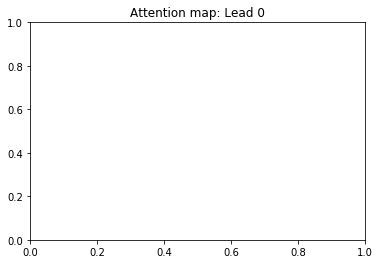

In [14]:
for i, mf in enumerate(multi_test):
#     mf = multi_test[88]
    tmp_file_ = np.load(mel_directory + '/' + mf.replace('.hea', '.npy'))



    tmp_file_ -= x_mean_final
    tmp_file_ /= x_std_final
    print(tmp_file_.shape)
    zero_padding = np.zeros((minimum_len-len(tmp_file_), 12))
    tmp_file = np.concatenate((zero_padding, tmp_file_), axis=0)

    label = get_labels(input_directory, mf, class2index)

    preprocessed_input = np.expand_dims(tmp_file, axis=0)#np.reshape(preprocessed_input, (1,minimum_len,12))

    att_out, ideal, prediction = get_att_out(preprocessed_input)
    #     print(att_out.shape)
    # att_out2 = cv2.resize(att_out[0], (minimum_len, 1))


    att = cv2.resize(att_out[0], dsize=(1, 72000))
    trimmed = att[72000-len(tmp_file_):,0]

    x_mean = np.mean(trimmed)
    x_std = np.std(trimmed)

    trimmed2 = trimmed - x_mean
    trimmed2 = trimmed2 / x_std

    trimmed3 = trimmed2*4
    print(trimmed3.shape)
    for i in range(12):
        plt.figure(i)
        plt.title("Attention map: Lead " + str(i))
        
        df = pd.DataFrame([tmp_file_[:,i], trimmed3 ])
        df = df.transpose()
        
#         print(mf)
#         print(label)
#         print(class2index)
#         plt.figure(i,figsize=(30, 10.5))
#         plt.plot(trimmed3)
#         plt.plot(tmp_file_[:,0])
#         plt.show()

### Ideal map 

A1654.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


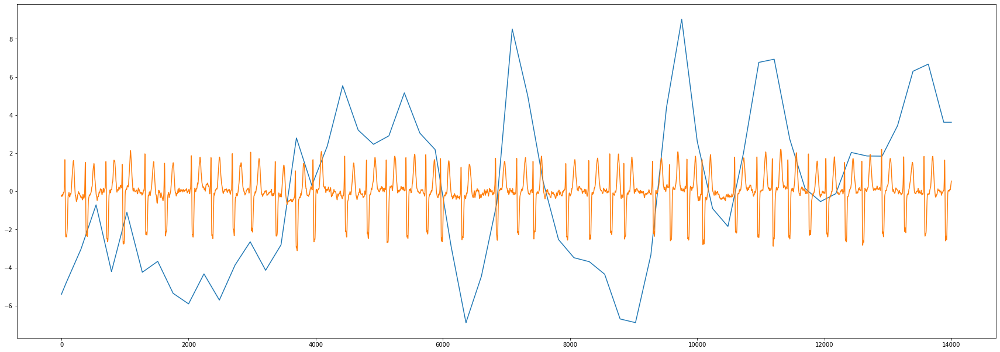

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


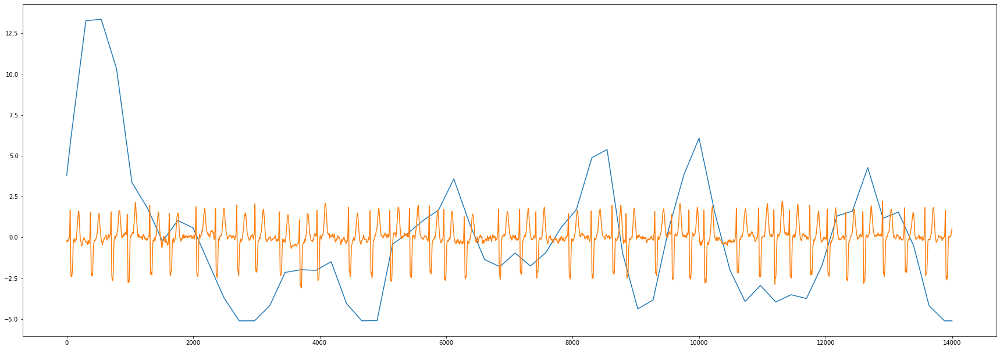

A4223.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


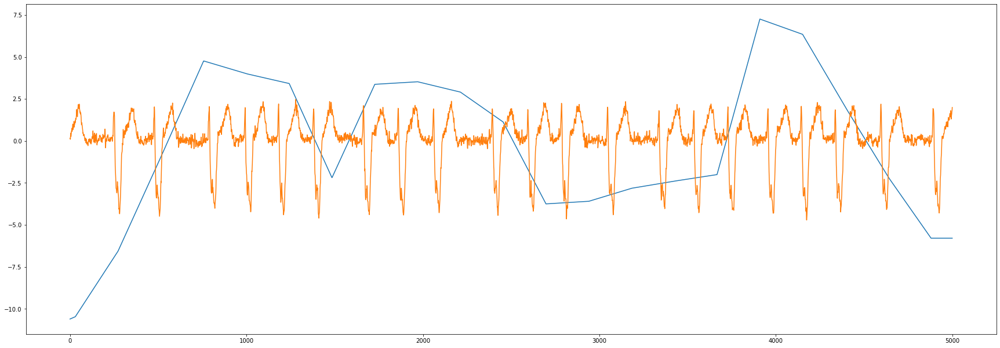

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


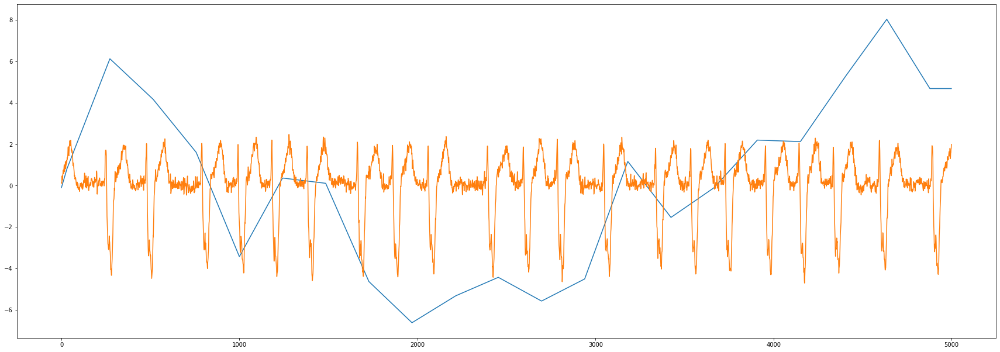

A6232.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:35: RuntimeWarning: invalid value encountered in true_divide


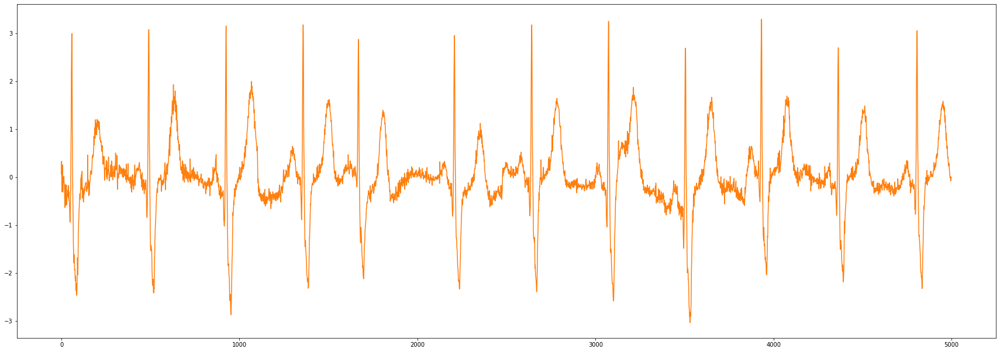

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


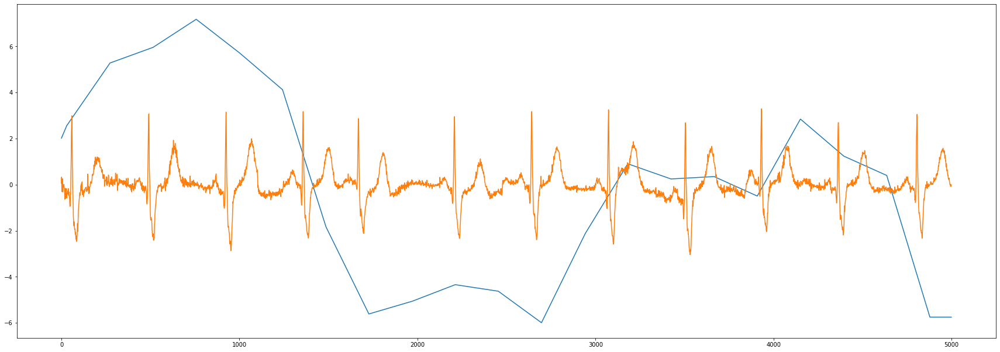

A5215.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


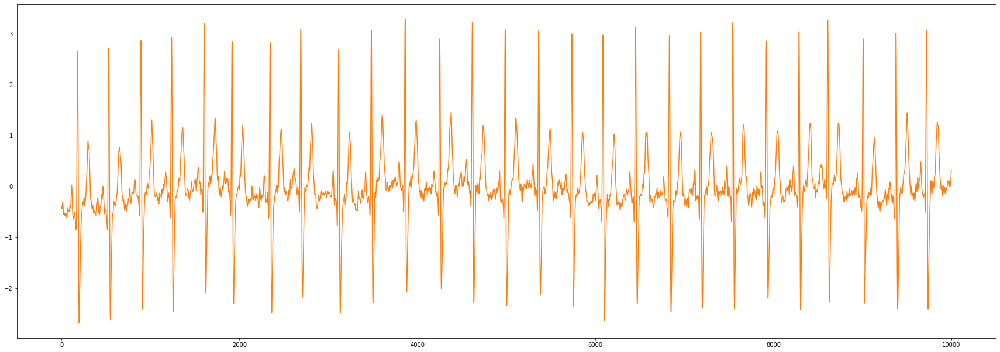

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


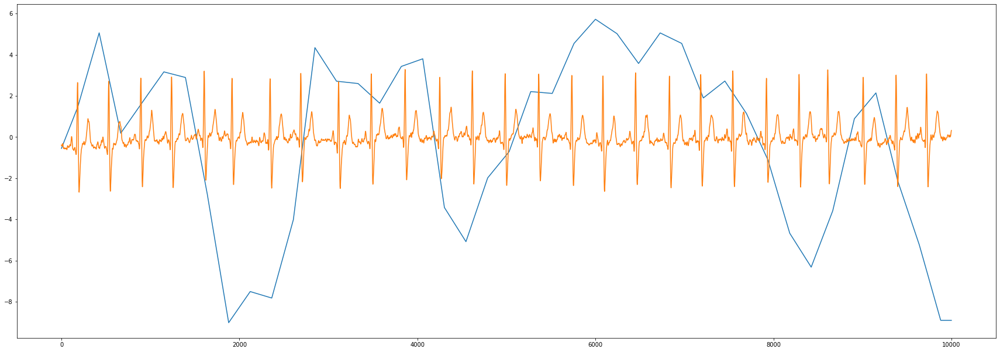

A1870.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


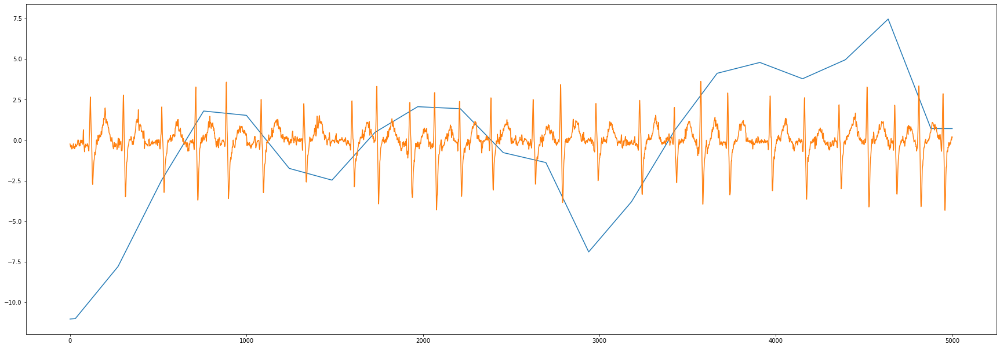

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


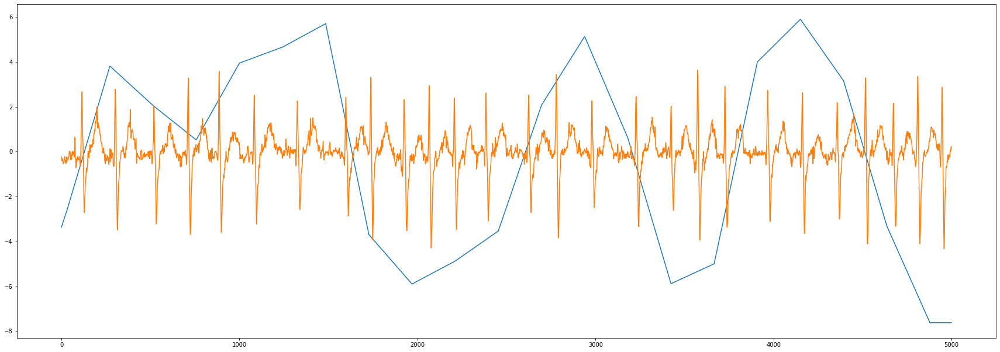

A0661.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


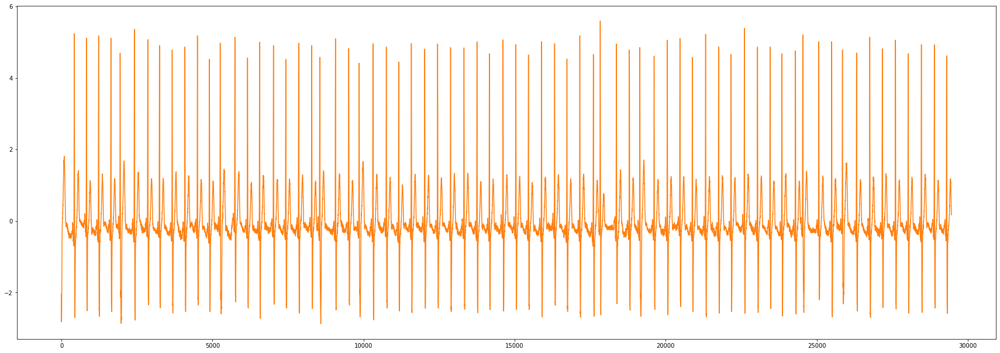

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


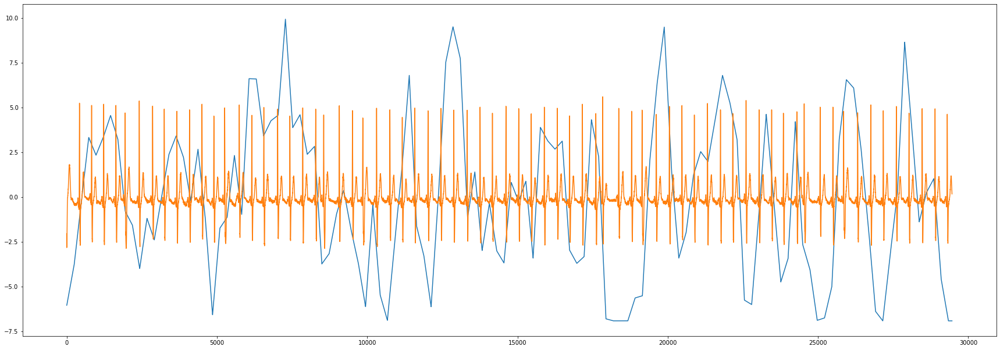

A4308.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


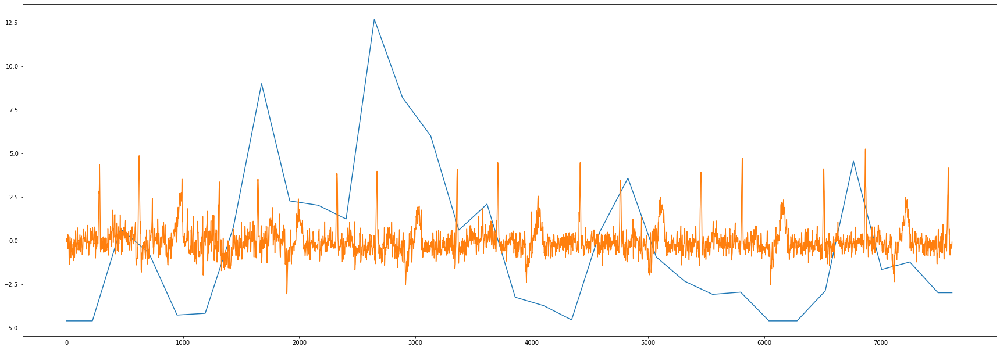

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


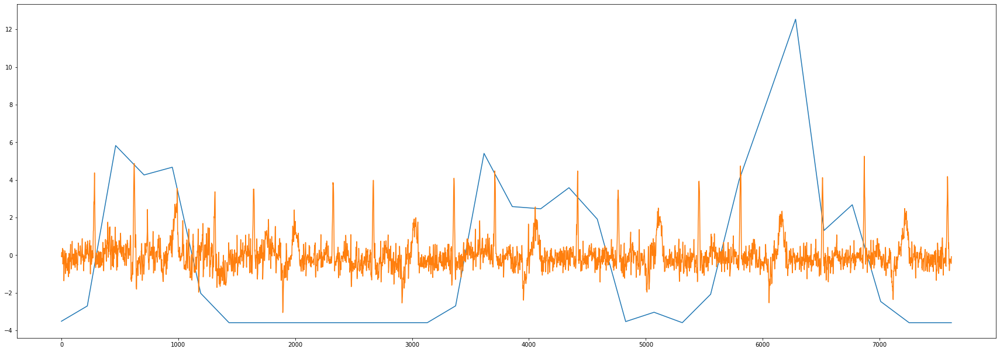

A6174.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


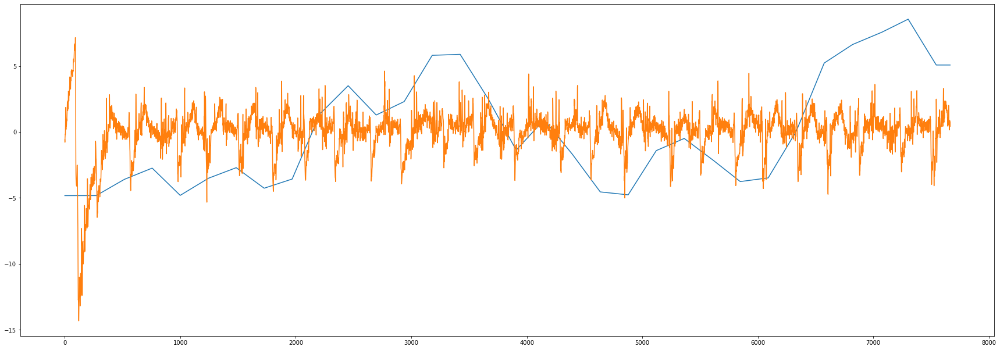

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


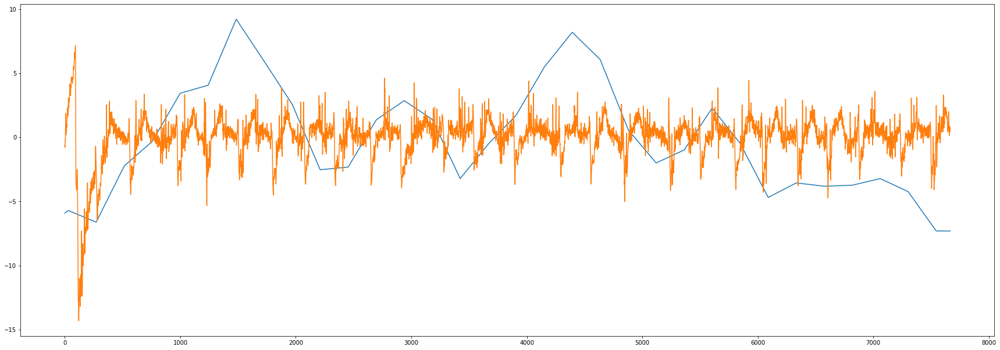

A4501.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


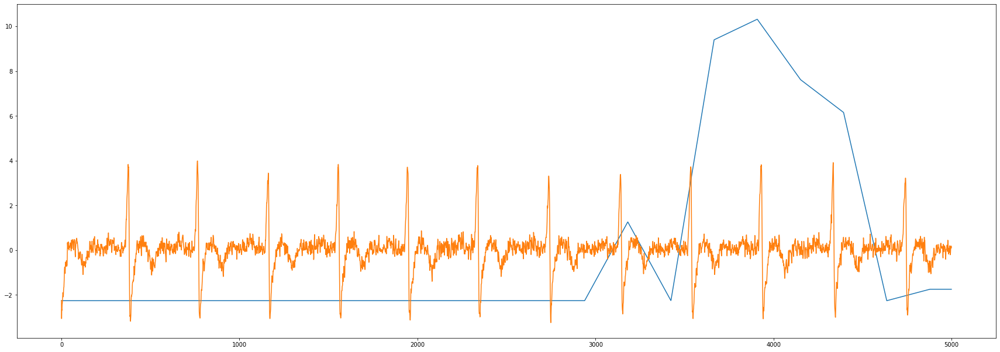

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


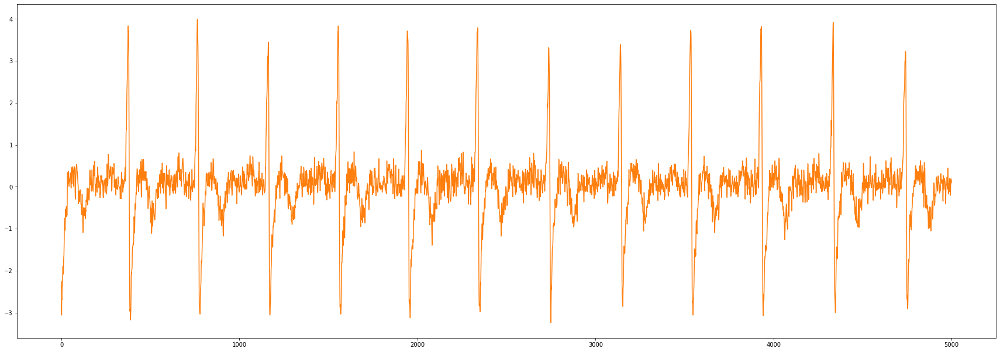

A5095.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


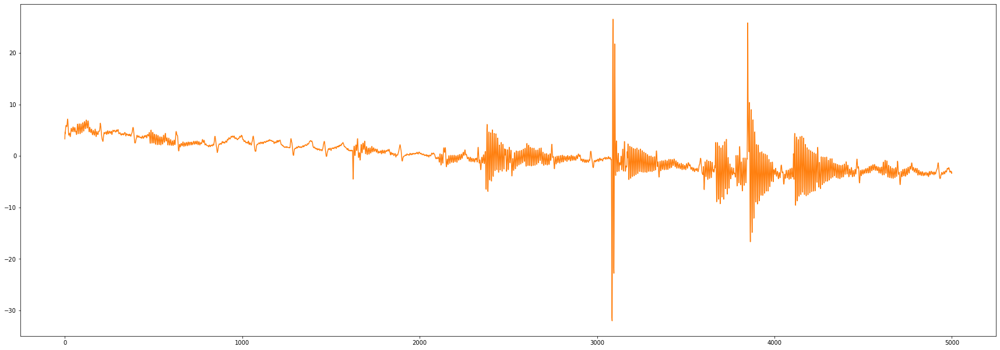

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


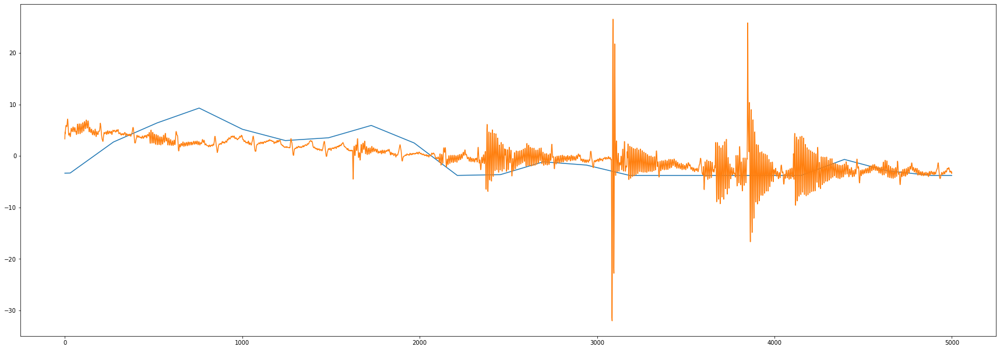

A3620.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


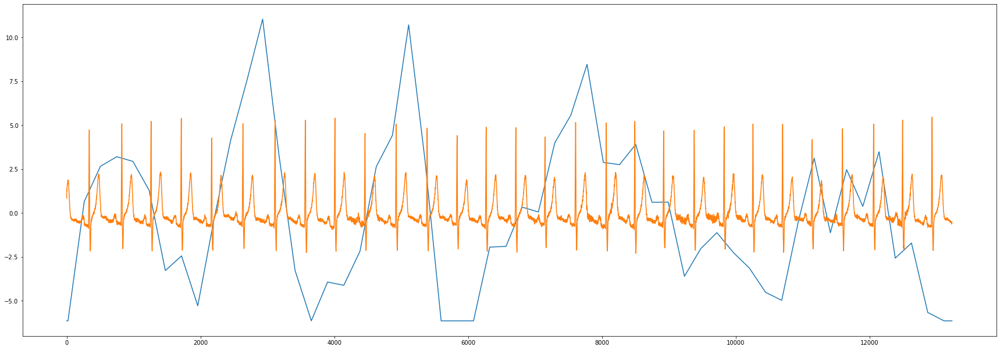

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


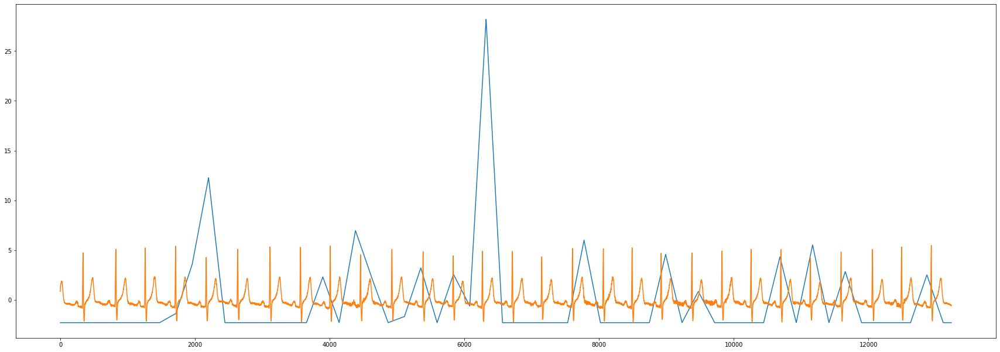

A2330.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


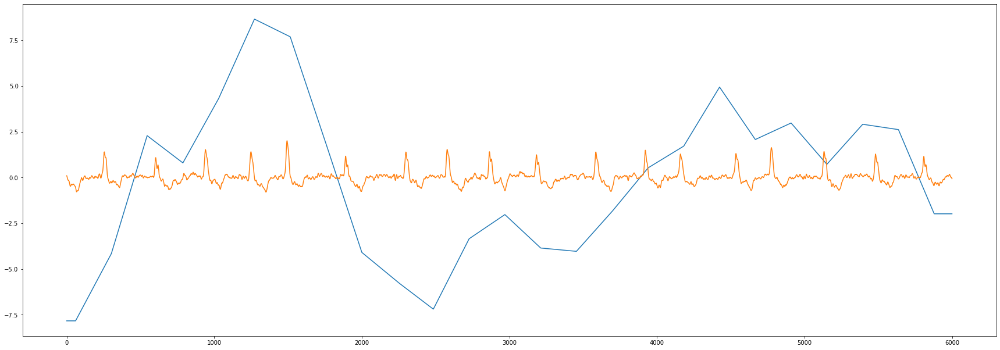

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


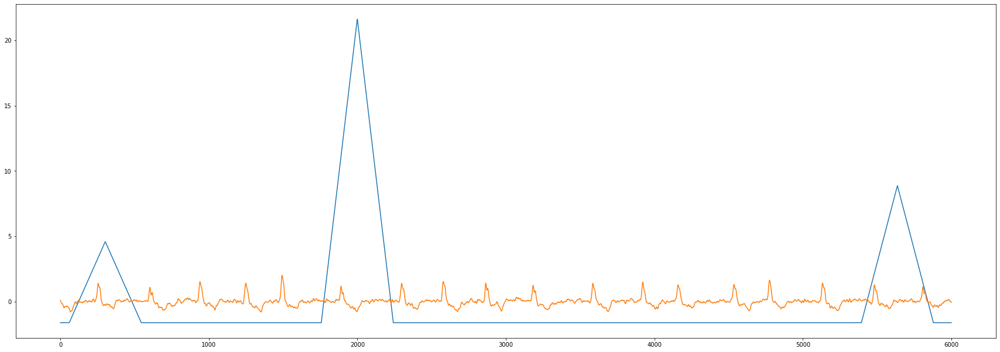

A4898.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


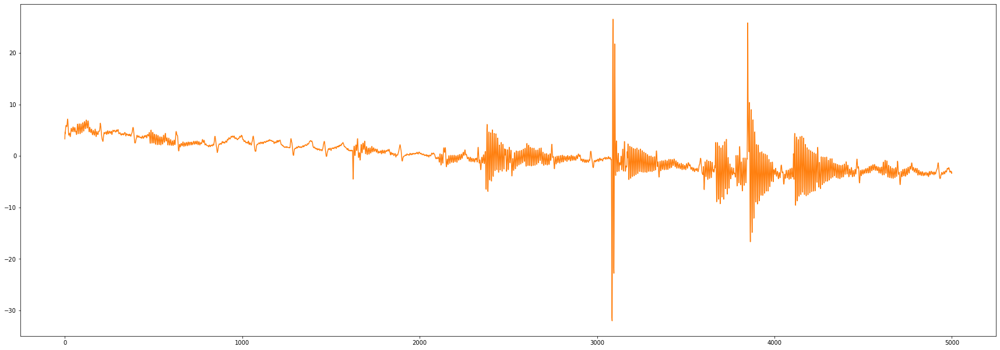

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


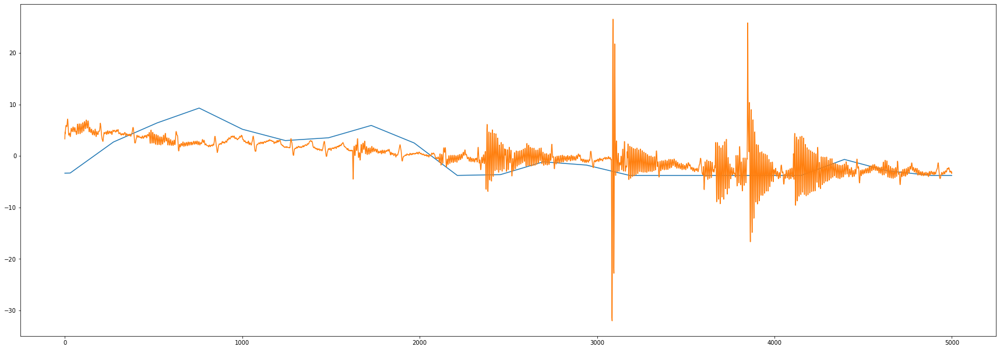

A4964.hea
2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


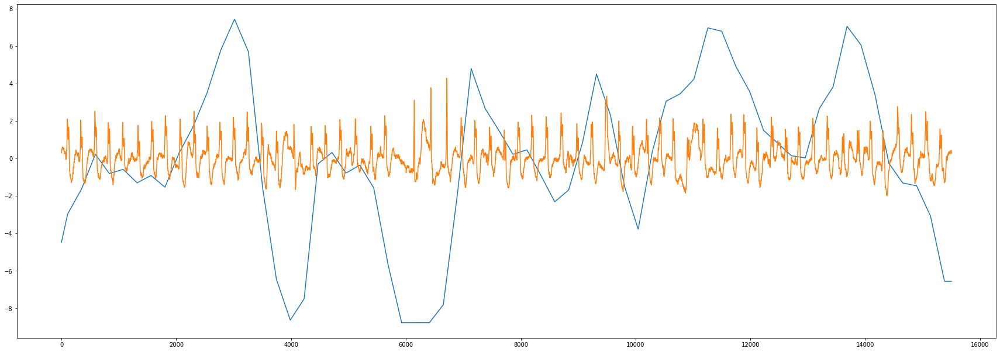

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


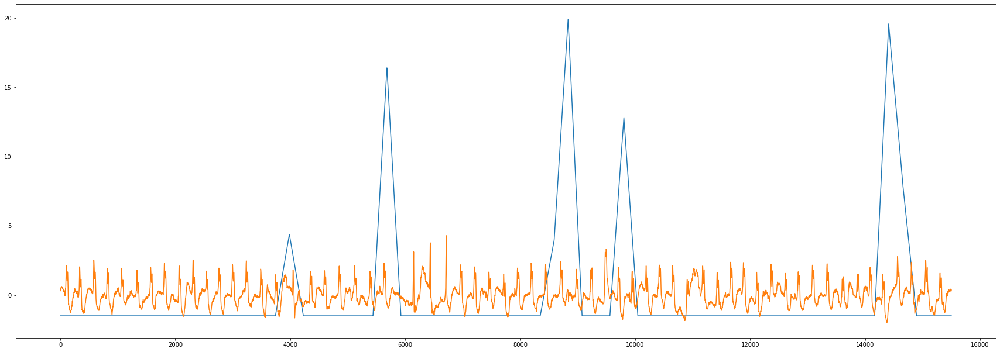

A5129.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


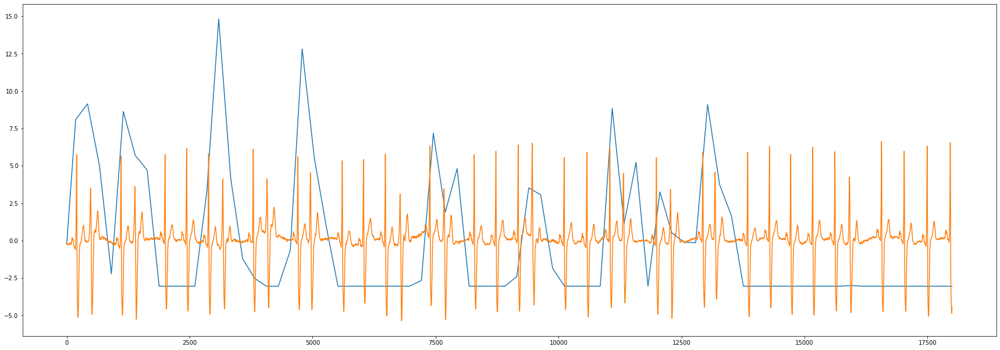

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


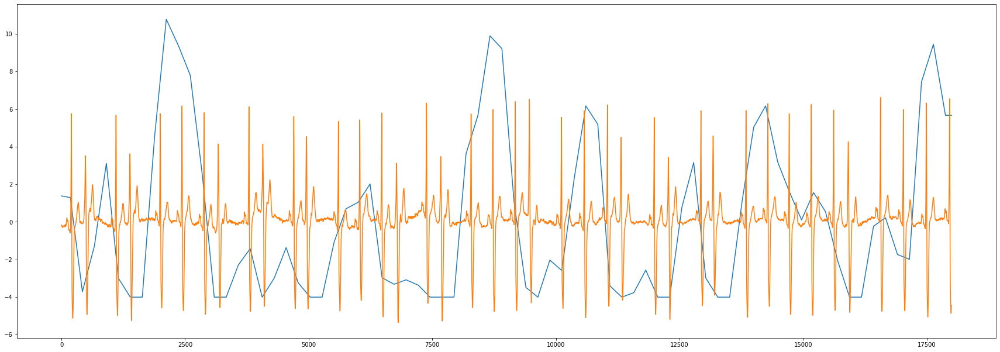

A2374.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


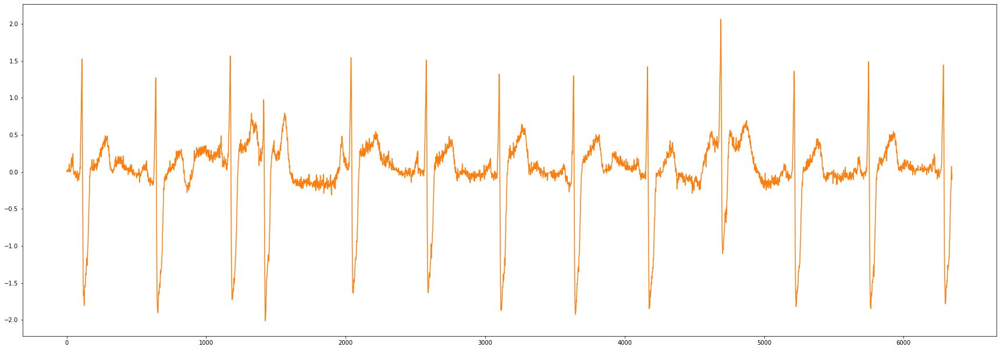

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


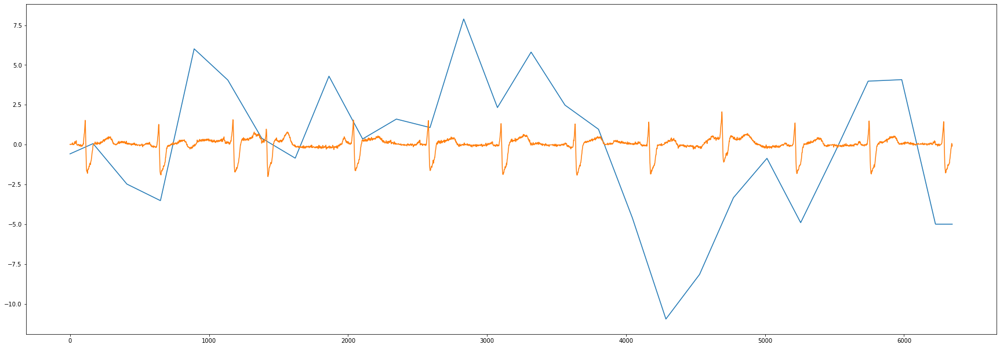

A5801.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


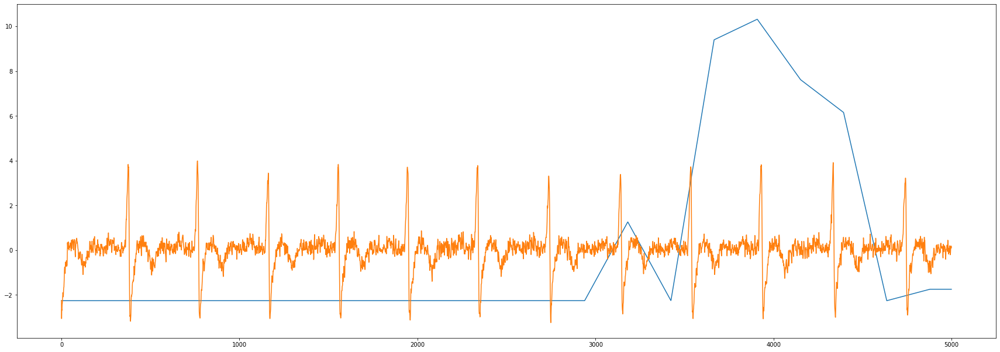

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


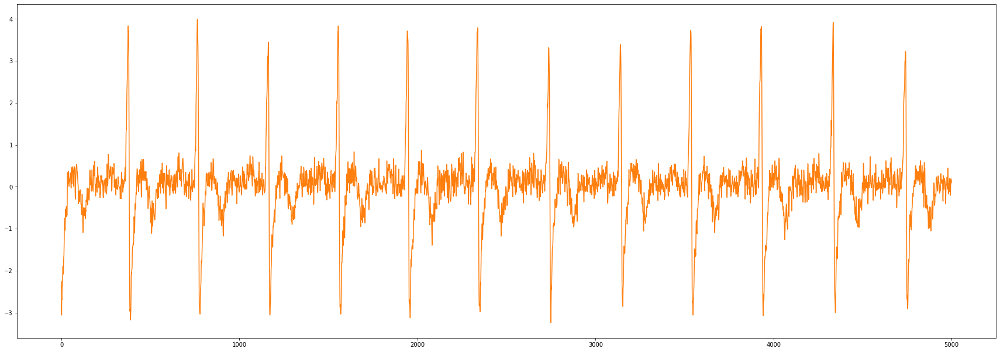

A3262.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


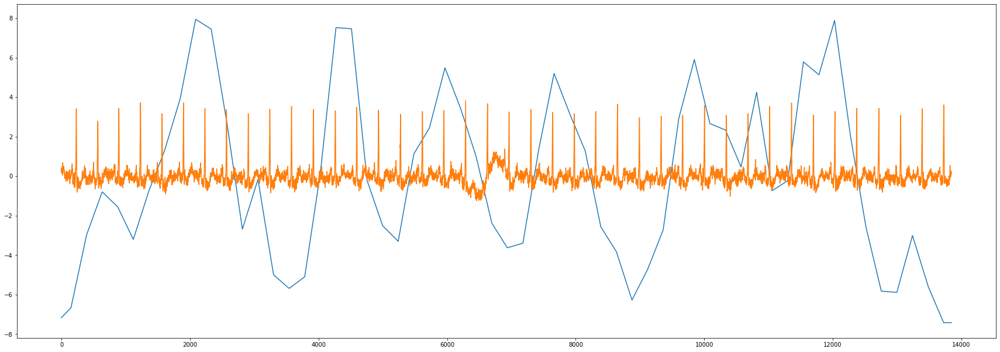

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


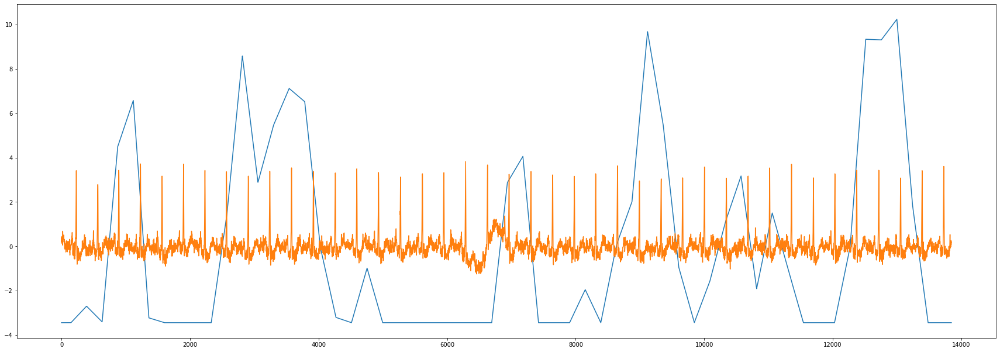

A2069.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


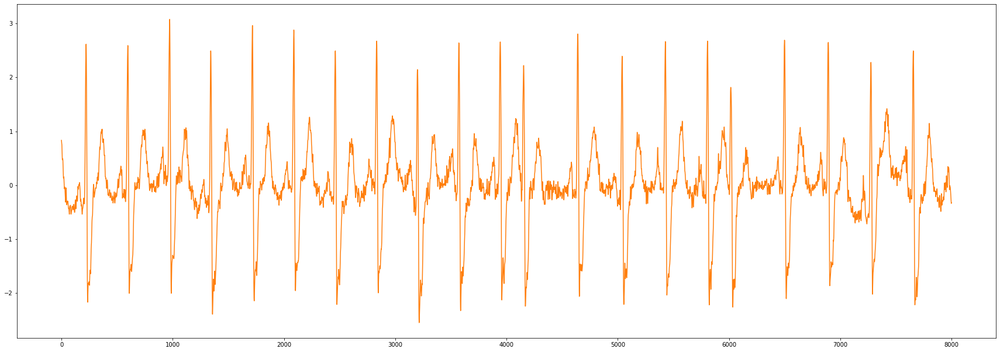

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


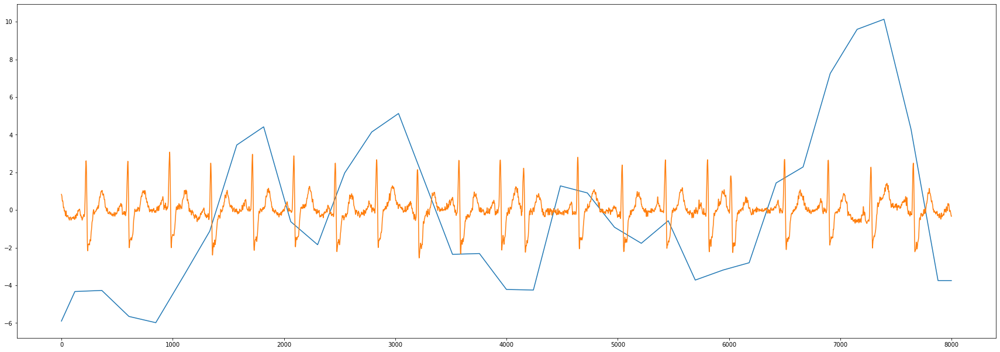

A0308.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


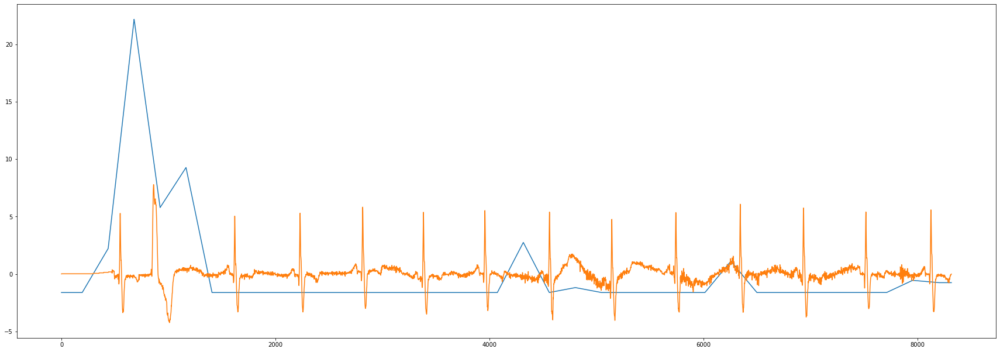

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


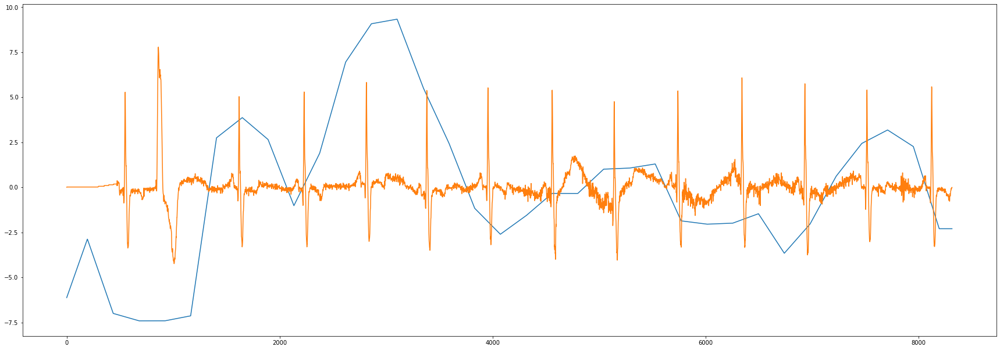

A5643.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


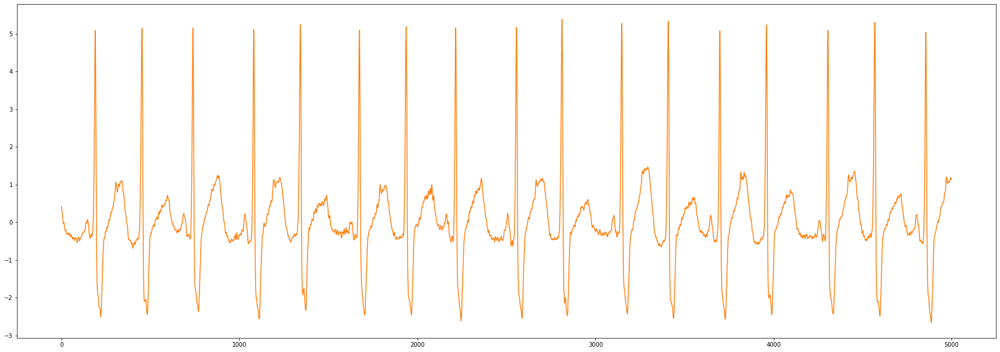

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


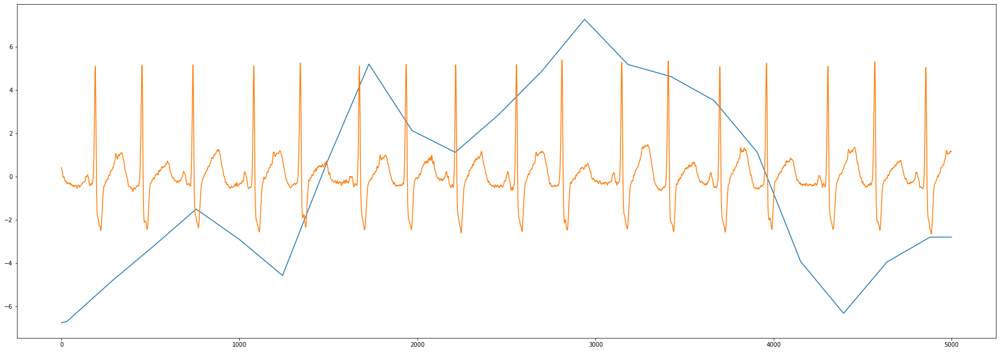

A5781.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


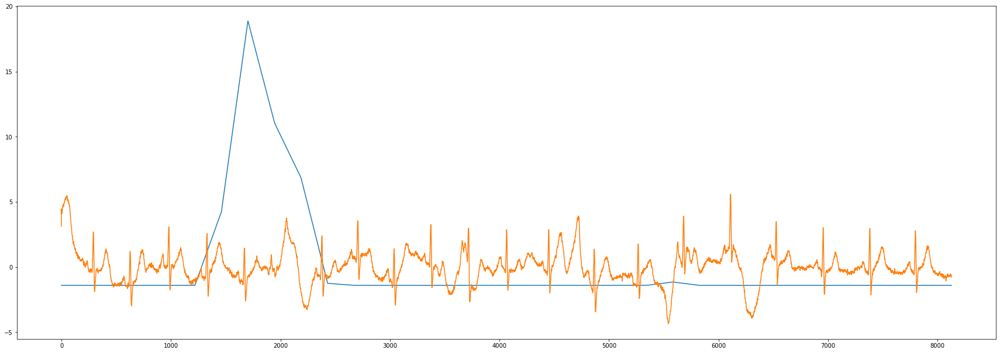

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


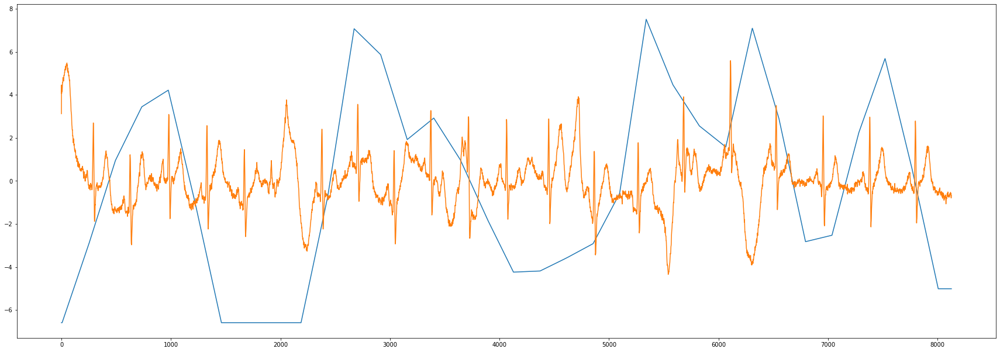

A0910.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


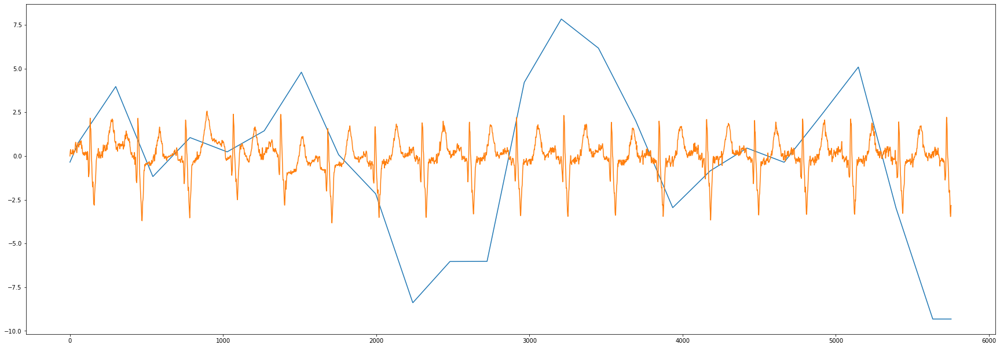

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


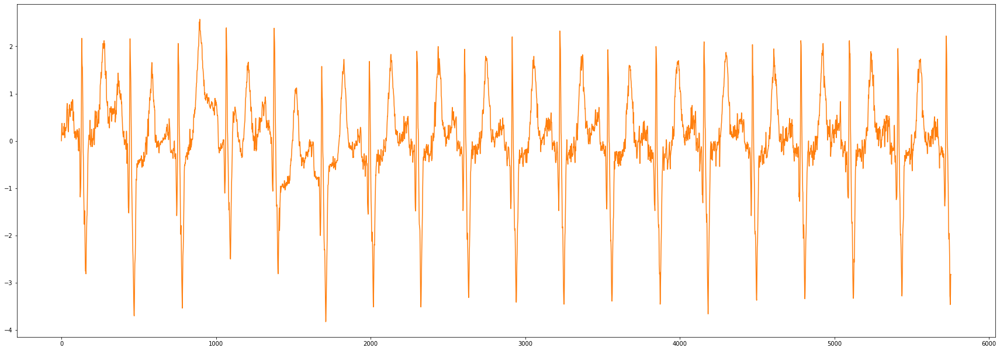

A1340.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


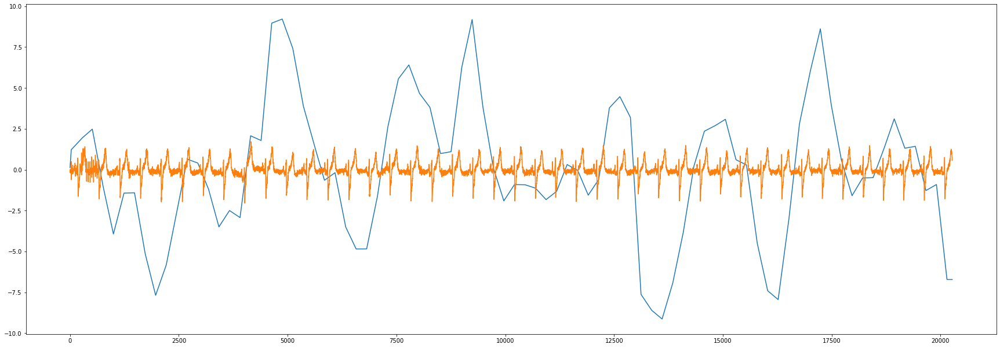

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


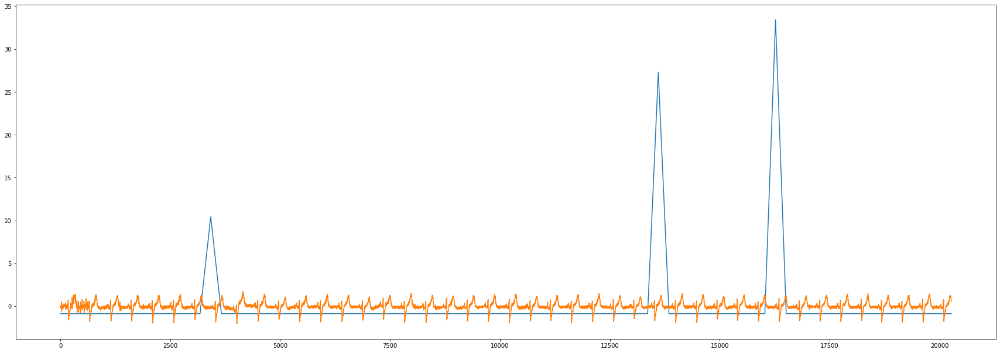

A0563.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


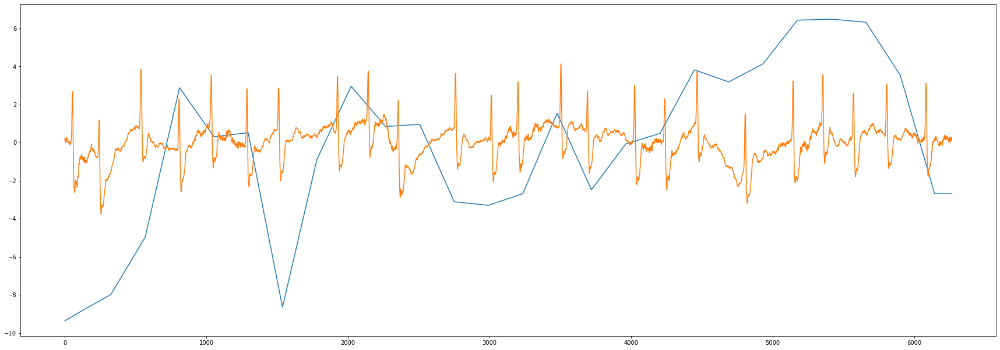

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


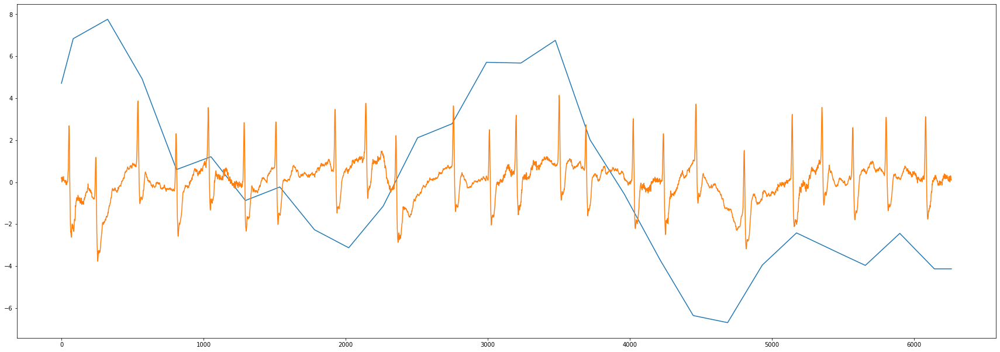

A1047.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


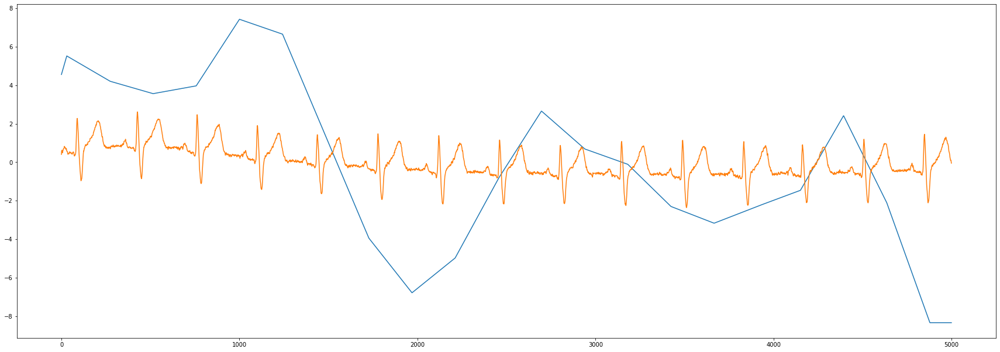

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


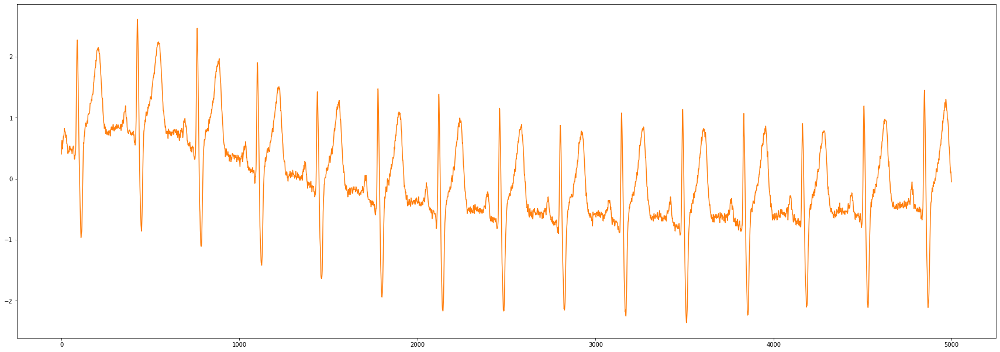

A2027.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


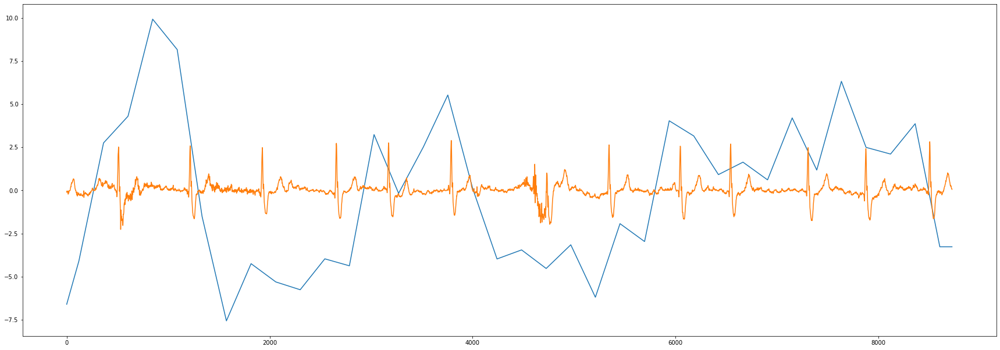

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


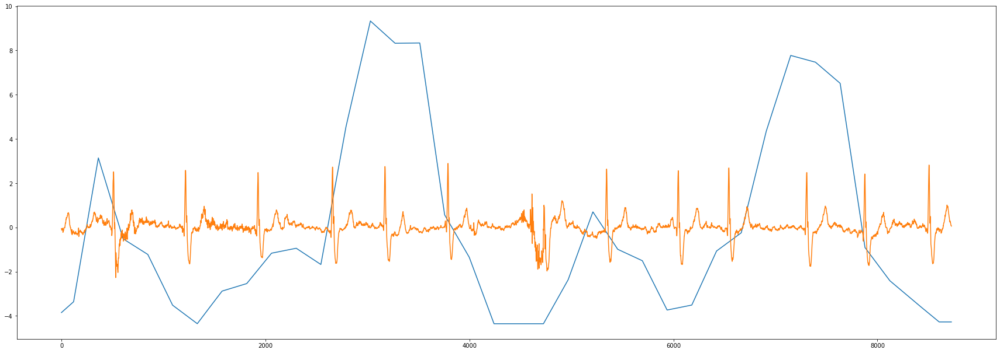

A1505.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


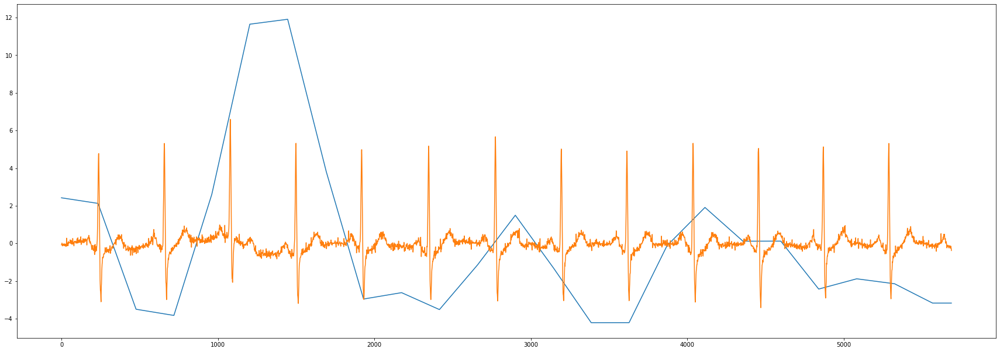

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


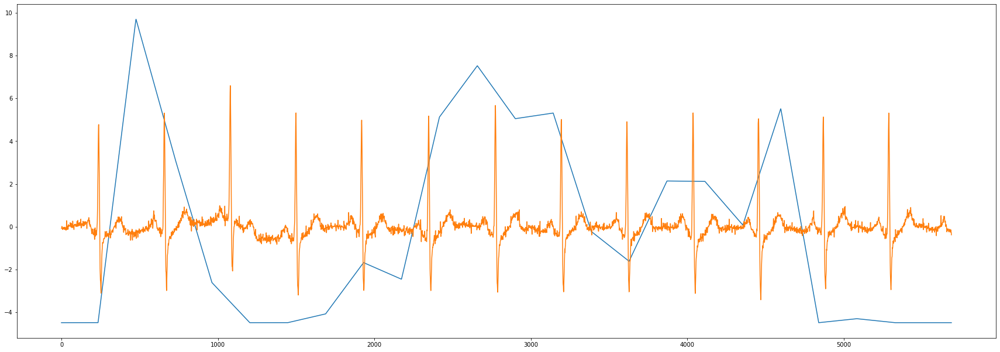

A1408.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


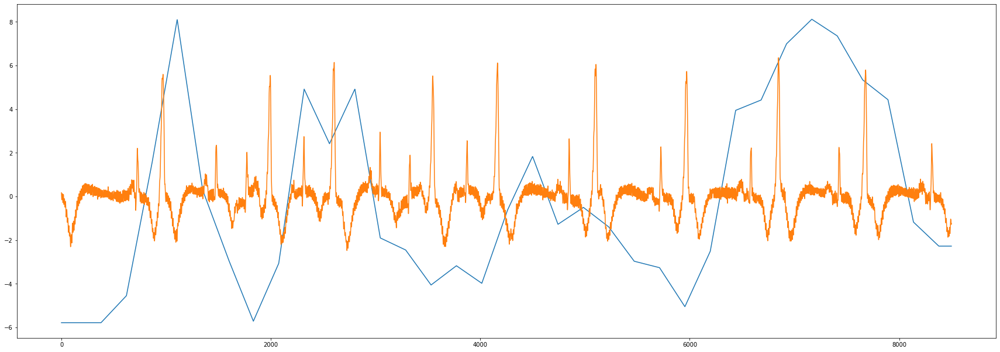

5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


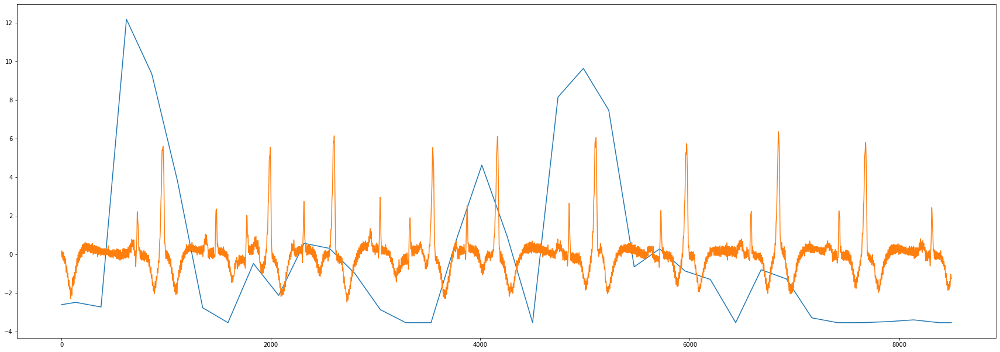

A4475.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


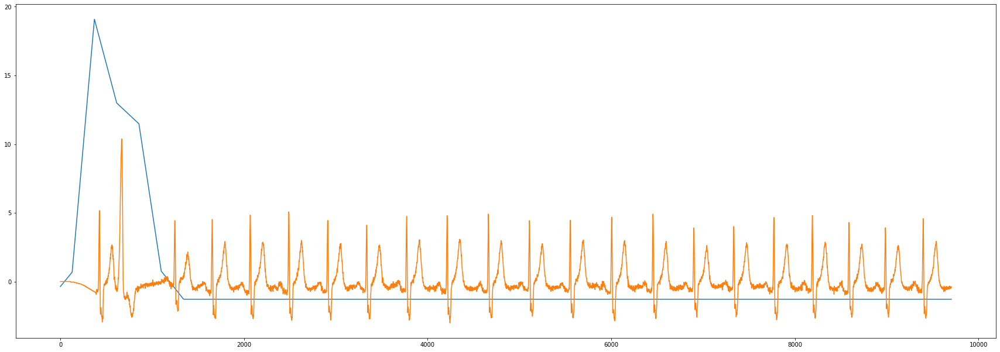

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


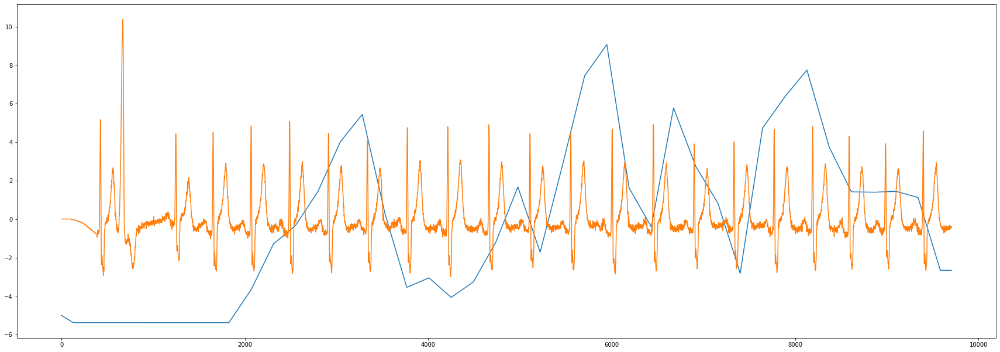

A1118.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


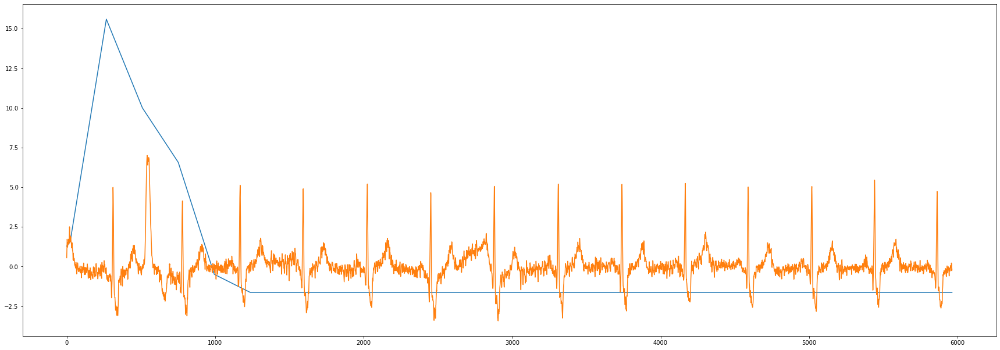

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


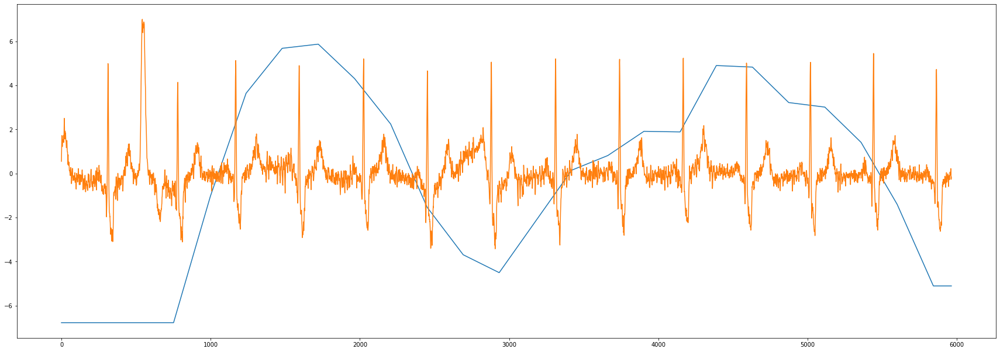

A4673.hea
2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


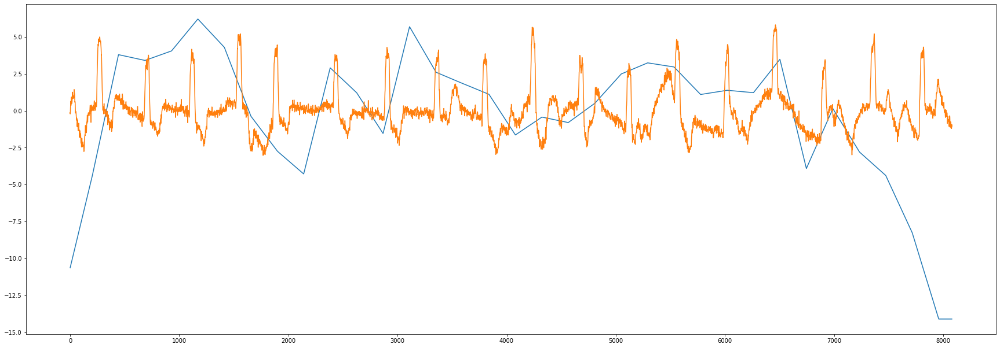

4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


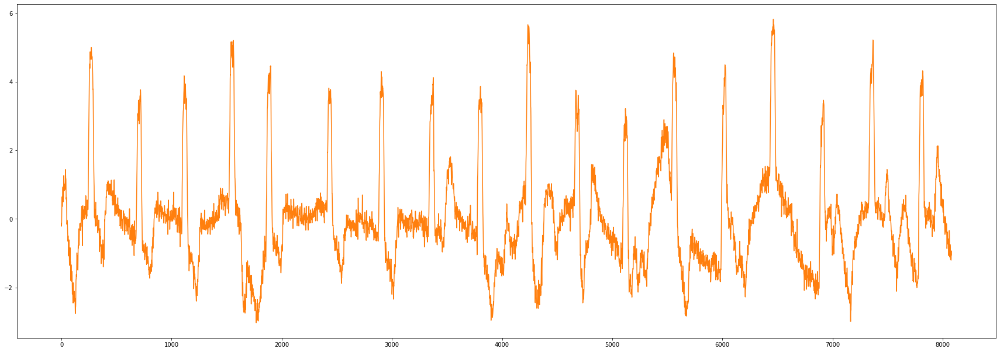

A1164.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


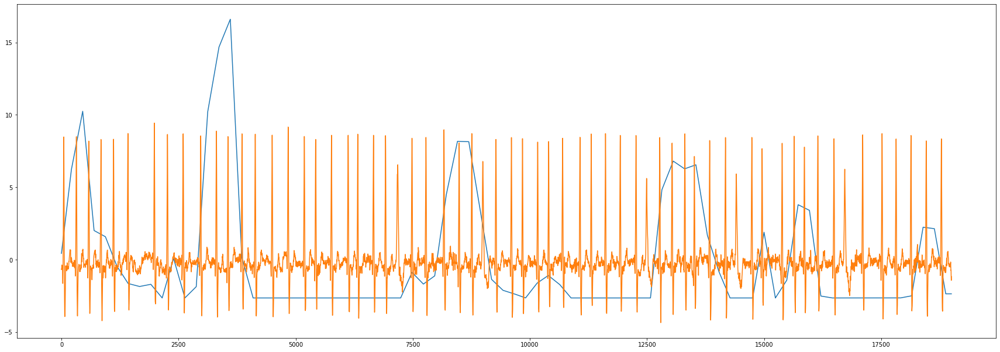

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


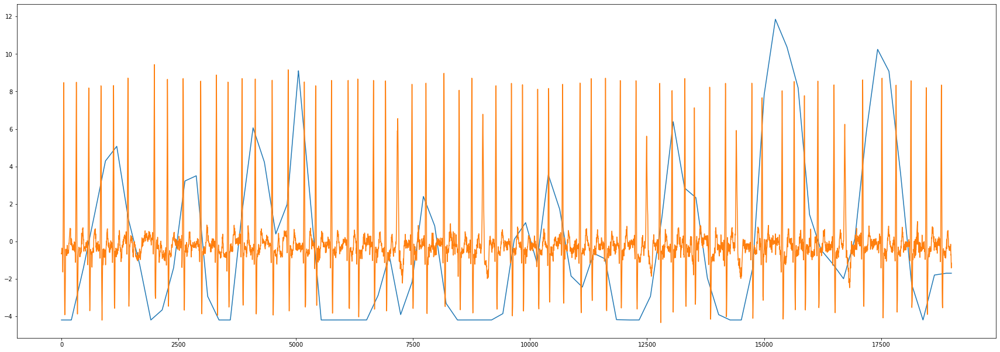

A4815.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


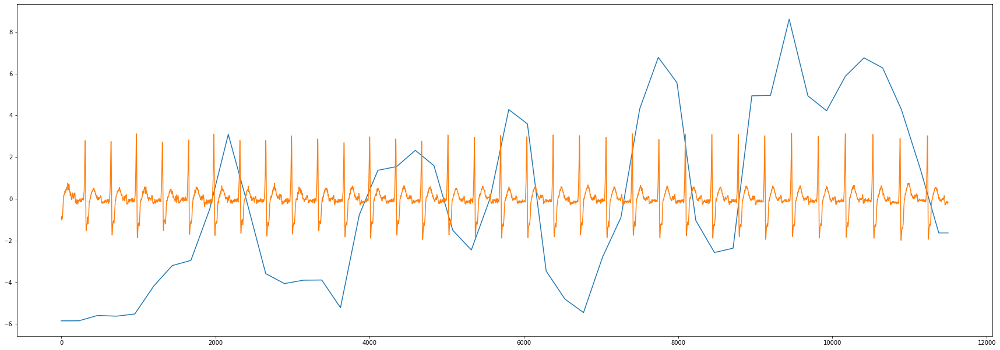

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


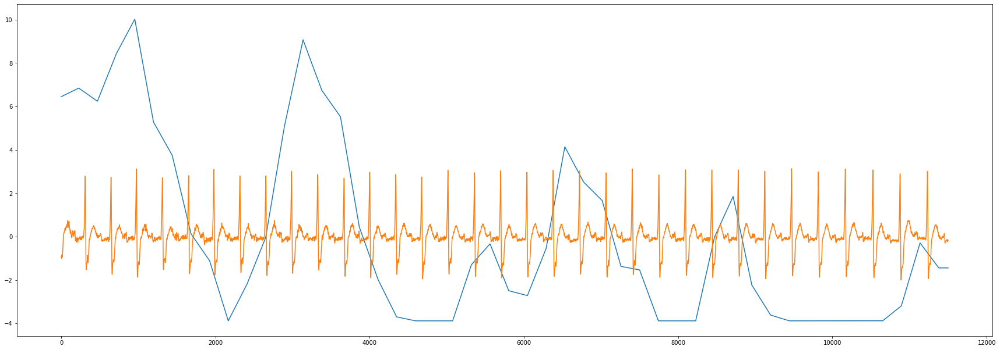

A6038.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


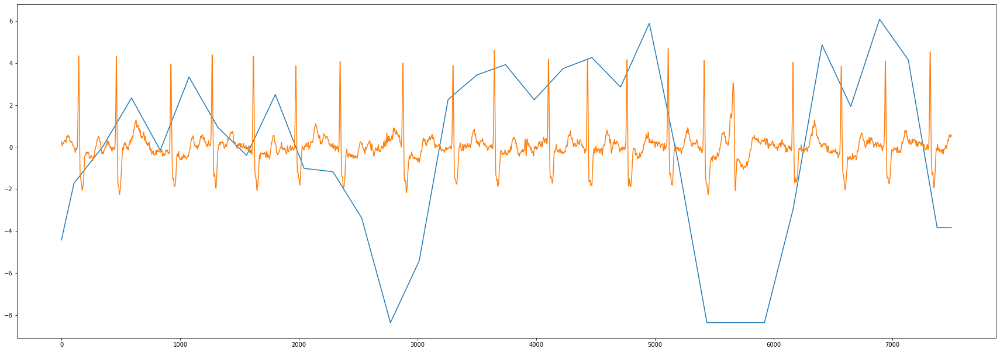

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


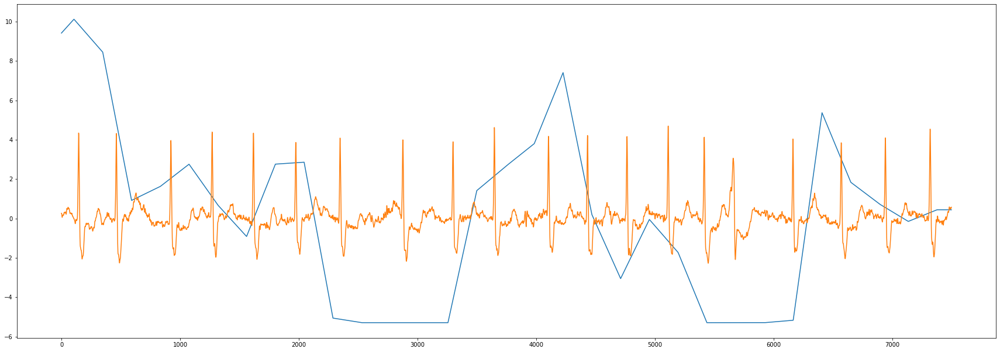

A5590.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


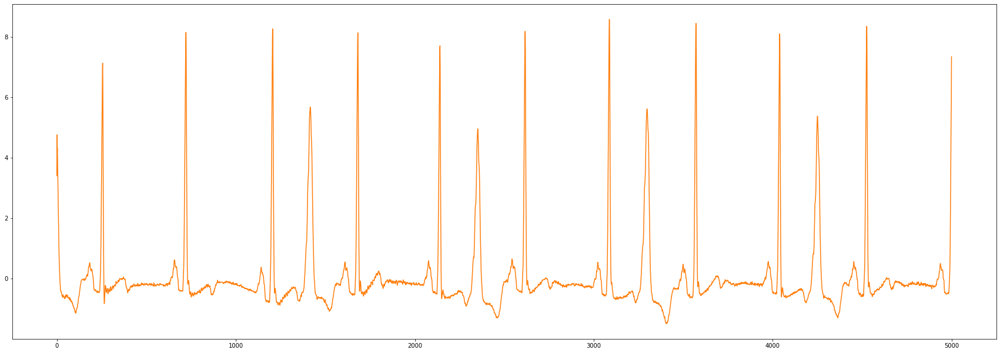

5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


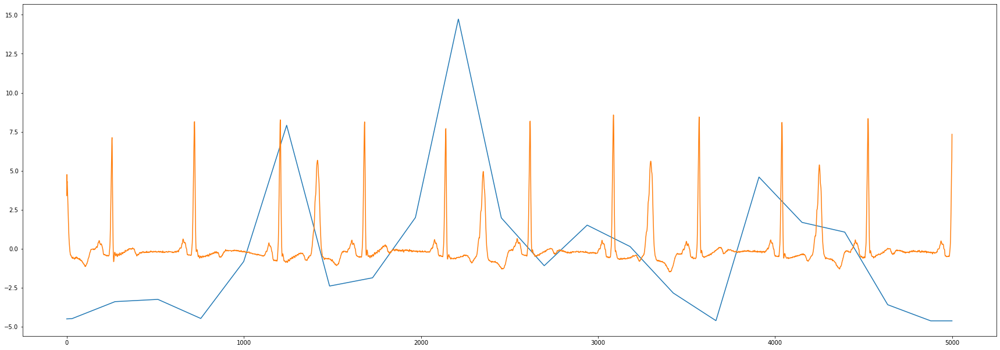

A1562.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


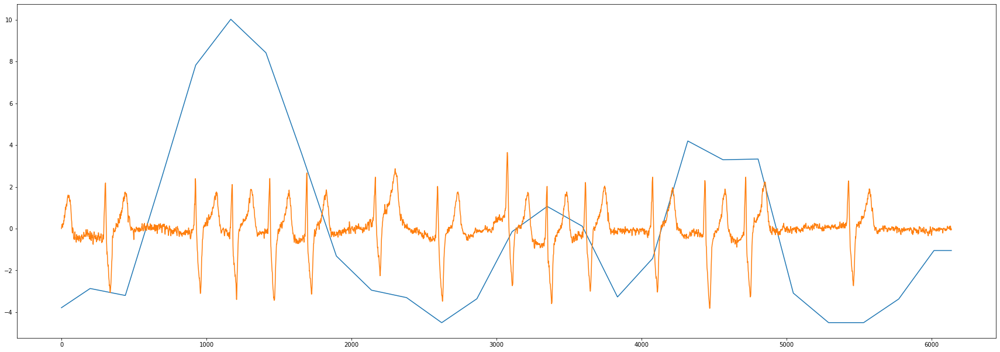

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


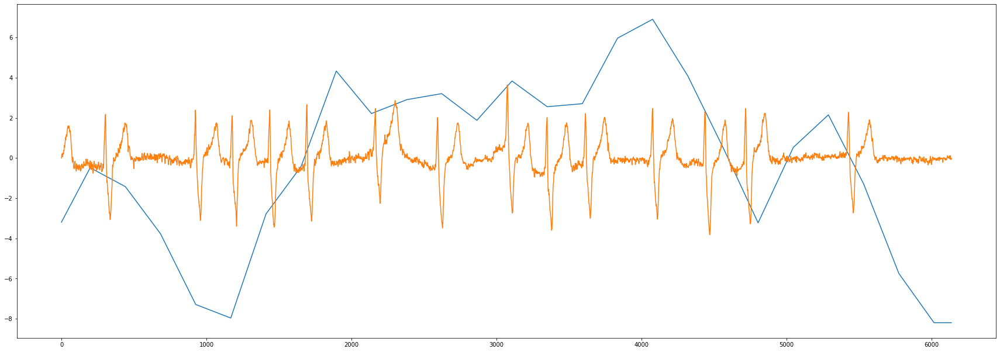

A5060.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


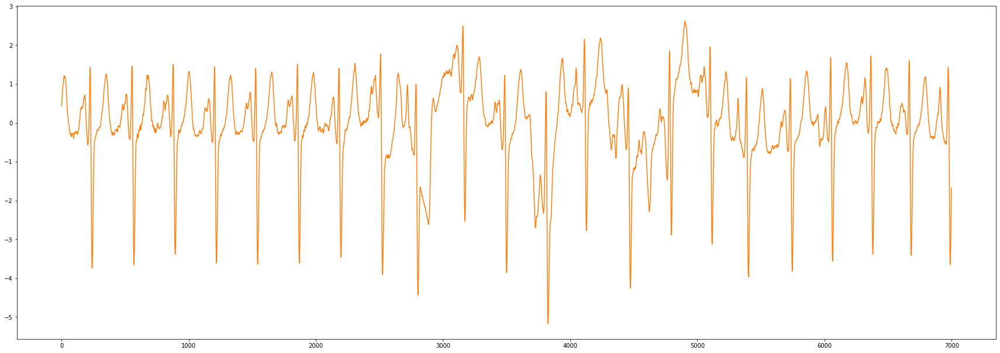

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


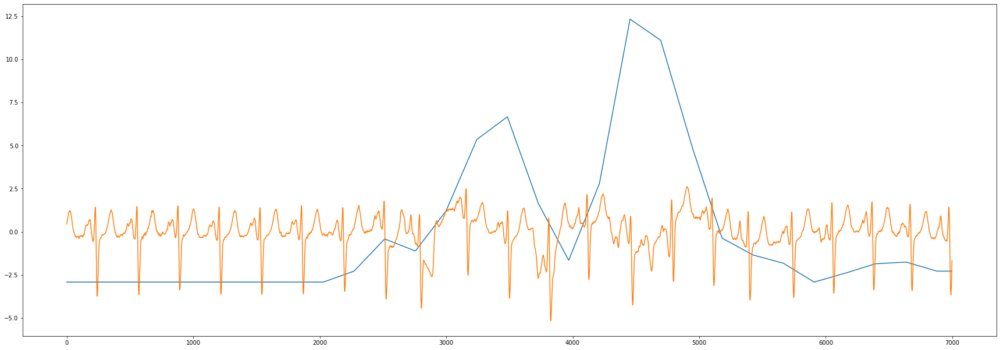

A2602.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


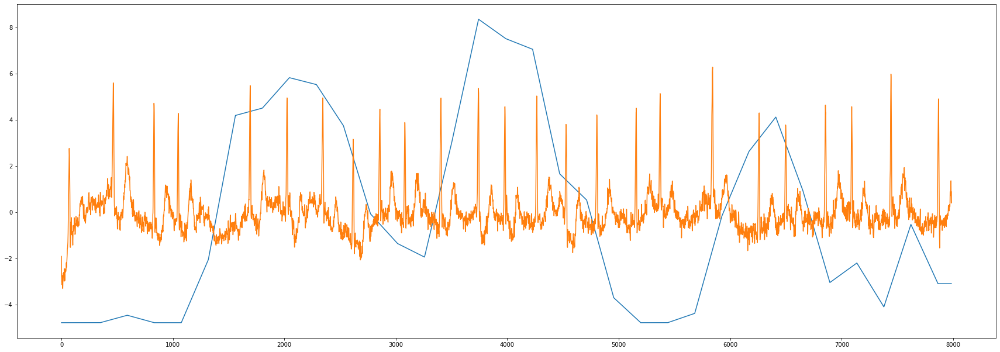

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


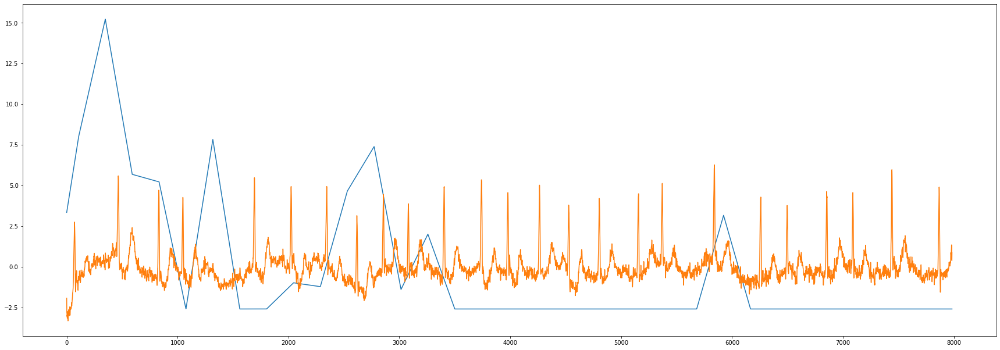

A3089.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


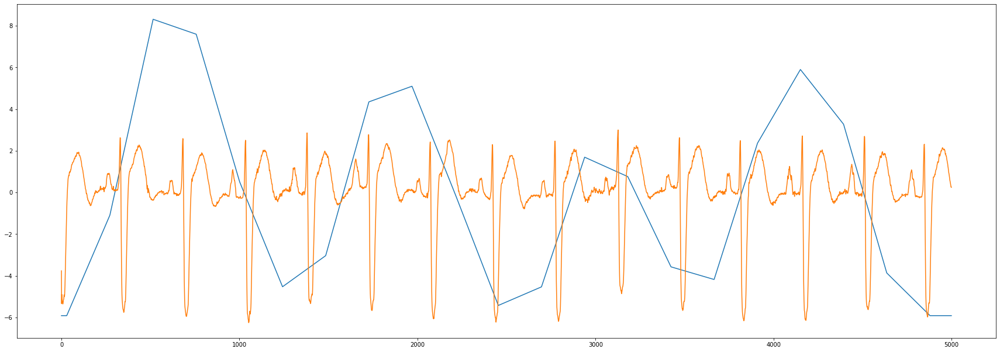

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


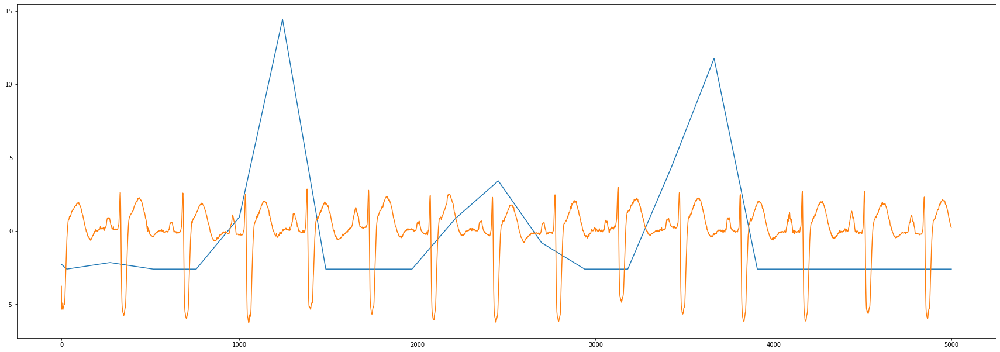

A0218.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


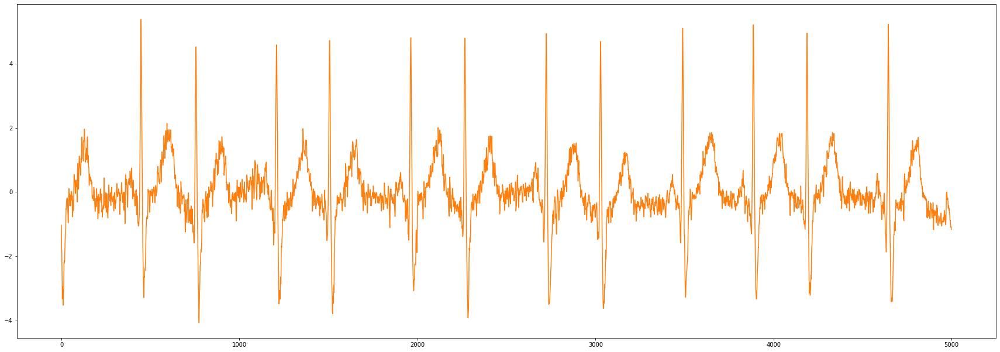

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


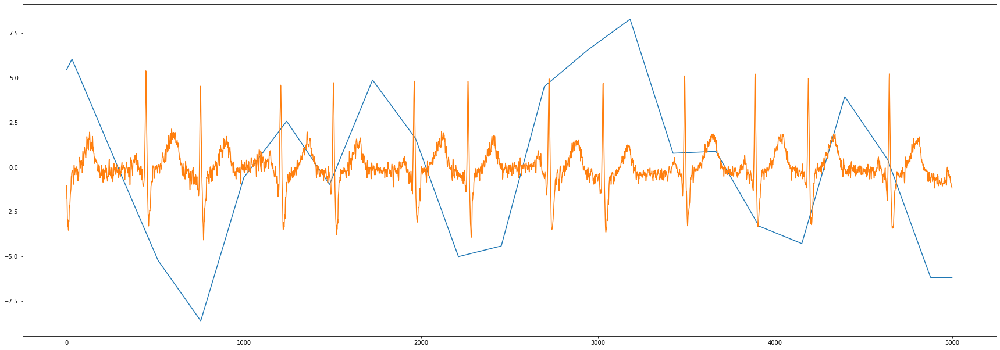

A5969.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


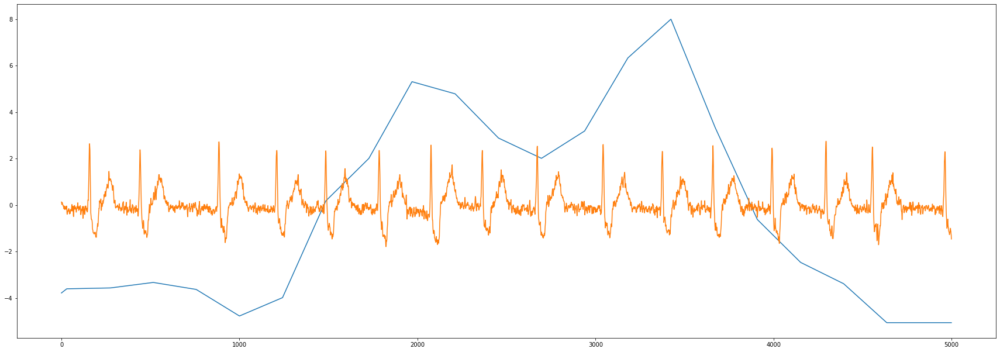

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


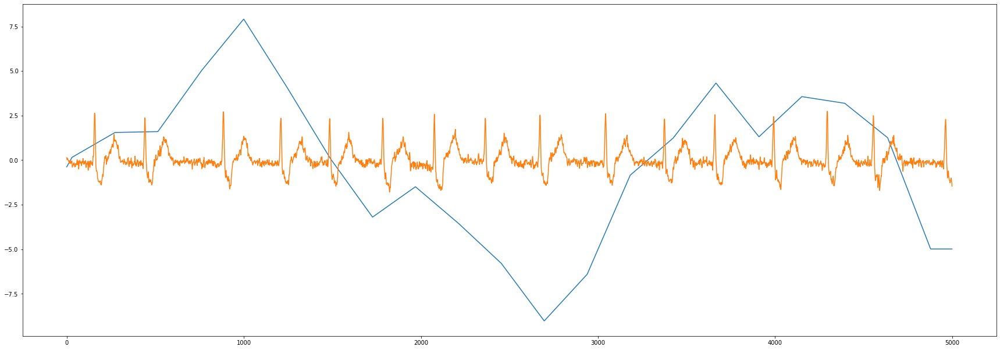

A2898.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


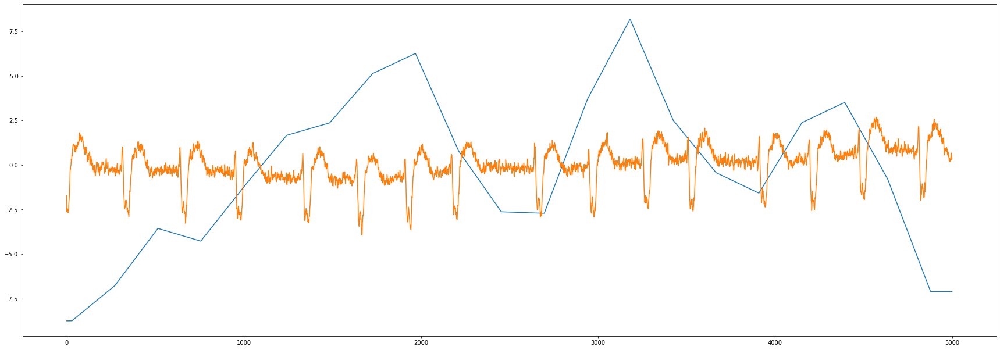

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


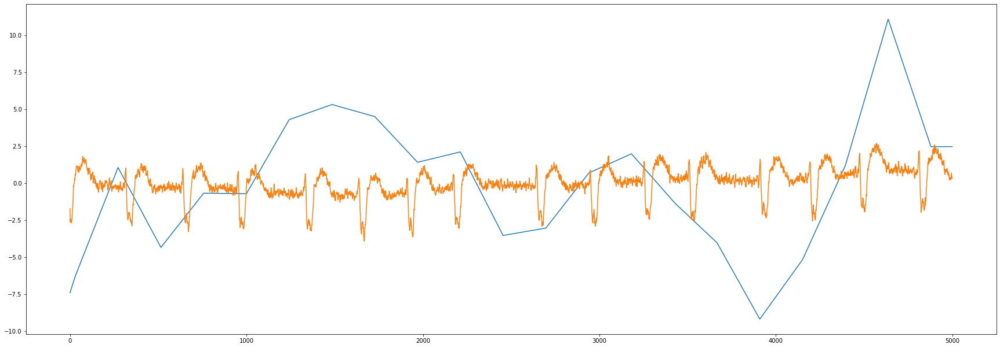

A2278.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


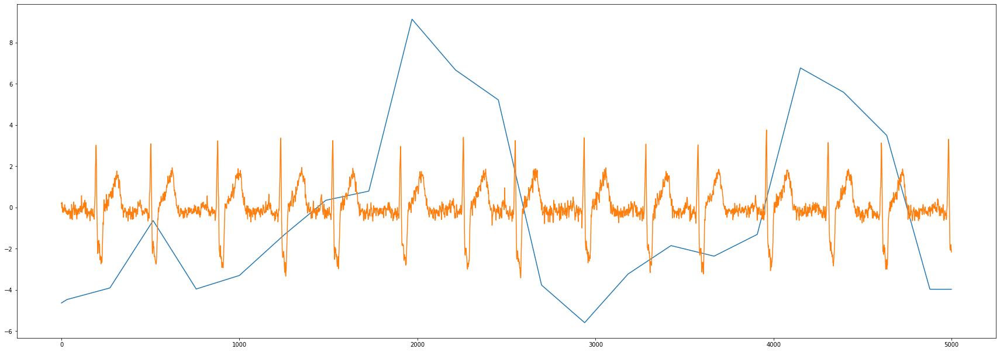

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


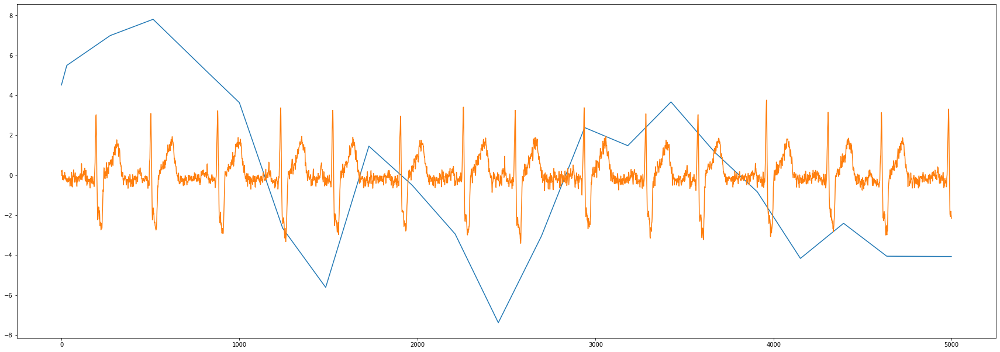

A0152.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


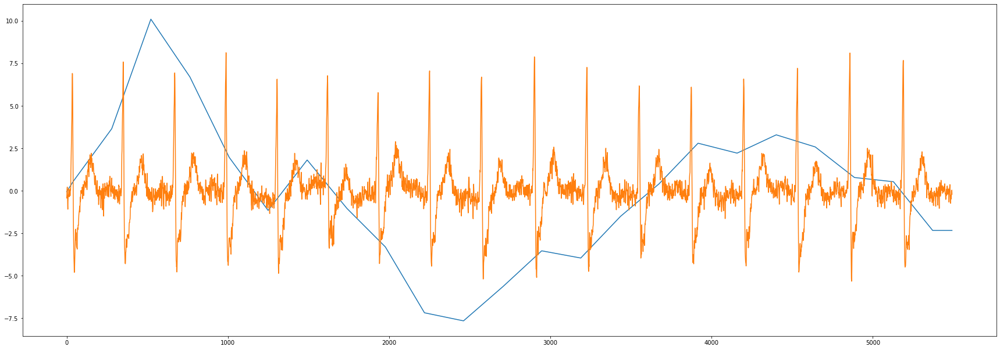

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


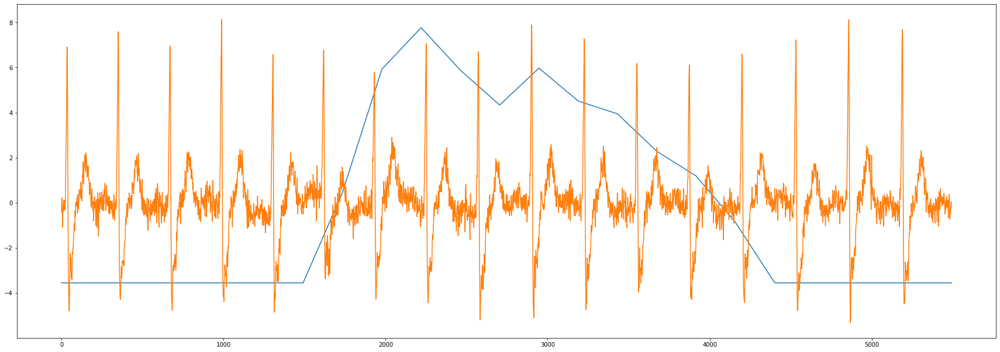

A2795.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


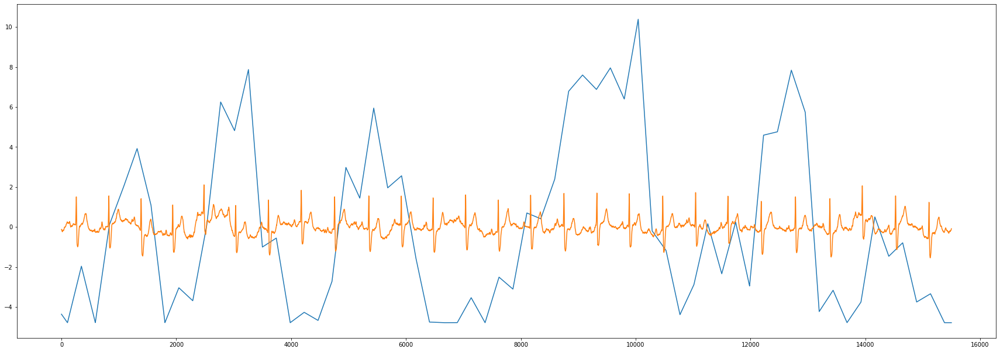

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


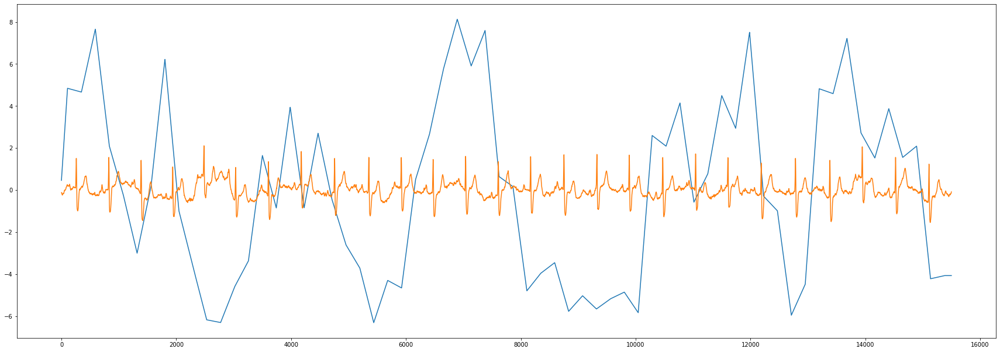

A6296.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


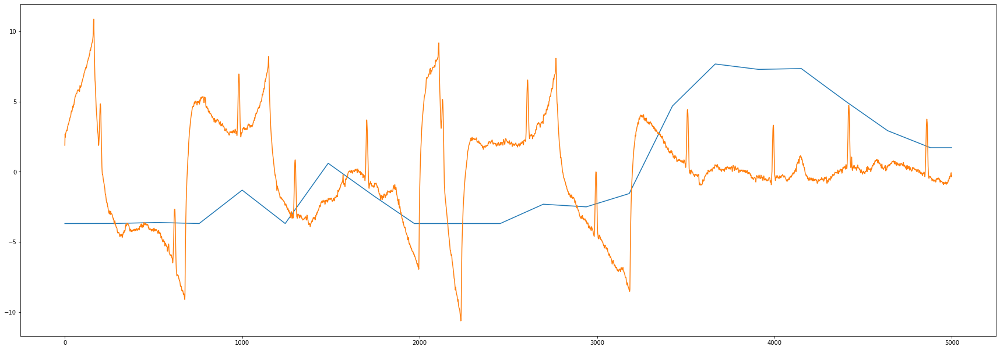

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


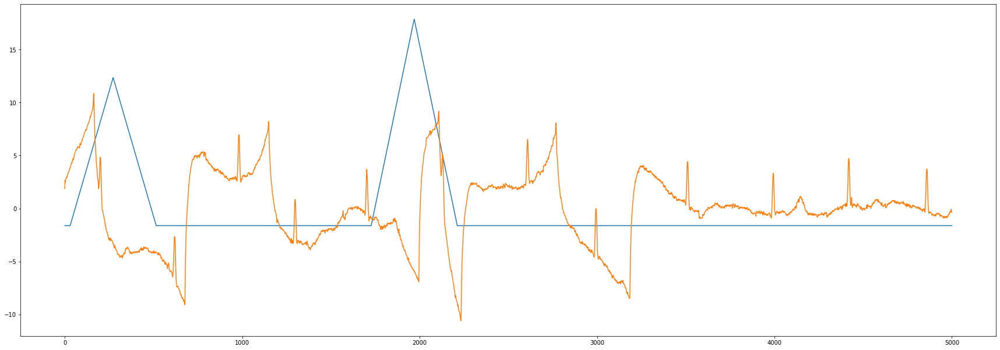

A6790.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


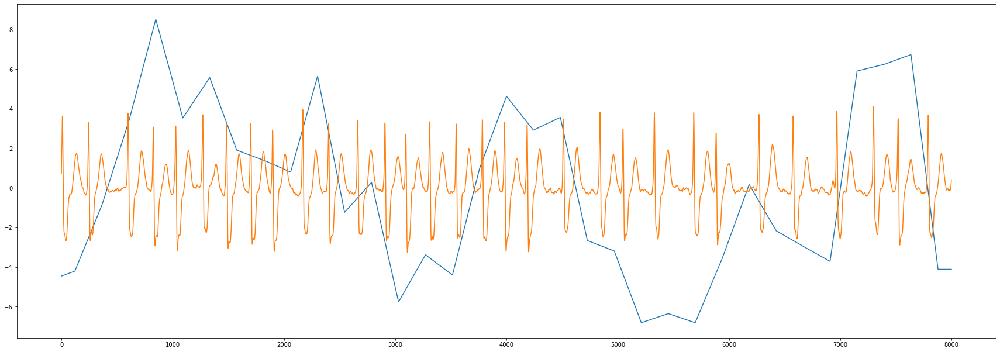

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


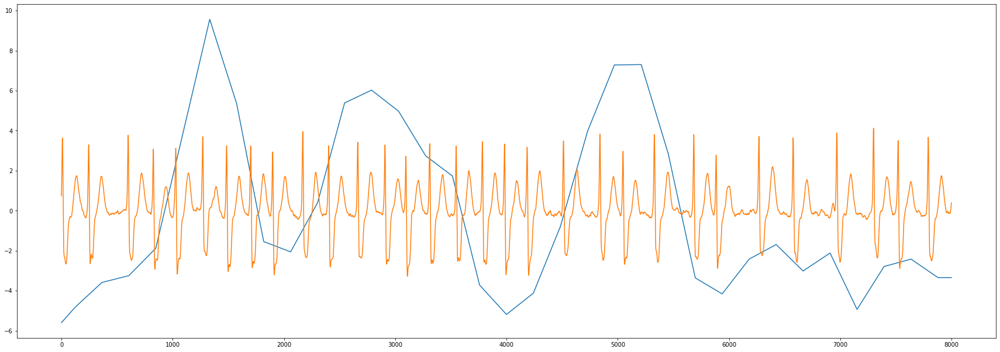

A6302.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


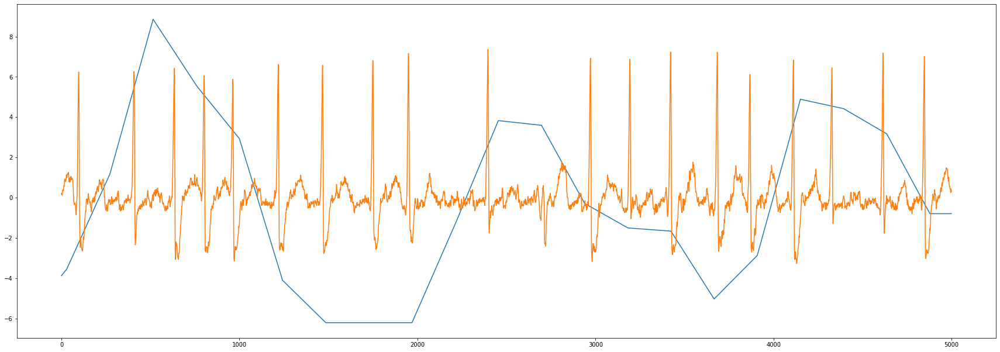

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


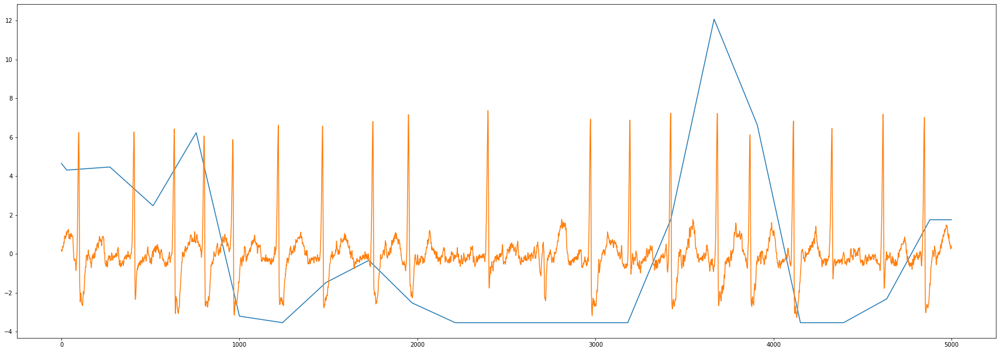

A0109.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


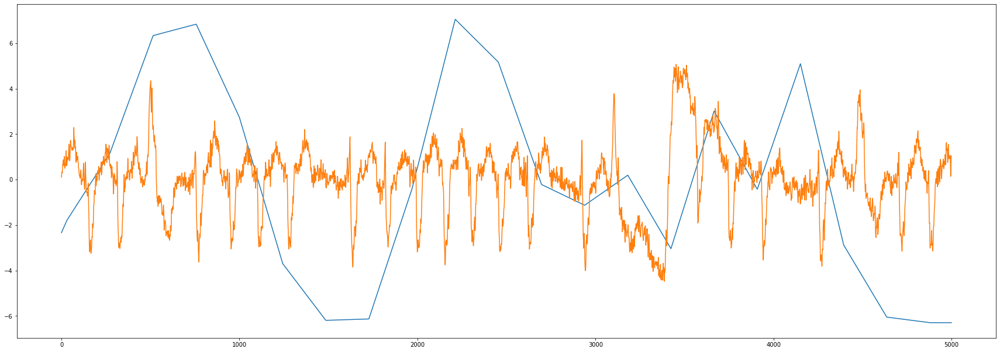

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


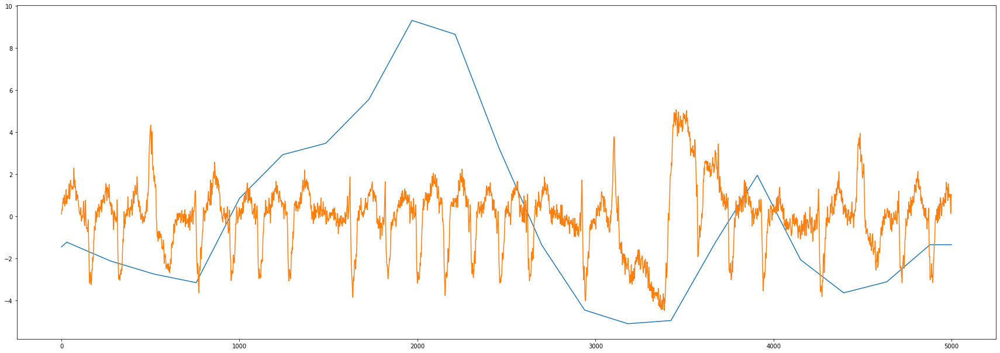

A2107.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


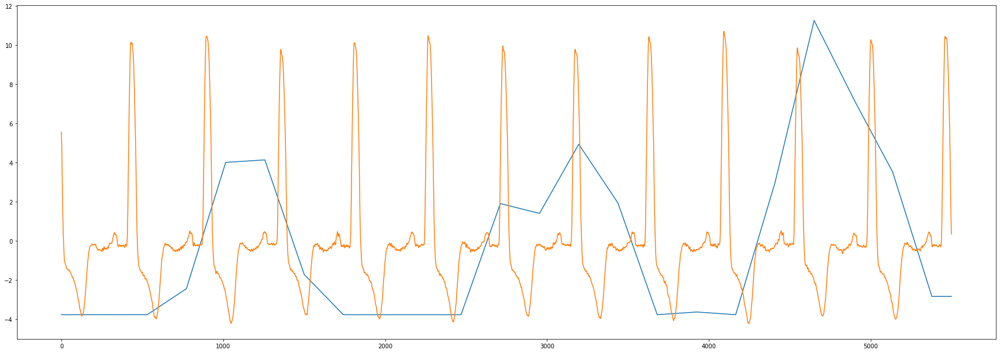

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


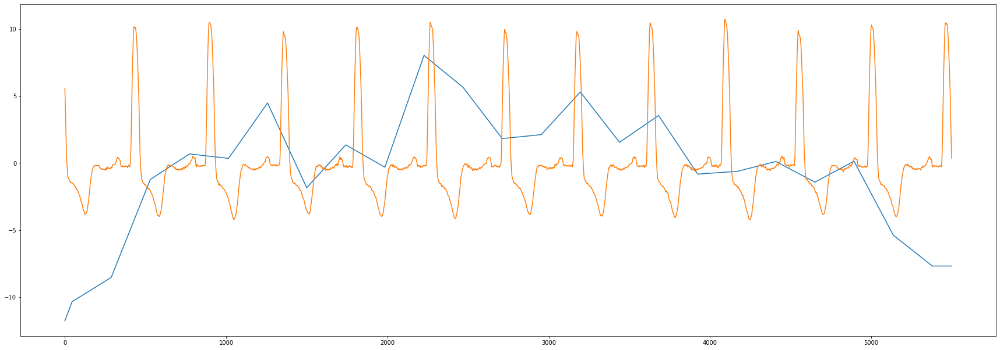

A4993.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


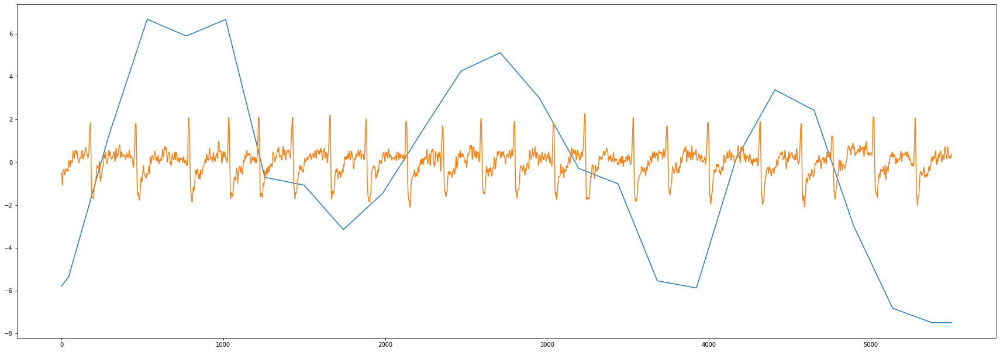

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


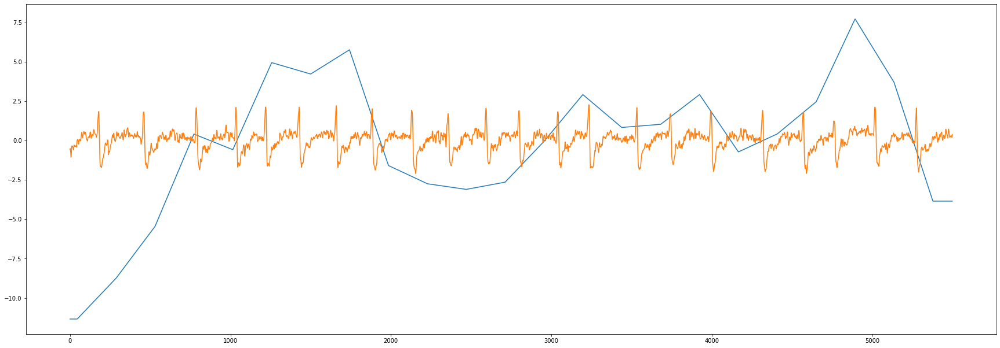

A5724.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


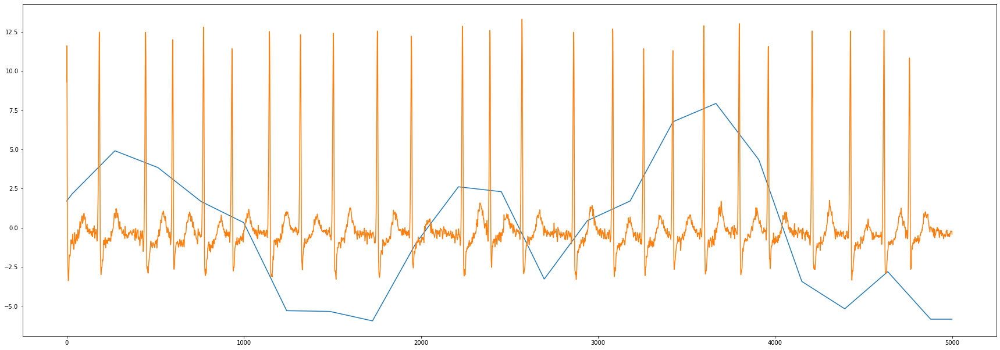

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


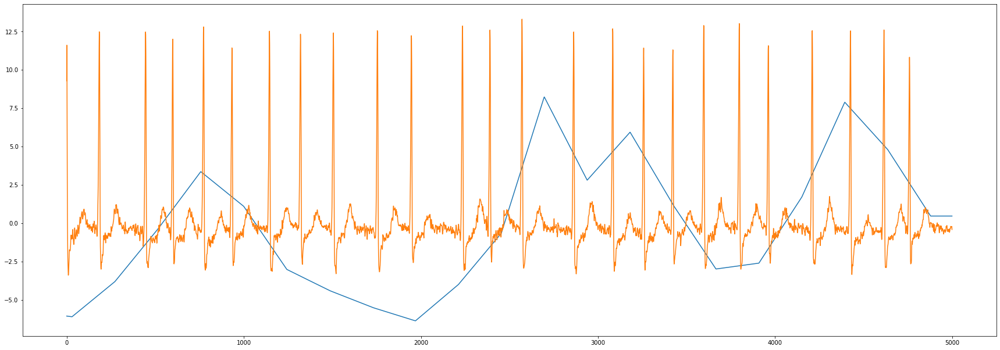

A2436.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


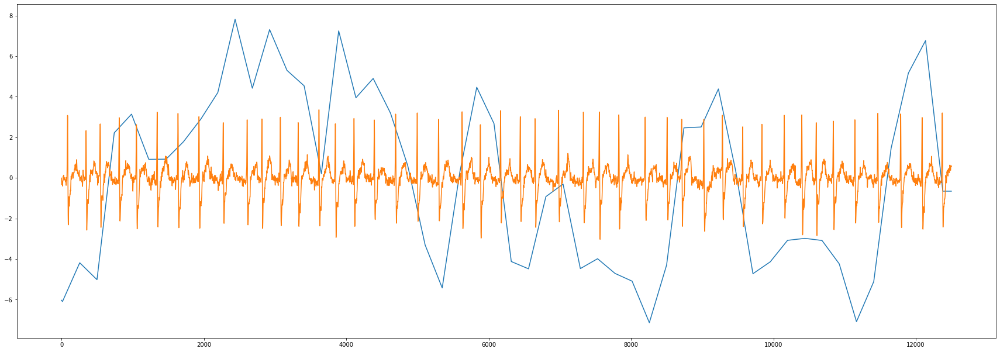

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


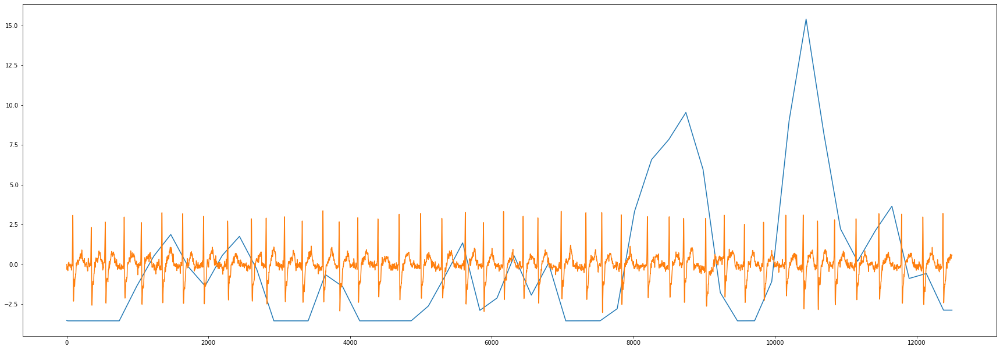

A5576.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


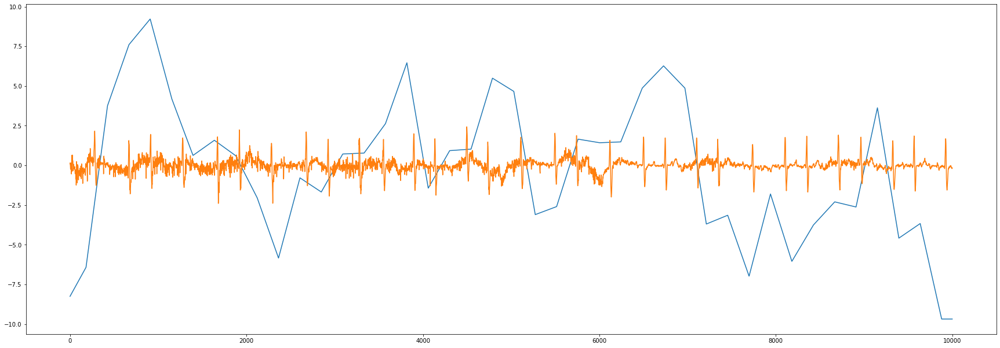

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


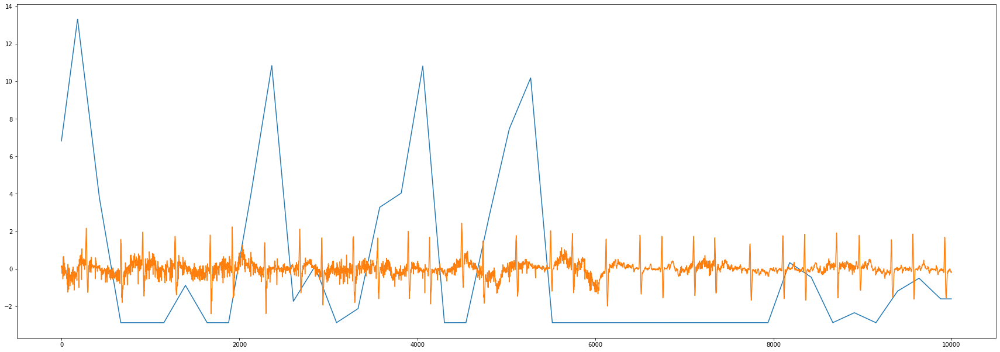

A4359.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


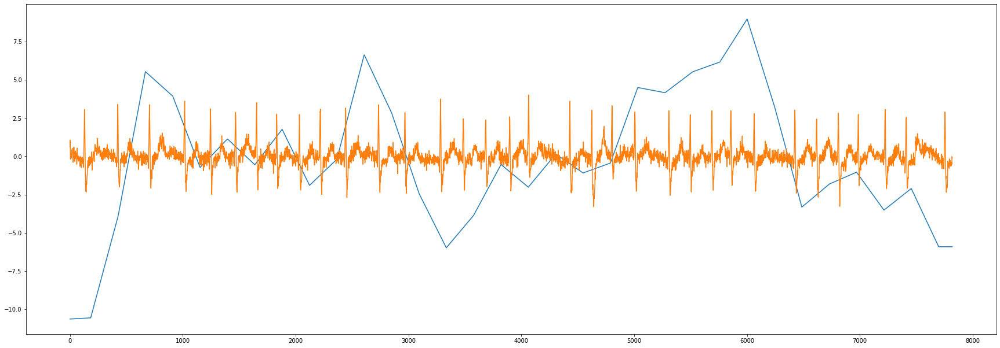

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


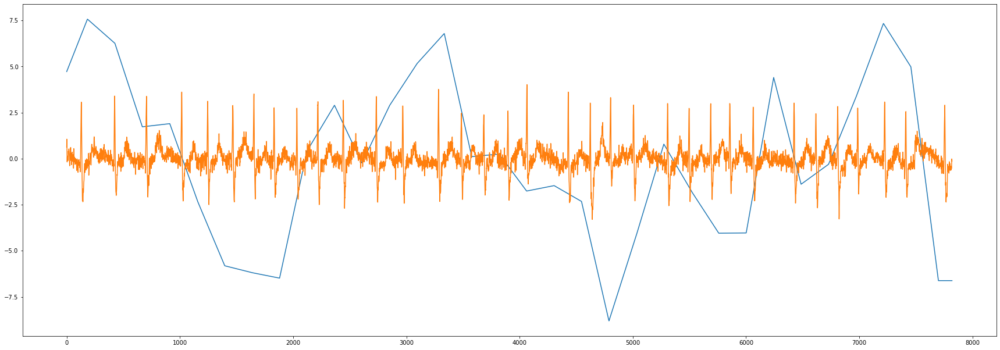

A5971.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


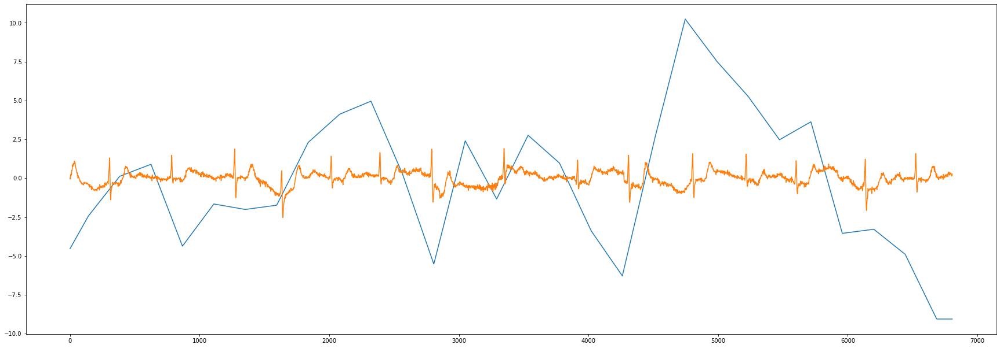

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


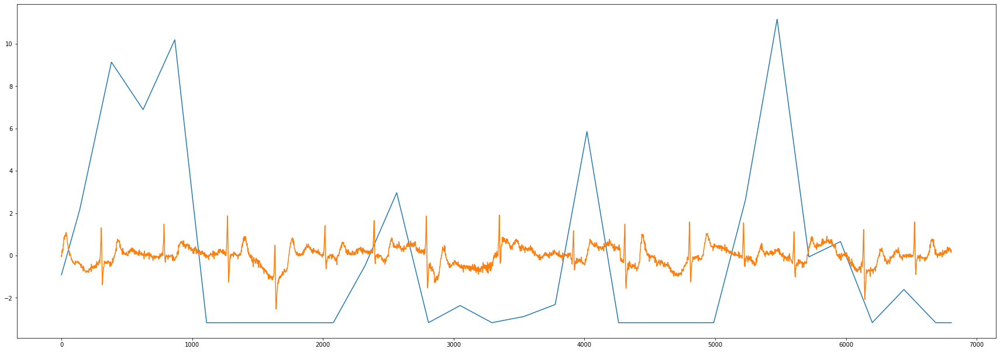

A6817.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


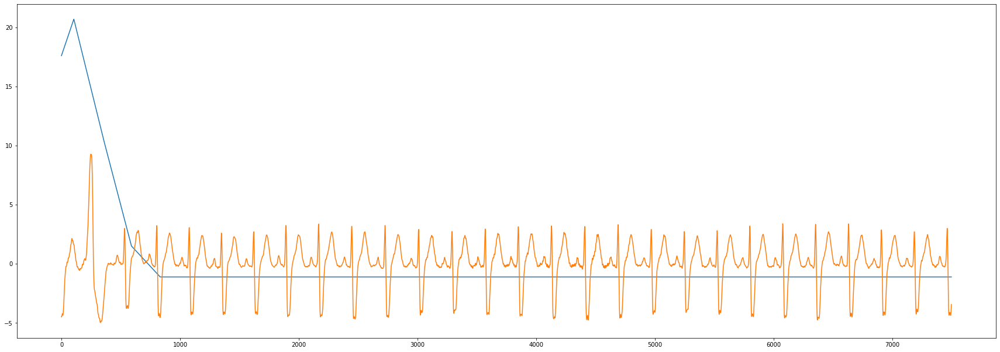

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


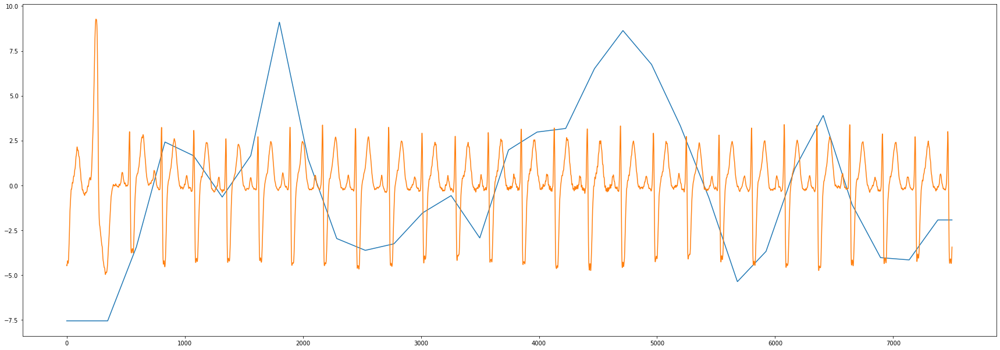

A2935.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


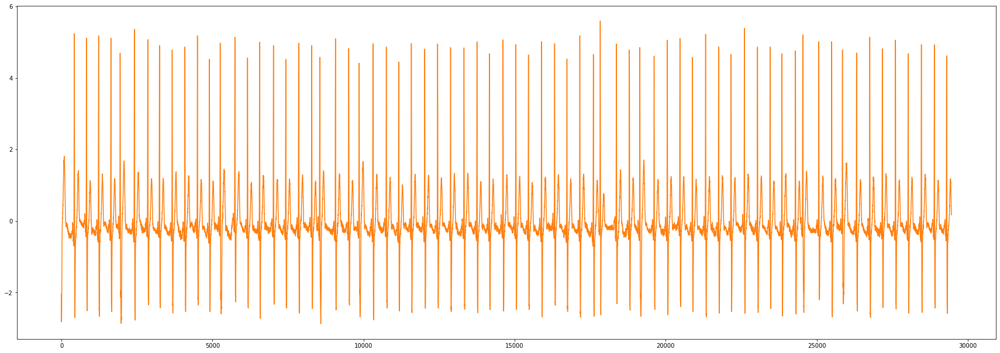

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


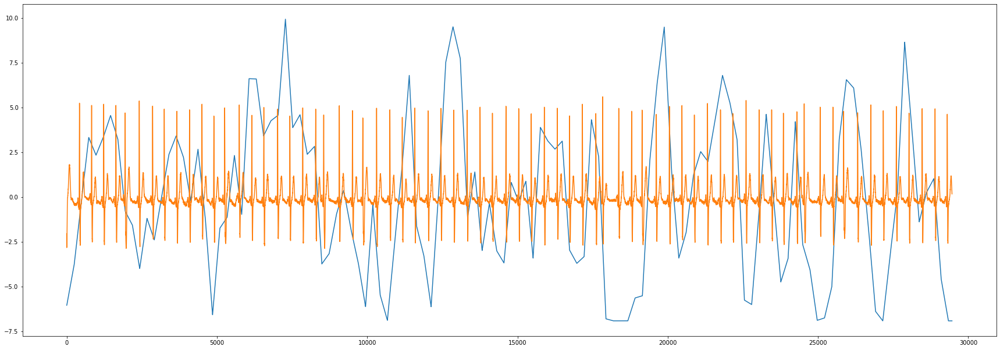

A4075.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


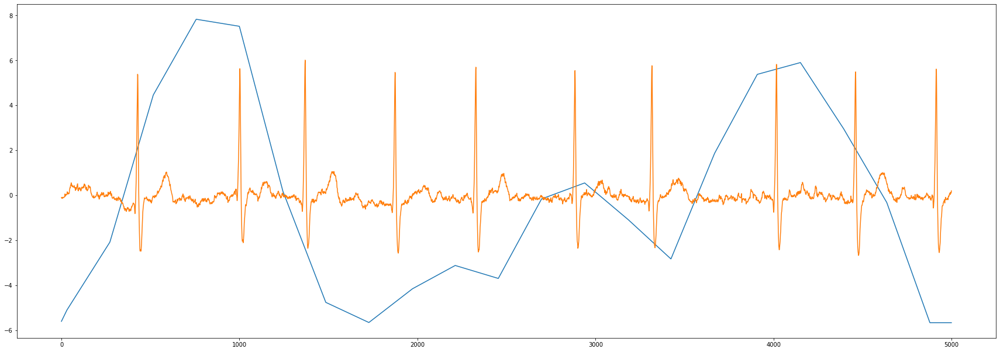

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


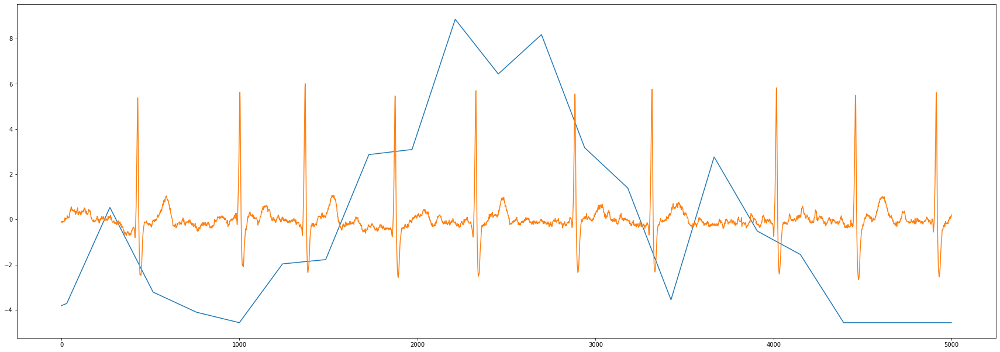

A6834.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


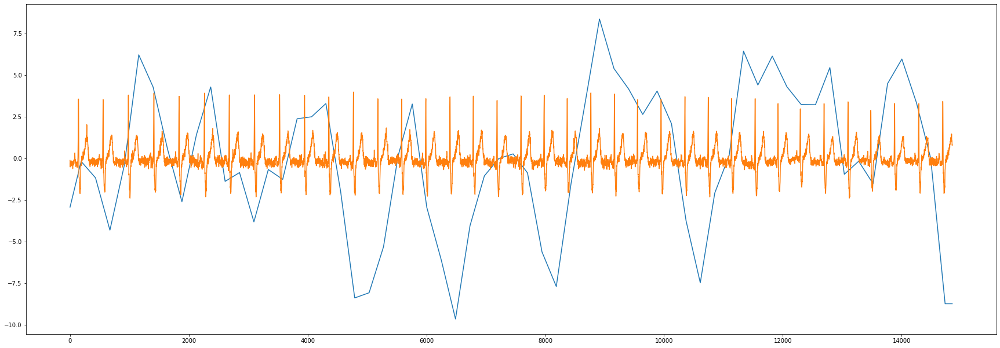

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


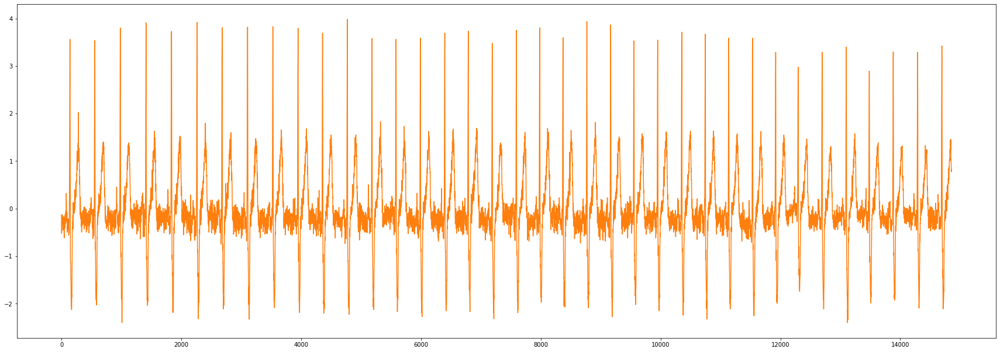

A5799.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


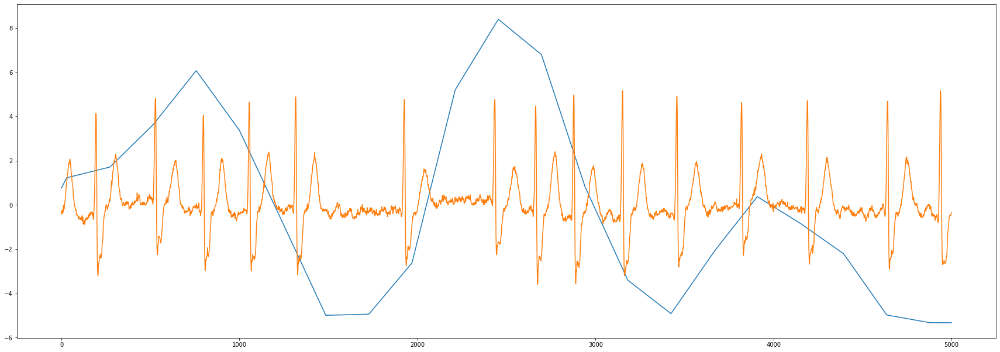

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


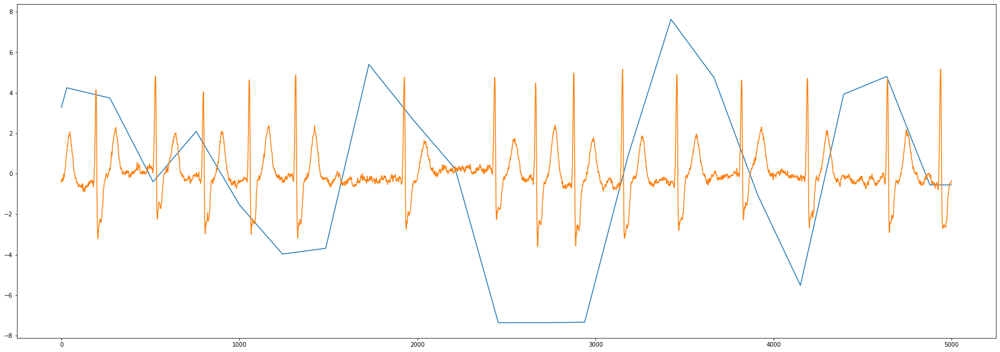

A5760.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


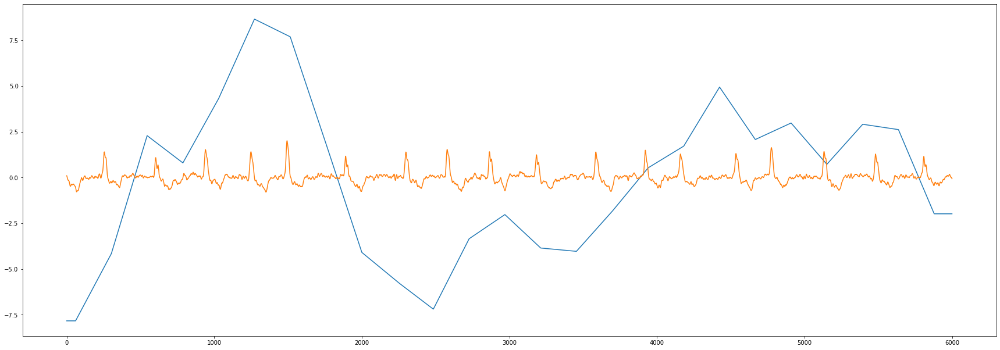

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


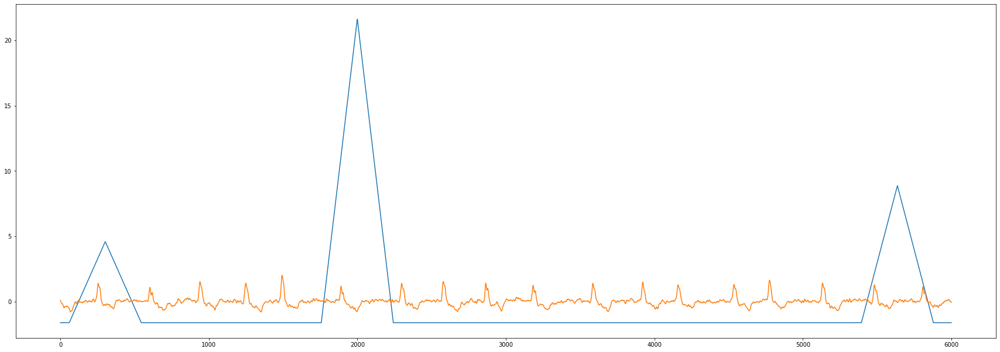

A4652.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


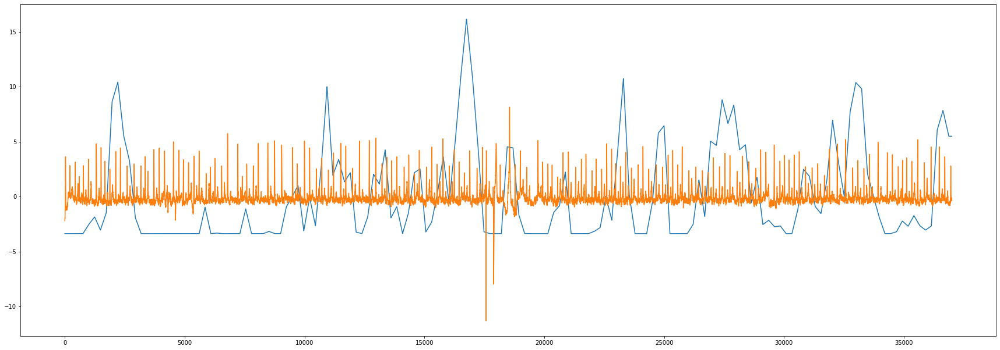

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


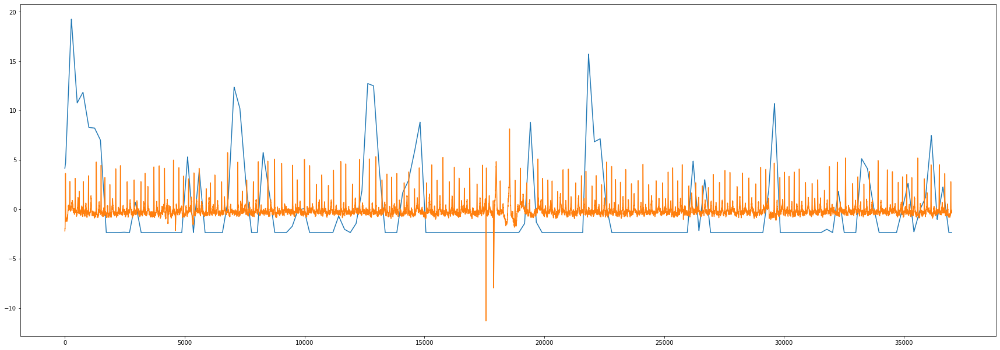

A3761.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


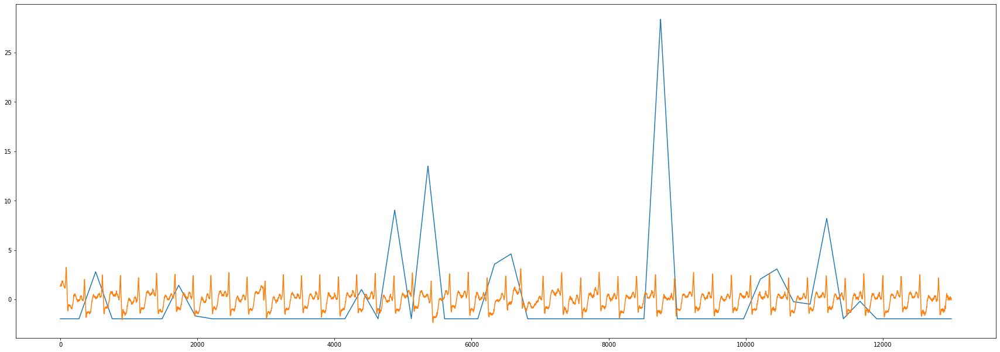

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


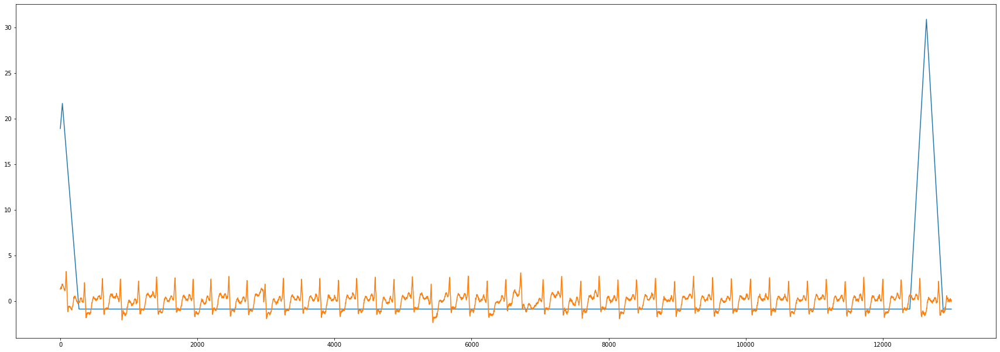

A3299.hea
1
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


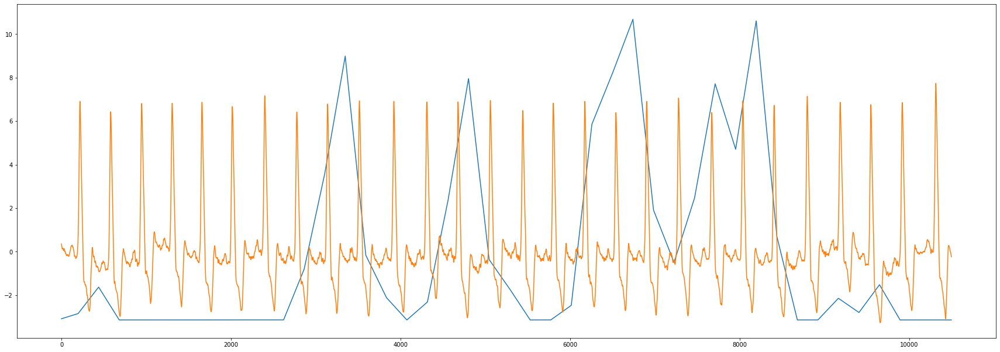

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


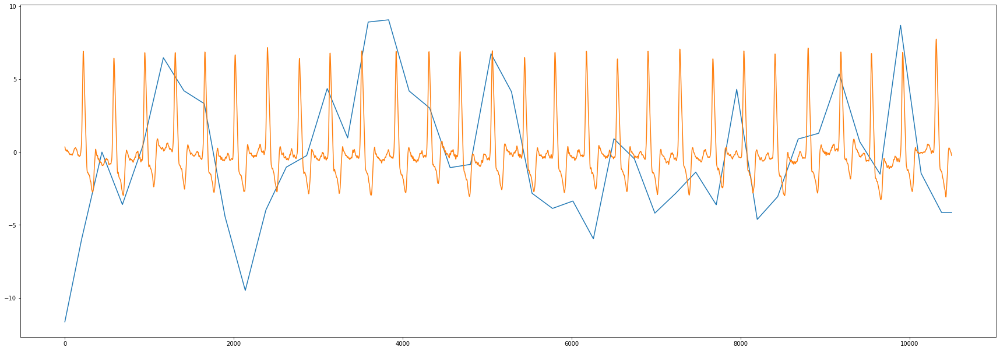

A4178.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


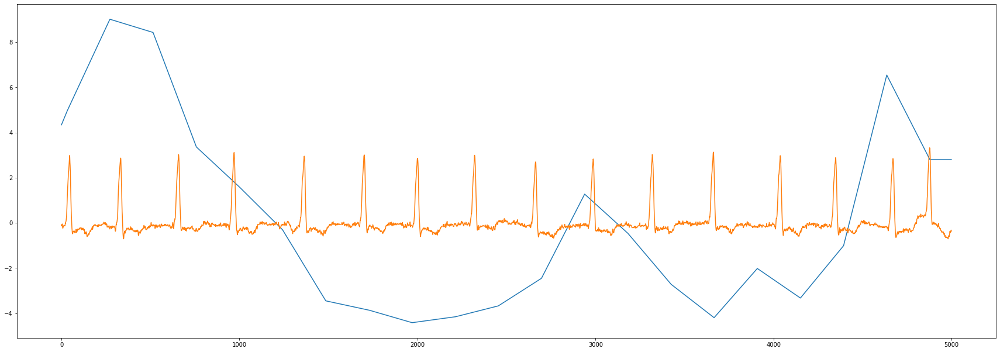

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


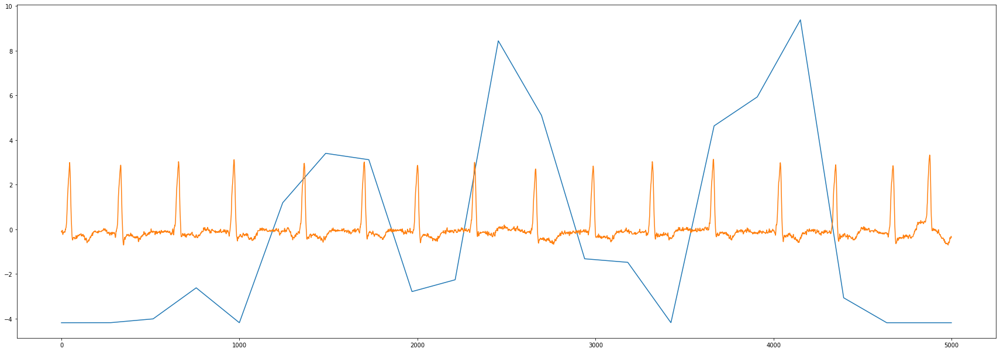

A3205.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


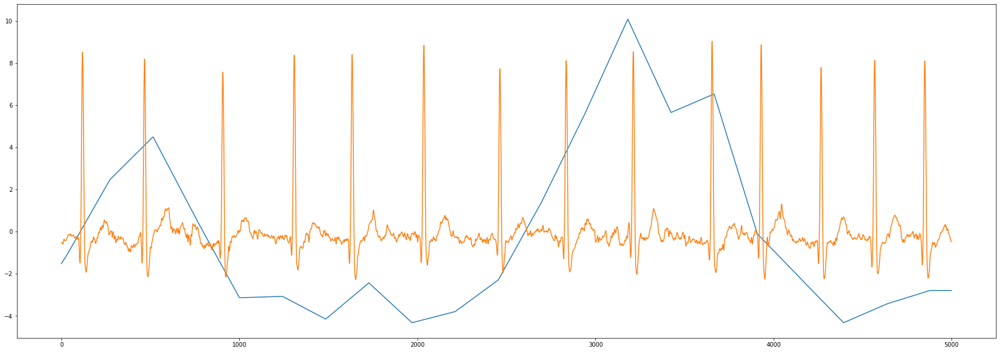

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


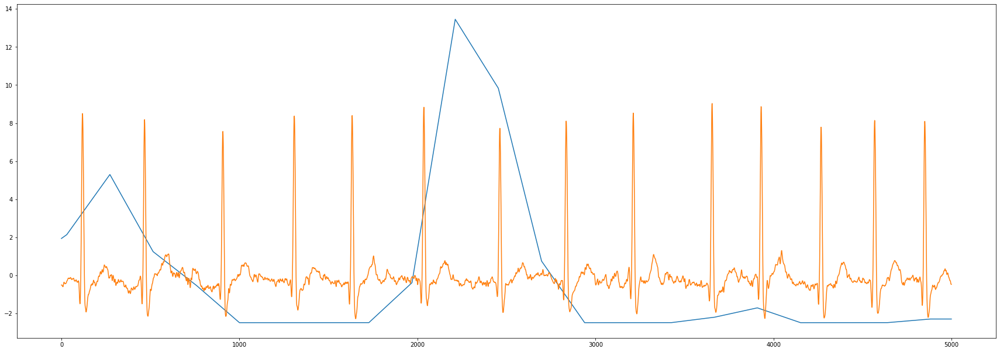

A5489.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


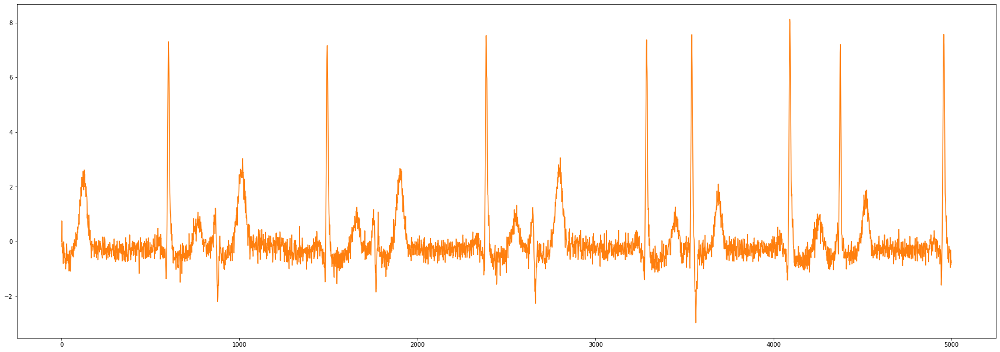

5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


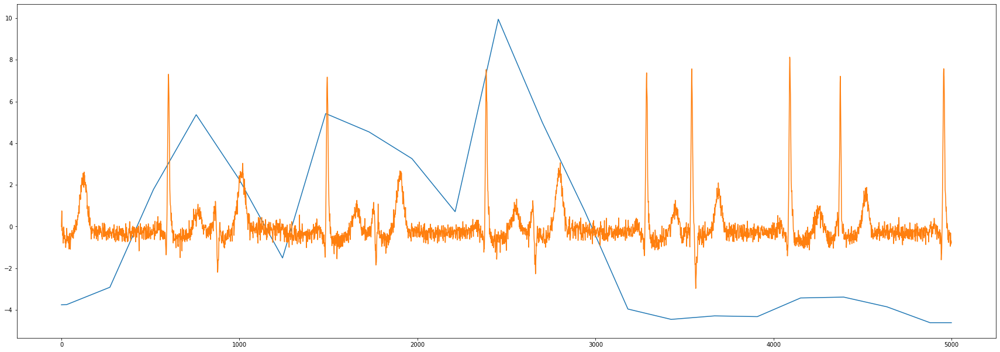

A4344.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


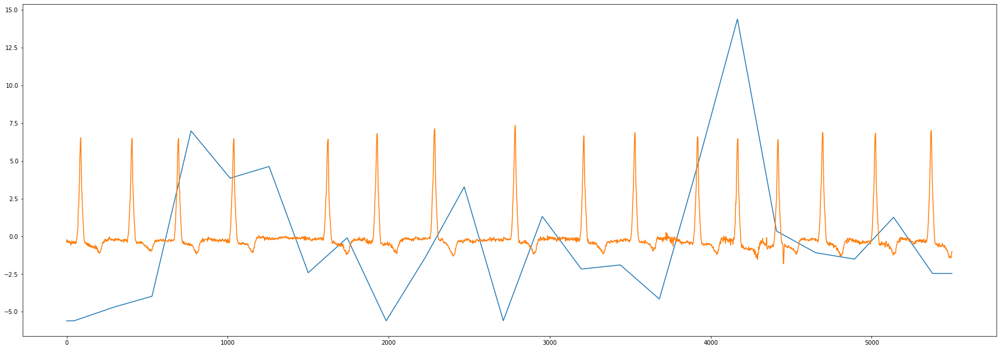

2
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


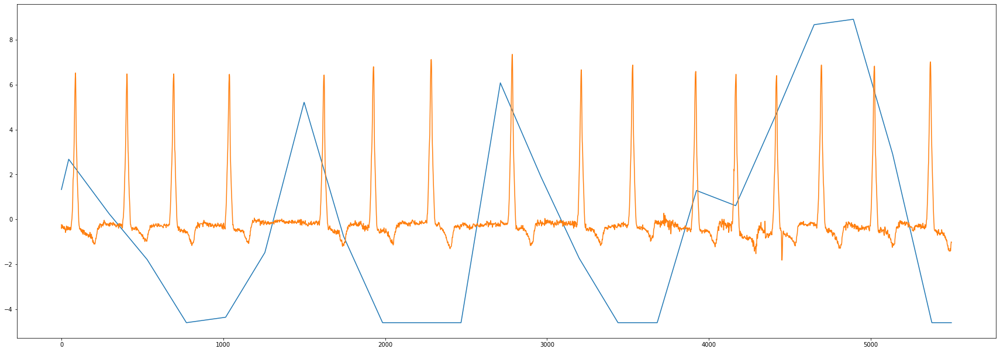

A5190.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


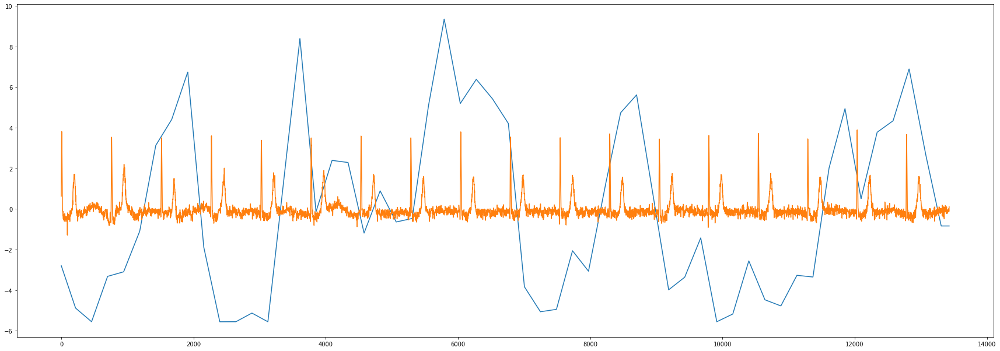

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


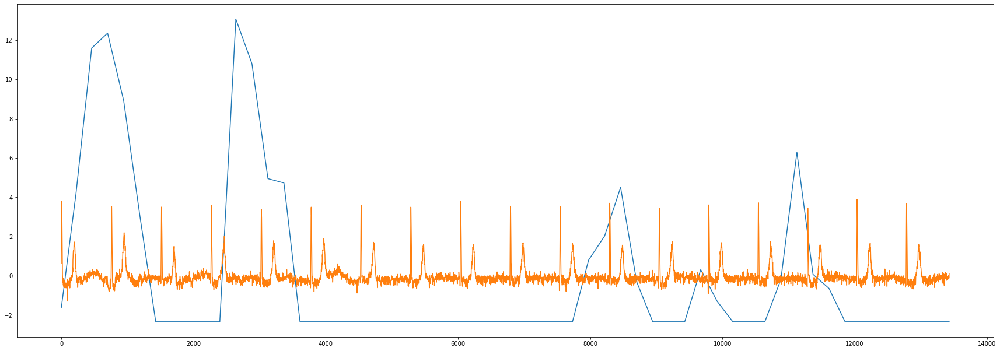

A5715.hea
6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


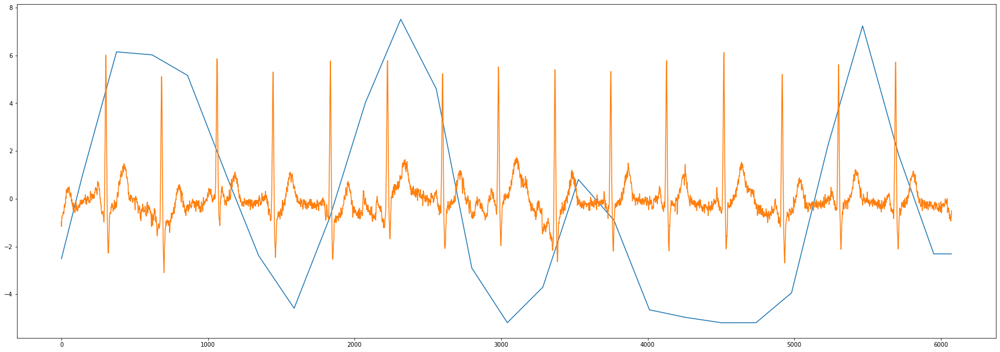

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


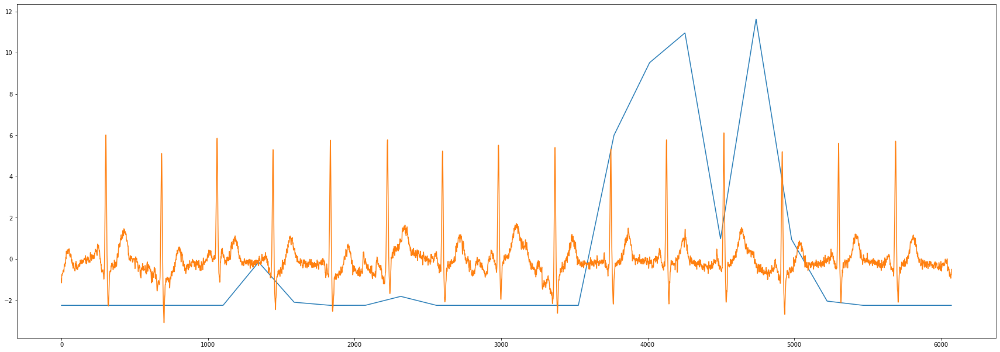

A5145.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


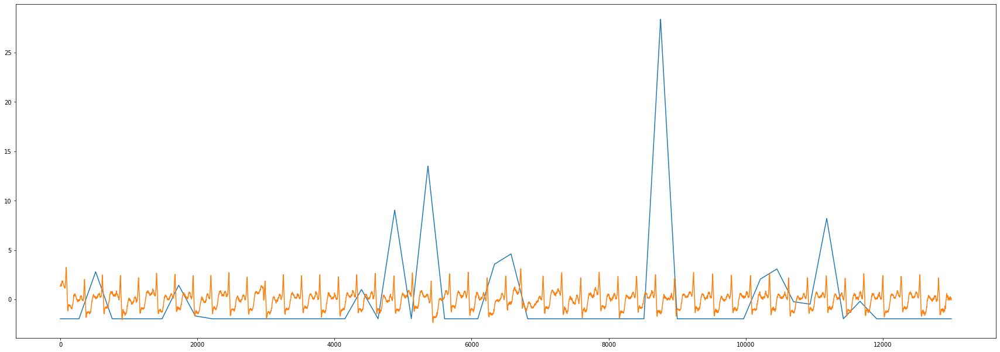

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


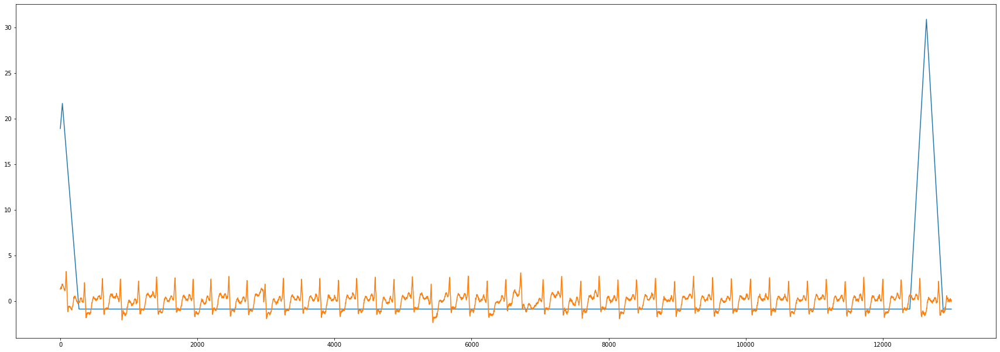

A1678.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


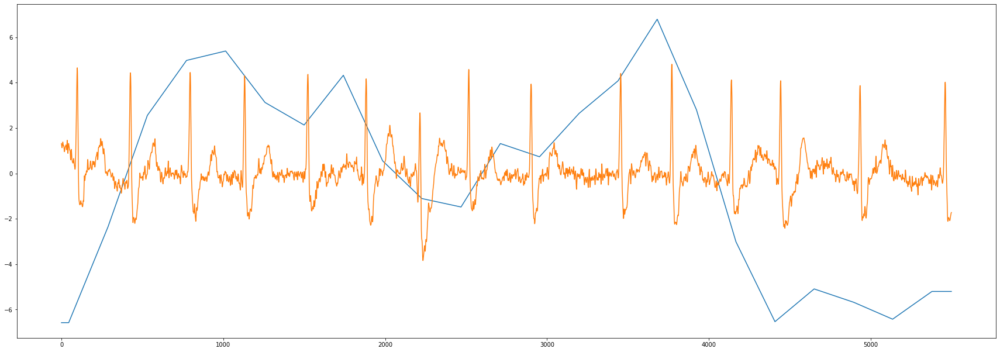

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


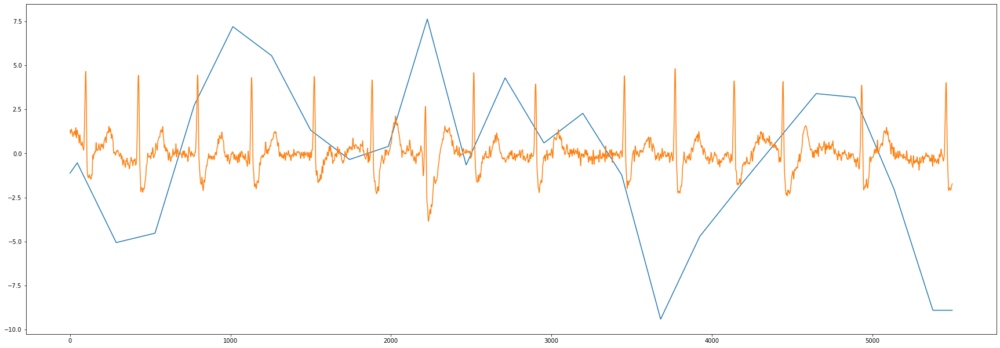

A3209.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


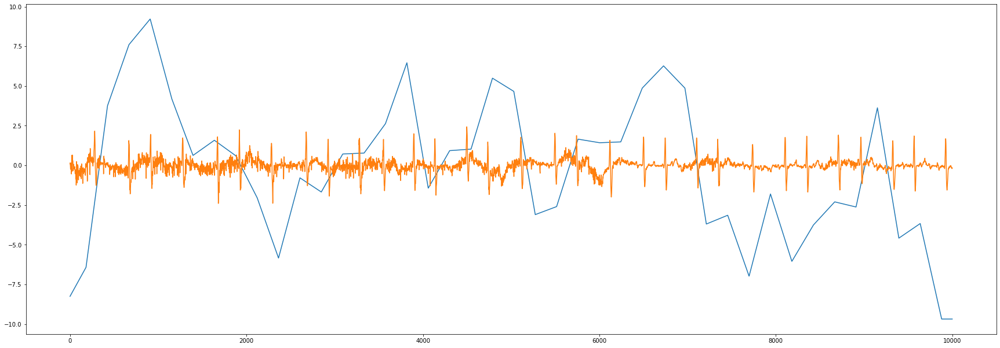

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


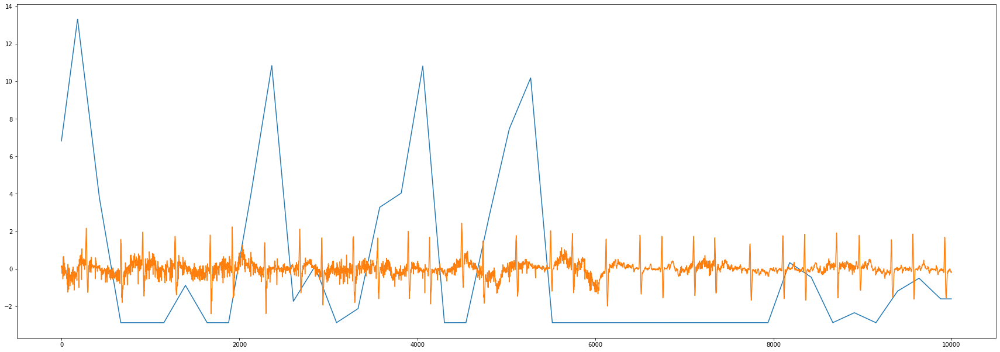

A5775.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


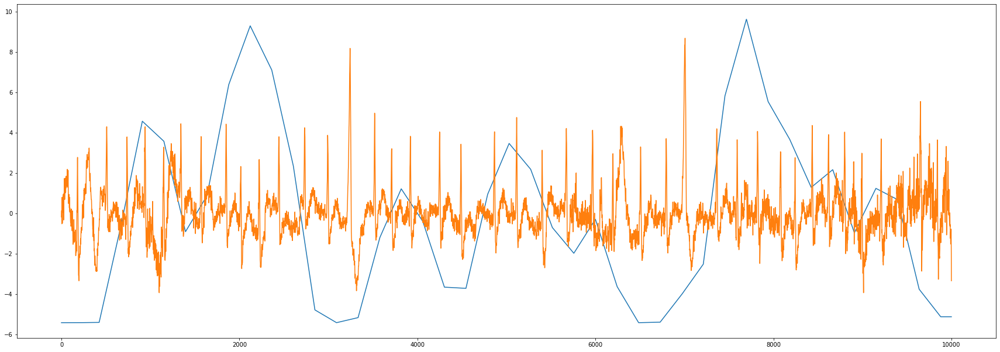

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


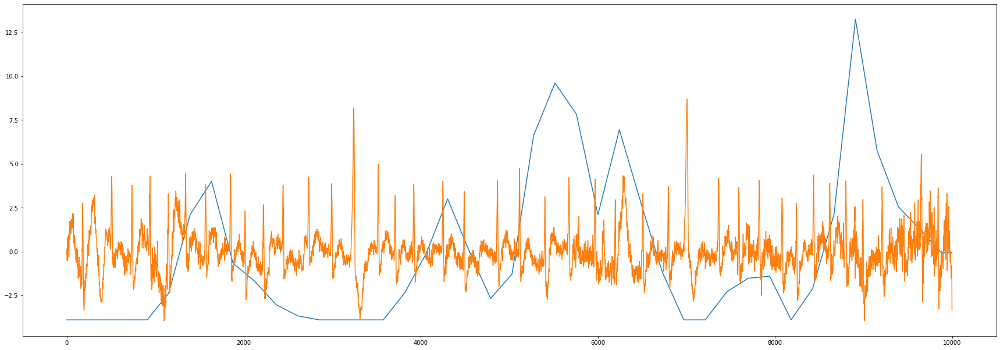

A3330.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


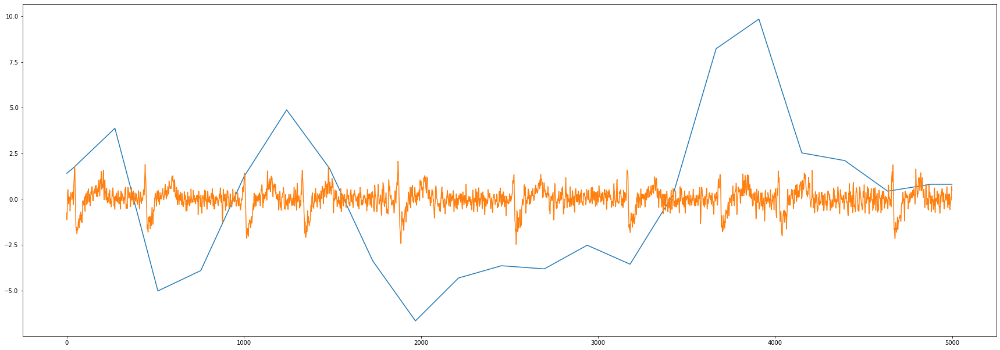

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


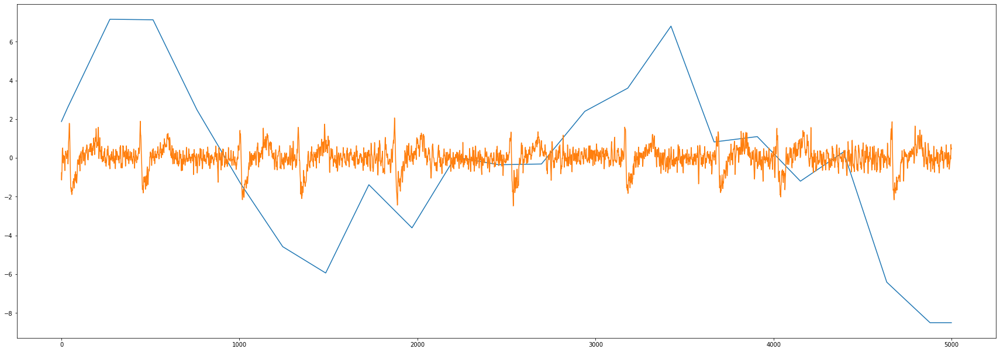

A5810.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


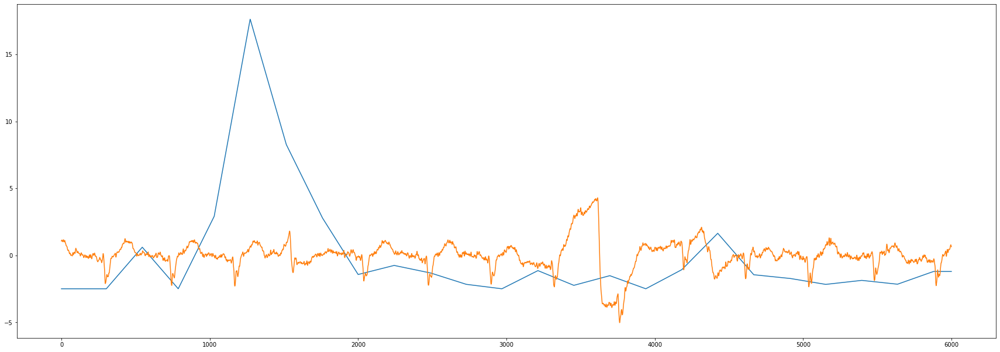

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


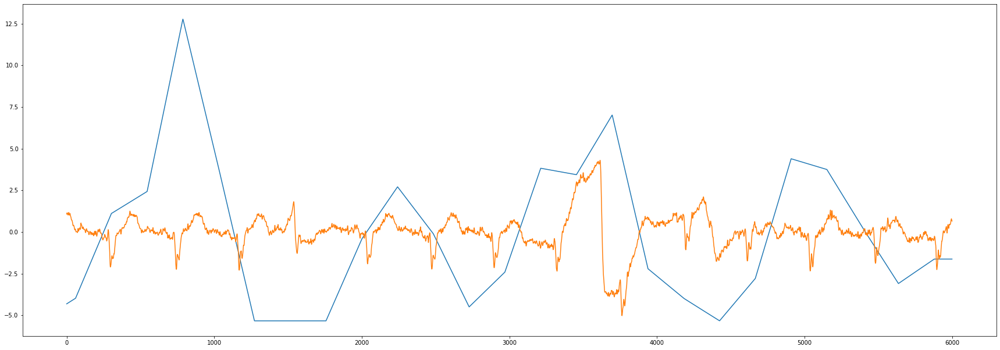

A4873.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


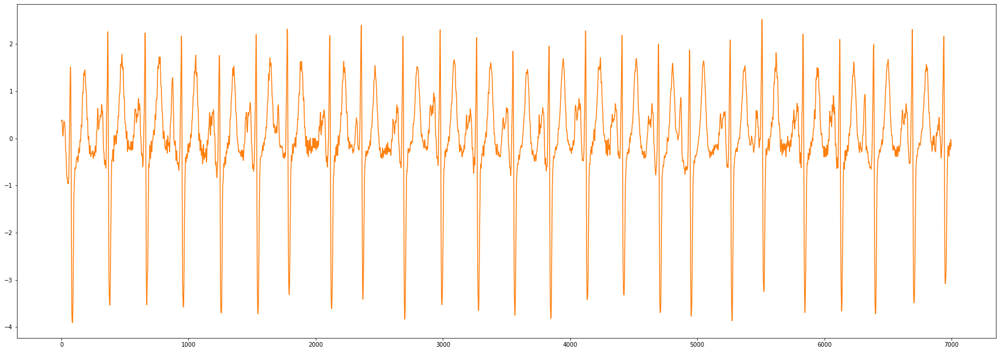

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


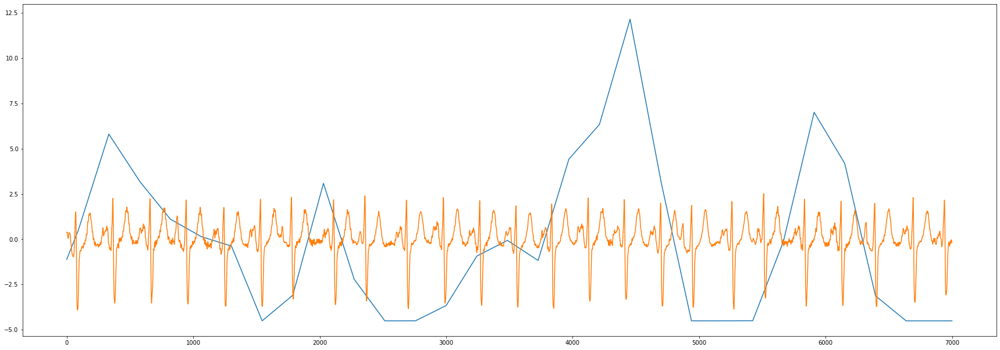

A1003.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


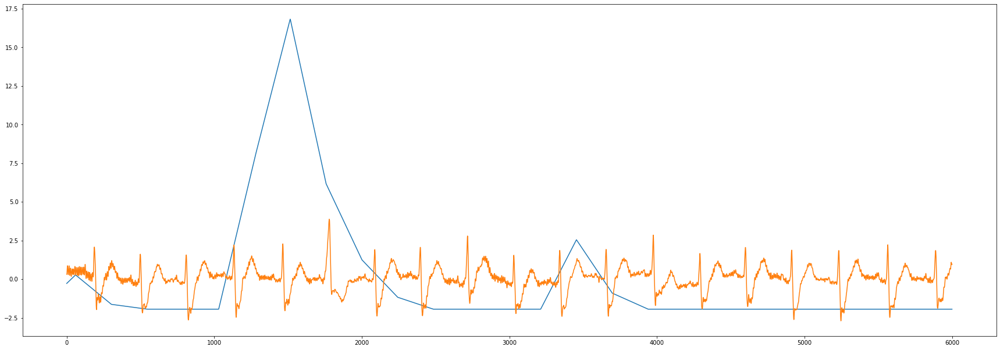

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


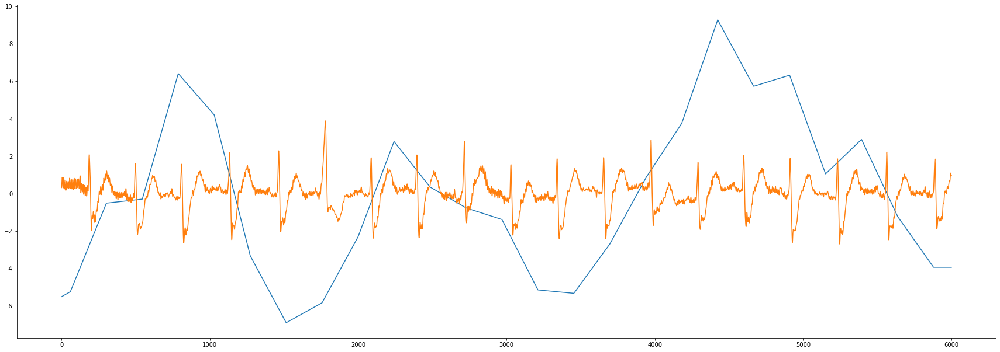

A0374.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


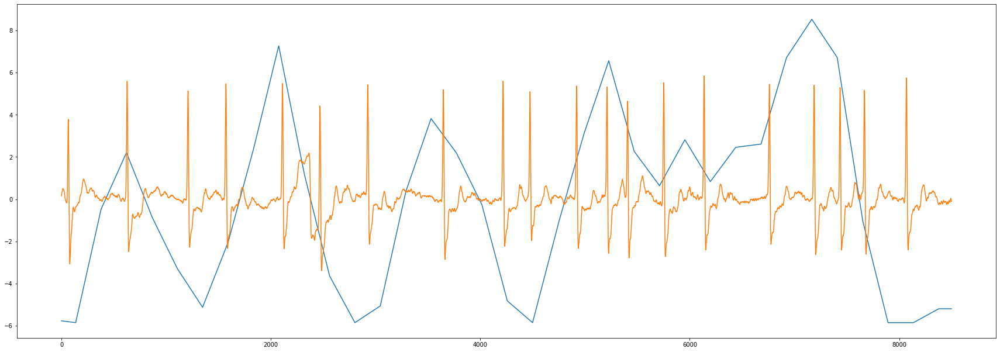

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


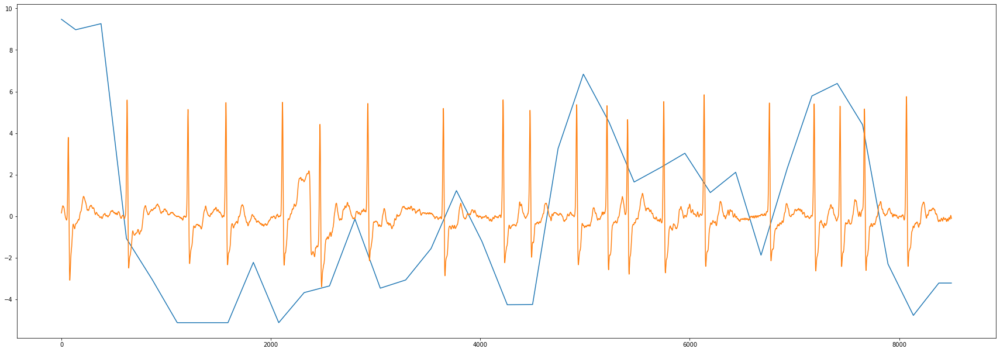

A0834.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


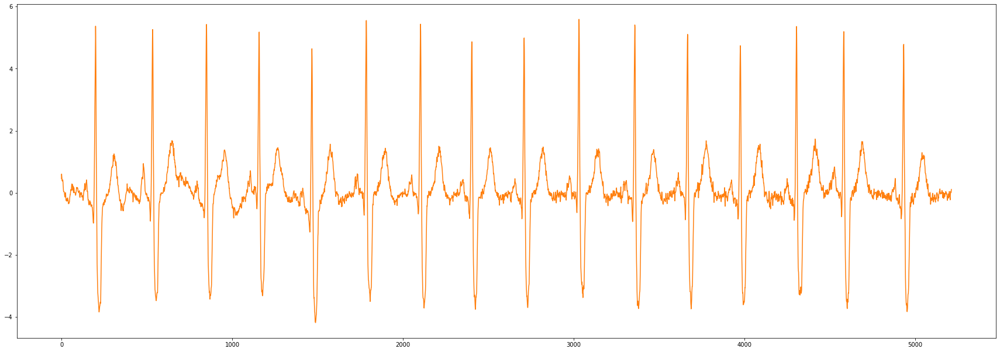

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


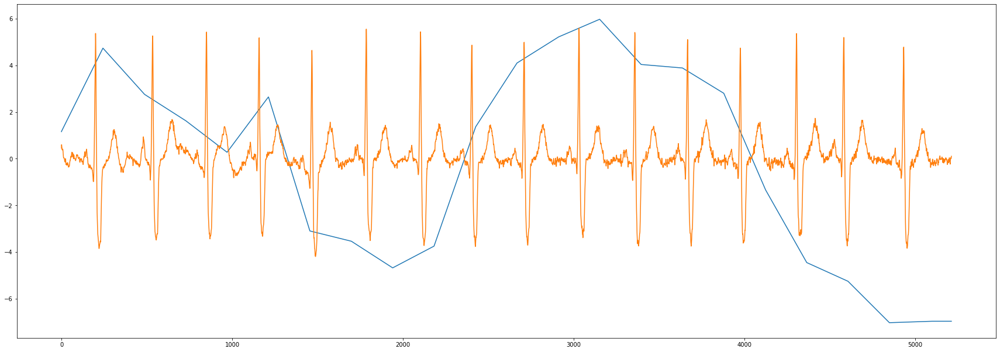

A1539.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


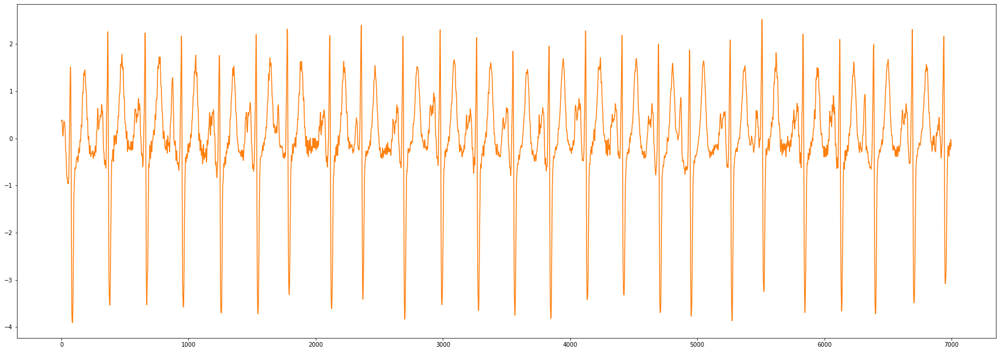

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


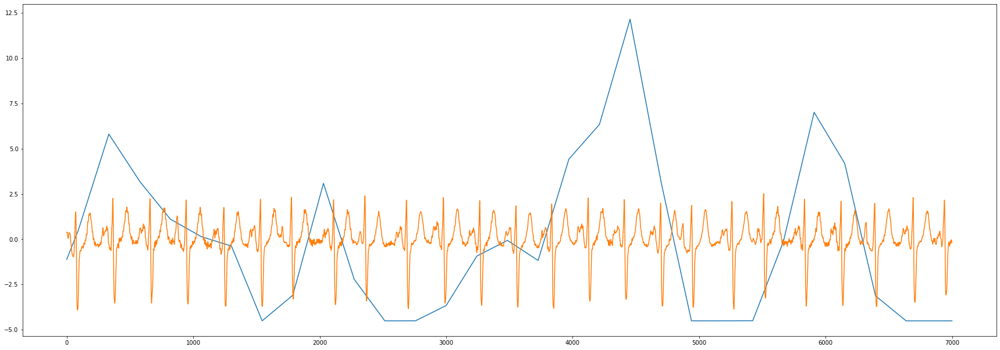

A1666.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


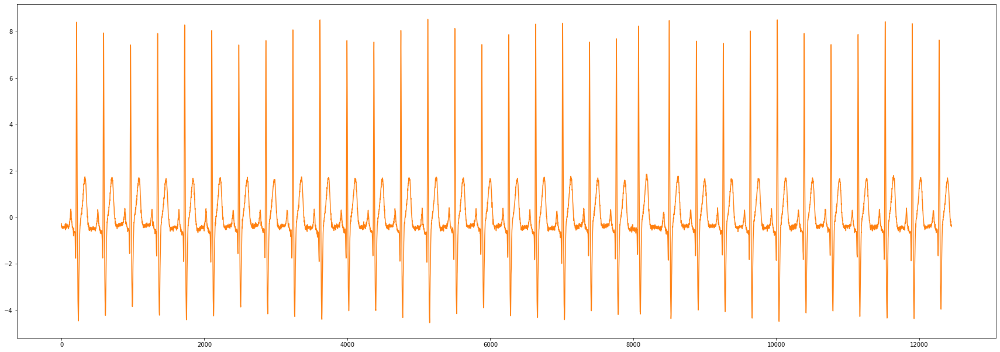

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


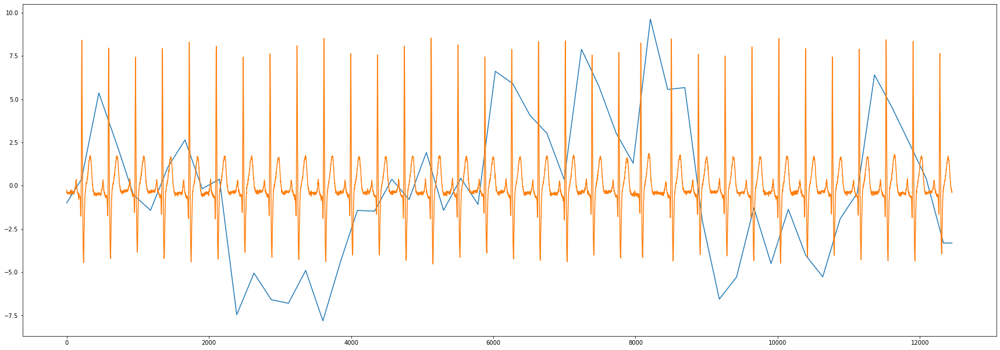

8
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


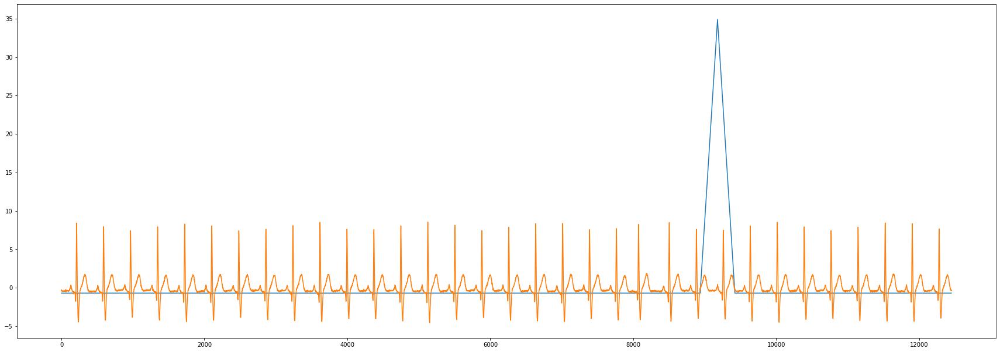

A3264.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


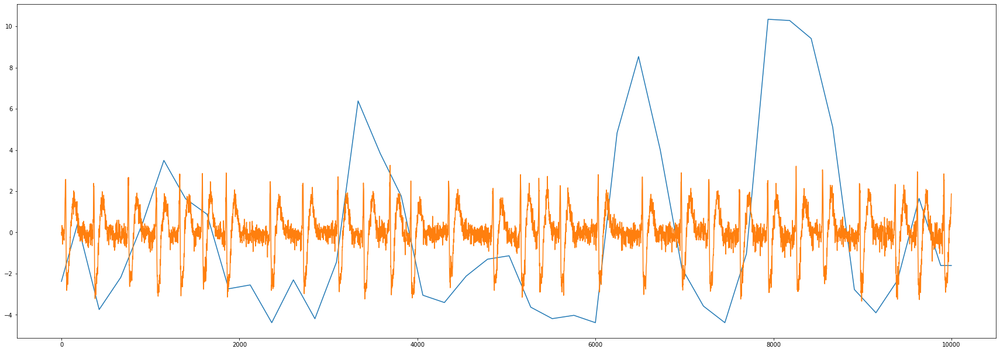

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


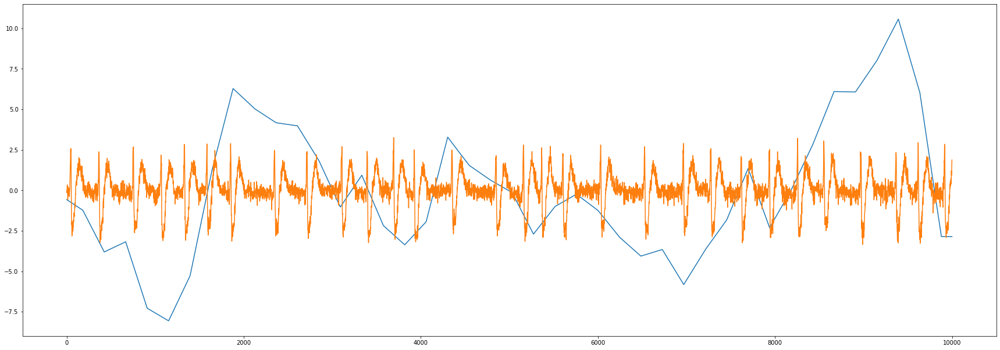

A6474.hea
5
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


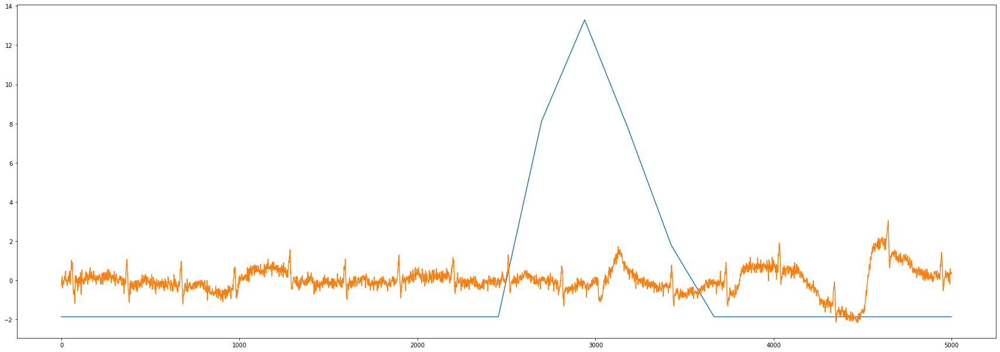

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


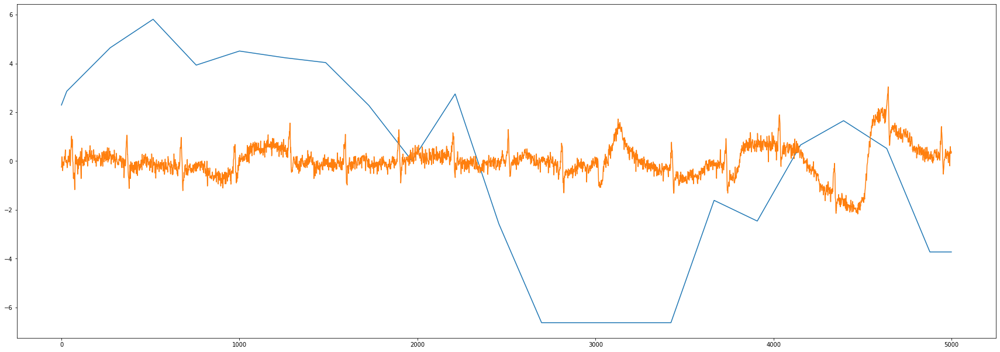

A5684.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


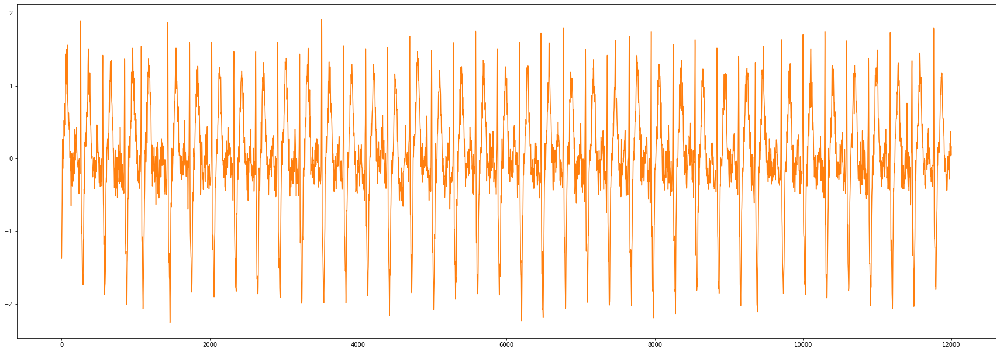

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


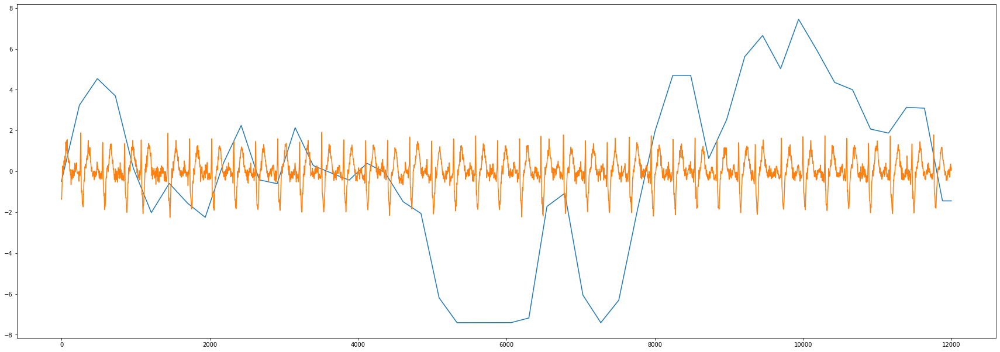

A4271.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


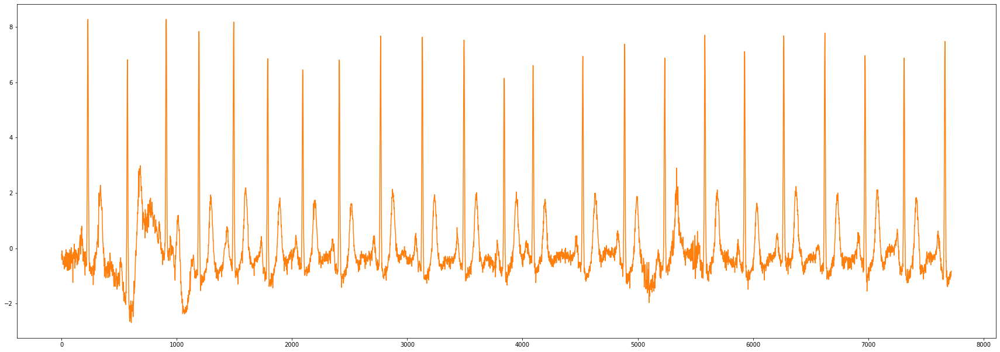

7
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


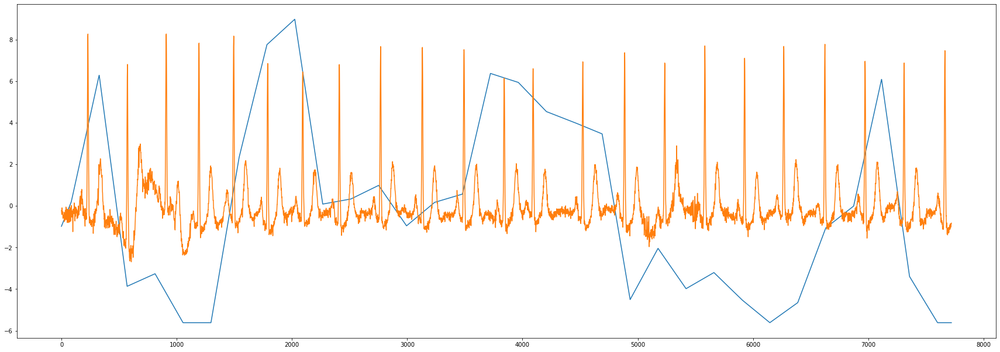

A0593.hea
4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


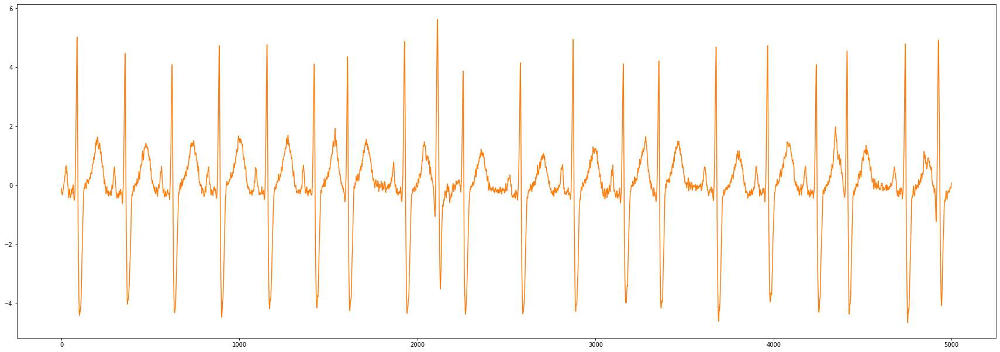

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


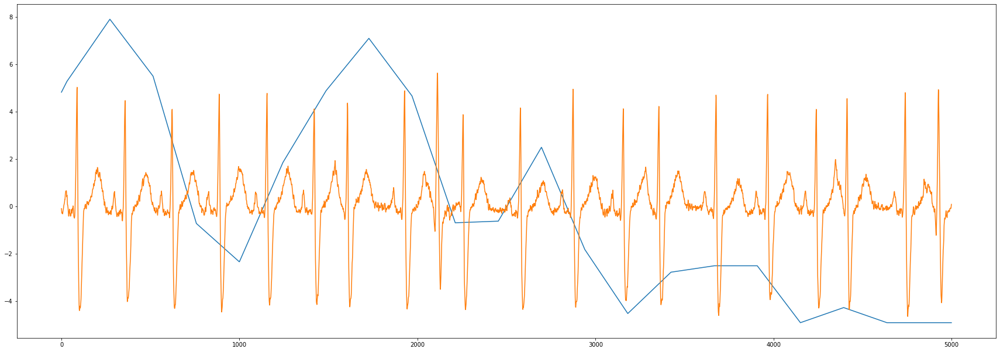

A1061.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


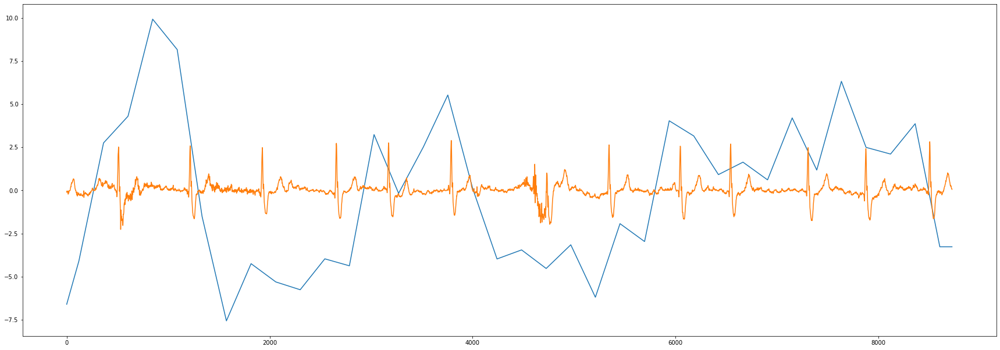

6
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


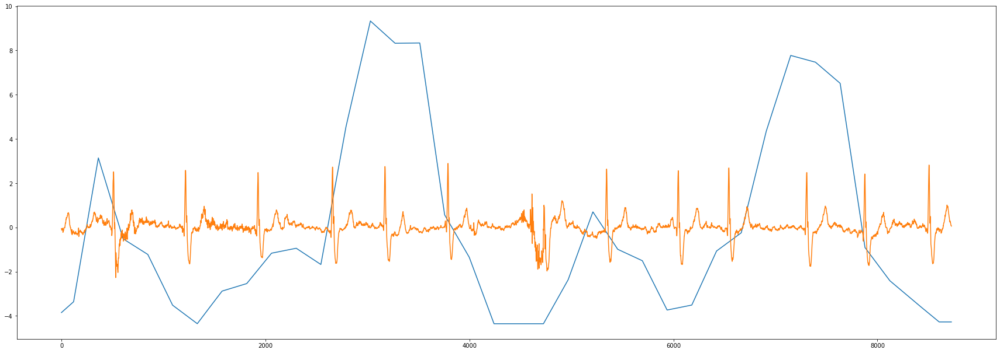

A5412.hea
0
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


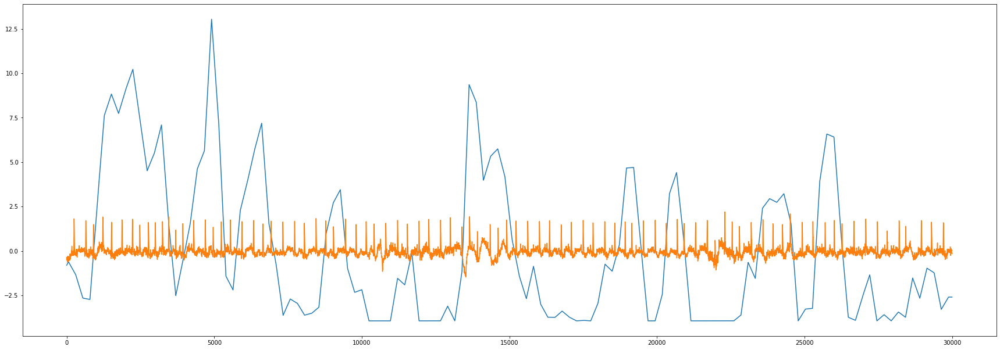

4
{'AF': 0, 'I-AVB': 1, 'LBBB': 2, 'Normal': 3, 'PAC': 4, 'PVC': 5, 'RBBB': 6, 'STD': 7, 'STE': 8}


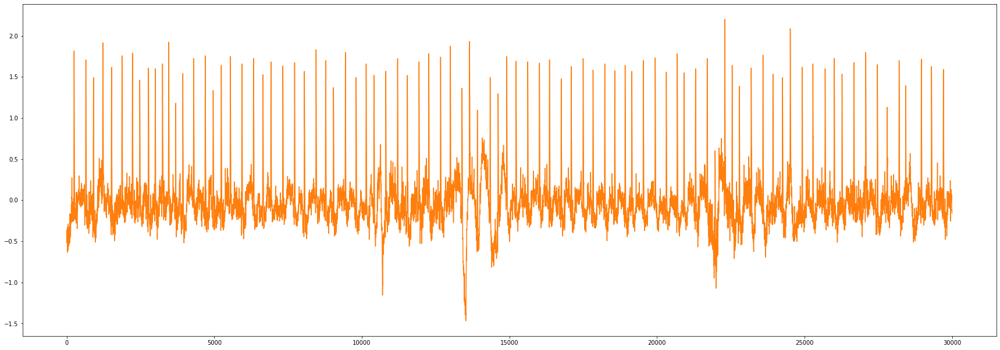

In [13]:
for i, mf in enumerate(multi_test):
#     mf = multi_test[88]
    print(mf)
    curr_classes = get_labels(input_directory, mf, class2index)
    class_index=[]
    [class_index.append(j) for j in range(len(curr_classes)) if curr_classes[j]==1]

    tmp_file_ = np.load(mel_directory + '/' + mf.replace('.hea', '.npy'))



    tmp_file_ -= x_mean_final
    tmp_file_ /= x_std_final

    zero_padding = np.zeros((minimum_len-len(tmp_file_), 12))
    tmp_file = np.concatenate((zero_padding, tmp_file_), axis=0)

#     label = get_labels(input_directory, mf, class2index)

    preprocessed_input = np.expand_dims(tmp_file, axis=0)#np.reshape(preprocessed_input, (1,minimum_len,12))

    att_out, ideal, prediction = get_att_out(preprocessed_input)
#     print(ideal.shape) # (1,297,9)
    #     print(att_out.shape)
    # att_out2 = cv2.resize(att_out[0], (minimum_len, 1))
    for label in class_index:  # multiclass일 경우 대비해서 for문

        att = cv2.resize(ideal[0, :, label], dsize=(1, 72000))
        trimmed = att[72000-len(tmp_file_):,0]

        x_mean = np.mean(trimmed)
        x_std = np.std(trimmed)

        trimmed2 = trimmed - x_mean
        trimmed2 = trimmed2 / x_std

        trimmed3 = trimmed2*4

#         print(mf)
        print(label)
        print(class2index)
        plt.figure(i,figsize=(30, 10.5))
        plt.plot(trimmed3)
        plt.plot(tmp_file_[:,0])
        plt.show()

In [12]:
236600/7

33800.0

In [ ]:
plt.plot(att_out[0])

In [ ]:
aaa.shape

In [ ]:
len(tmp_file_)

In [ ]:
72000-len(tmp_file_)

In [ ]:
trimmed.shape

In [ ]:
trimmed_ = trimmed
Tmax, Tmin = trimmed_.max(), trimmed_.min()
trimmed_ = (trimmed_ -Tmin)/(Tmax-Tmin)


In [ ]:
np.max(trimmed2)

In [ ]:
np.min(trimmed2)

In [ ]:
label

In [ ]:
class2index

In [ ]:
import pandas as pd
import seaborn as sns
cmap = plt.get_cmap('plasma')


In [ ]:
df = pd.DataFrame([tmp_file_[0,:], trimmed_])
df = df.transpose()
sns.scatterplot(x=range(5000),y=0,hue=1, marker='.',palette=cmap,data=df, legend=None)

In [ ]:
trimmed2 = aaa[60000:,0]

In [ ]:
plt.plot(trimmed2)

In [ ]:
cv2.imshow("src",aaa)

In [ ]:
att_out[0].shape

In [ ]:
aaa = np.resize(att_out[0], (72000,1))
plt.plot(aaa)

In [ ]:
plt.pcolor(aaa)

In [ ]:
plt.pcolor(np.transpose(aaa))

In [ ]:
aaa.shape

In [ ]:
aaa

In [ ]:
np.reshape(att_out[0], (297*2,1))

In [ ]:
b = np.copy(att_out[0])
b = cv2.resize(b,(72000,1))

In [ ]:
dot = b * np.transpose(tmp_file)

In [ ]:
plt.pcolor(np.reshape(dot[:,0], (1,minimum_len)))

In [ ]:
b

In [ ]:
plt.plot(b)

In [ ]:
tmp_file.shape

In [ ]:
plt.plot(tmp_file)

In [ ]:
a = np.resize(att_out, (minimum_len, 1))

In [ ]:
a.shape

In [ ]:
plt.plot(a)

In [ ]:
plt.plot(range(minimum_len), a[0])

In [ ]:
att_out

In [ ]:
plt.plot(tmp_file[:,0])

In [ ]:
    
plt.plot(att_out)
plt.plot(tmp_file[:,0])
plt.show()

In [ ]:
import cv2
for i, mf in enumerate(multi_test): 
    tmp_file = np.load(mel_directory + '/' + mf.replace('.hea', '.npy'))



    tmp_file -= x_mean_final
    tmp_file /= x_std_final
    
    zero_padding = np.zeros((minimum_len-len(tmp_file), 12))
    tmp_file = np.concatenate((zero_padding, tmp_file), axis=0)

    label = get_labels(input_directory, mf, class2index)

    preprocessed_input = np.expand_dims(tmp_file, axis=0)#np.reshape(preprocessed_input, (1,minimum_len,12))

    att_out, prediction = get_att_out(preprocessed_input)
#     print(att_out.shape)
    att_out = cv2.resize(att_out[0], (minimum_len, 1))
    
    plt.plot(att_out)
    plt.plot(tmp_file[:,0])
    plt.show()

#     plt.plot(np.reshape(att_out, (297,1)))
#     plt.show()
#     print(get_labels(input_directory, mf, class2index))

In [ ]:
def get_labels(input_directory,file, class2index):
    f = file
    g = f.replace('.mat','.hea')
    input_file = os.path.join(input_directory,g)
    with open(input_file,'r') as f:
        for lines in f:
            if lines.startswith('#Dx'):
                tmp = lines.split(': ')[1].split(',')
                one_hot_vector = [0]*(len(class2index))
                for c in tmp:
                    one_hot_vector = one_hot_encoding(one_hot_vector, c.strip(), class2index)
                
    return one_hot_vector
